# Part I - (Exploration of the Loans Dataset from Prosper)
## by (Salih Alborno)


## Introduction

This is the exploratory analysis of loans data set as part of the Udacity Data Analysis Nano Degree programme.

## The Data Set

This data set contains 113,937 loans with 81 variables on each loan, including loan amount, borrower rate (or interest rate), current loan status, borrower income, EstimatedReturn, EffectiveYield, and many others.

What factors affect a loan’s outcome status?

What affects the borrower’s APR or interest rate?

What determines profits and returns on investment for lenders?

Are there differences between loans depending on how large the original loan amount was?


## Preliminary Wrangling

In [2]:
# import all packages and set plots to be embedded inline.
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

%matplotlib inline


In [2]:
# Print version numbers of packages used in this analysis for reproducability purposes.

#  pandas: 1.1.5 
#  numpy: 1.22.1 
#  matplotlib: 3.4.2 
#  seaborn: 0.11.2 
#  python: 3.8.5

import matplotlib as mplt
import platform

print('\n',
      'pandas:', pd.__version__, '\n',
      'numpy:', np.__version__ , '\n',
      'matplotlib:', mplt.__version__, '\n',
      'seaborn:', sns.__version__, '\n',
      'python:', platform.python_version())



 pandas: 1.1.5 
 numpy: 1.22.1 
 matplotlib: 3.4.2 
 seaborn: 0.11.2 
 python: 3.8.5


In [3]:

sns.set_style("whitegrid", {'axes.grid' : False})
sns.set_style("ticks")
sns.set(font_scale=1.2, style="whitegrid")
sns.set_theme() # rests to default

get_ipython().ast_node_interactivity = 'all'


In [4]:
# Read csv file into a pandas dataframe.

dfc = pd.read_csv('./uda_data/prosperLoanData.csv')


In [5]:
# lets view a sample of the data to get a sense of what analysis to carry out.

dfc.head(5)


,ListingKey,ListingNumber,ListingCreationDate,CreditGrade,Term,LoanStatus,ClosedDate,BorrowerAPR,BorrowerRate,LenderYield,...,LP_ServiceFees,LP_CollectionFees,LP_GrossPrincipalLoss,LP_NetPrincipalLoss,LP_NonPrincipalRecoverypayments,PercentFunded,Recommendations,InvestmentFromFriendsCount,InvestmentFromFriendsAmount,Investors
0,1021339766868145413AB3B,193129,2007-08-26 19:09:29.263000000,C,36,Completed,2009-08-14 00:00:00,0.16516,0.1580,0.1380,...,-133.18,0.0,0.0,0.0,0.0,1.0,0,0,0.0,258
1,10273602499503308B223C1,1209647,2014-02-27 08:28:07.900000000,NaN,36,Current,NaN,0.12016,0.0920,0.0820,...,0.00,0.0,0.0,0.0,0.0,1.0,0,0,0.0,1
2,0EE9337825851032864889A,81716,2007-01-05 15:00:47.090000000,HR,36,Completed,2009-12-17 00:00:00,0.28269,0.2750,0.2400,...,-24.20,0.0,0.0,0.0,0.0,1.0,0,0,0.0,41
3,0EF5356002482715299901A,658116,2012-10-22 11:02:35.010000000,NaN,36,Current,NaN,0.12528,0.0974,0.0874,...,-108.01,0.0,0.0,0.0,0.0,1.0,0,0,0.0,158
4,0F023589499656230C5E3E2,909464,2013-09-14 18:38:39.097000000,NaN,36,Current,NaN,0.24614,0.2085,0.1985,...,-60.27,0.0,0.0,0.0,0.0,1.0,0,0,0.0,20


In [5]:
# lets review all the columns names in the dataframe and their data types.

dfc.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 113937 entries, 0 to 113936
Data columns (total 81 columns):
 #   Column                               Non-Null Count   Dtype  
---  ------                               --------------   -----  
 0   ListingKey                           113937 non-null  object 
 1   ListingNumber                        113937 non-null  int64  
 2   ListingCreationDate                  113937 non-null  object 
 3   CreditGrade                          28953 non-null   object 
 4   Term                                 113937 non-null  int64  
 5   LoanStatus                           113937 non-null  object 
 6   ClosedDate                           55089 non-null   object 
 7   BorrowerAPR                          113912 non-null  float64
 8   BorrowerRate                         113937 non-null  float64
 9   LenderYield                          113937 non-null  float64
 10  EstimatedEffectiveYield              84853 non-null   float64
 11  EstimatedLoss

In [6]:
# let's review the dataframe shape (number of columns and number of rows).

dfc.shape


(113937, 81)

In [7]:
# are there NA values present in the dataset?
# Yes, there is. But to view this better we need to isoloate the NaN columns out

nans = dfc.isna().sum()
nans/dfc.shape[0]


ListingKey                     0.000000
ListingNumber                  0.000000
ListingCreationDate            0.000000
CreditGrade                    0.745886
Term                           0.000000
                                 ...   
PercentFunded                  0.000000
Recommendations                0.000000
InvestmentFromFriendsCount     0.000000
InvestmentFromFriendsAmount    0.000000
Investors                      0.000000
Length: 81, dtype: float64

In [12]:
# let's find the the number of NaNs for each column where there is NaN 

dfc[dfc.columns[dfc.isna().any()]].isna().sum()


CreditGrade                             84984
ClosedDate                              58848
BorrowerAPR                                25
EstimatedEffectiveYield                 29084
EstimatedLoss                           29084
EstimatedReturn                         29084
ProsperRating (numeric)                 29084
ProsperRating (Alpha)                   29084
ProsperScore                            29084
BorrowerState                            5515
Occupation                               3588
EmploymentStatus                         2255
EmploymentStatusDuration                 7625
GroupKey                               100596
CreditScoreRangeLower                     591
CreditScoreRangeUpper                     591
FirstRecordedCreditLine                   697
CurrentCreditLines                       7604
OpenCreditLines                          7604
TotalCreditLinespast7years                697
InquiriesLast6Months                      697
TotalInquiries                    

In [5]:
# let's calculate the NaNs percentage for columns with NaN is present

dfc[dfc.columns[dfc.isna().any()]].isna().sum() * 100 / dfc.shape[0]


CreditGrade                            74.588588
ClosedDate                             51.649596
BorrowerAPR                             0.021942
EstimatedEffectiveYield                25.526387
EstimatedLoss                          25.526387
EstimatedReturn                        25.526387
ProsperRating (numeric)                25.526387
ProsperRating (Alpha)                  25.526387
ProsperScore                           25.526387
BorrowerState                           4.840394
Occupation                              3.149109
EmploymentStatus                        1.979164
EmploymentStatusDuration                6.692295
GroupKey                               88.290898
CreditScoreRangeLower                   0.518708
CreditScoreRangeUpper                   0.518708
FirstRecordedCreditLine                 0.611742
CurrentCreditLines                      6.673864
OpenCreditLines                         6.673864
TotalCreditLinespast7years              0.611742
InquiriesLast6Months

In [8]:
# these are the columns with more than 20% NaNs

(nans/dfc.shape[0]).where(lambda x : x>0.20).dropna()


CreditGrade                            0.745886
ClosedDate                             0.516496
EstimatedEffectiveYield                0.255264
EstimatedLoss                          0.255264
EstimatedReturn                        0.255264
ProsperRating (numeric)                0.255264
ProsperRating (Alpha)                  0.255264
ProsperScore                           0.255264
GroupKey                               0.882909
TotalProsperLoans                      0.806165
TotalProsperPaymentsBilled             0.806165
OnTimeProsperPayments                  0.806165
ProsperPaymentsLessThanOneMonthLate    0.806165
ProsperPaymentsOneMonthPlusLate        0.806165
ProsperPrincipalBorrowed               0.806165
ProsperPrincipalOutstanding            0.806165
ScorexChangeAtTimeOfListing            0.833873
LoanFirstDefaultedCycleNumber          0.851216
dtype: float64

### NaNs presence justifications and treatment approach

Inspecting the variable definitions Excel sheet, One can explain the very high NaNs present in some of the columns:
    
1- these variables are populated for post Jul 2009

EstimatedEffectiveYield                25.526387

EstimatedLoss                          25.526387

EstimatedReturn                        25.526387

ProsperRating (numeric)                25.526387

ProsperRating (Alpha)                  25.526387

ProsperScore                           25.526387

2- These variables are populated for pre Jul 2009

CreditGrade                            74.588588

3- GroupKey is assigned if member of group otheriwse null

GroupKey                               88.290898

4- Closed date is applicable for Cancelled, Completed, Chargedoff and Defaulted loan statuses. 

ClosedDate                             51.649596

5- These variables values will be null if the borrower had no prior loans.

TotalProsperLoans                      80.616481

TotalProsperPaymentsBilled             80.616481

OnTimeProsperPayments                  80.616481

ProsperPaymentsLessThanOneMonthLate    80.616481

ProsperPaymentsOneMonthPlusLate        80.616481

ProsperPrincipalBorrowed               80.616481

ProsperPrincipalOutstanding            80.616481

ScorexChangeAtTimeOfListing            83.387311

6- This variable captures the cycle the loan was charged off. If the loan has not charged off the value will be null.

LoanFirstDefaultedCycleNumber          85.121602

The above high NaN's columns indicate that for some varaible analysis we will need to do pre or post slicing of data in comparisons to ensure statistical findings are not skewed incorrenctly by comparing two different datasets.

7- The small percentage NaNs columns indicate the absense of some data about some individuals. Those are find and will be further examined or filtered during those variables analysis.

### What is the structure of your dataset?

The dataset is 113937 rows by 81 variables. 

There are null values present in the dataset. High NaNs present for some columns were found to be justified and mainly centered around the split of data between pre/post 2009 as explained above. The analysis will have to address data points pre and post 2009 separatly.

Where is small NaN percentages present (less than 7%) we will either omit those during the analysis of these variables or apply any other required treatment to these variables during the exploration phase.

### What is/are the main feature(s) of interest in your dataset?

Features of interest can vary according to the purpose of the analysis. For example we can choose any of these as key features interest:

    1- LenderYield, and EstimatedReturn: If the purpose is investigating Lenders Yield and understanding factors that impact it.
    
    2- BorrowerAPR, BorrowerRate: If the purpose is investigating borrowers interest rate and what impacts it.
    
    3- MonthlyLoanPayment: If the purpose is investigating the monthly payment amount and which variables impact its values.

    4- LoanOriginalAmount: If the purpose of analysis to investigate the amounts of loan seeked/offered and improve service offering for different loan demand.

    5- TotalInquiries: If the purpsoe of the analysis to investigate level of inquiries, and potential options to decrease these inquiries in effort to digitise services and reduce cost.

   **For this analysis, we will take LenderYield, EstimatedReturn, EstimatedLoss, and EstimatedEffectiveYield as our key features of interest for the purpose of this analysis. It would be intereting to understand how those metrics are affected by some of the dimensions in the dataset e.g. credit score/ credit rating, having a house or not, having a job or not, income levels ... etc and what are the main drivers behind Returns levels from those loans**.
    
### What features in the dataset do you think will help support your investigation into your feature(s) of interest?

These are the feature that I think can be used to support my analysis and used for slicing, dicing, and segmenting the data:

LoanStatus, ListingCategory, Term, Recommendations, LenderYield, EstimatedReturn, CreditScoreRangeLower, CreditScoreRangeUpper, EmploymentStatus, ProsperRating, ProsperScore, IsBorrowerHomeowner, CurrentDelinquencies, DelinquenciesLast7Years, TradesOpenedLast6Months, DebtToIncomeRatio, IncomeRange, IncomeVerifiable.

## Univariate Exploration

> In this section, investigate distributions of individual variables. If
you see unusual points or outliers, take a deeper look to clean things up
and prepare yourself to look at relationships between variables.


> **Rubric Tip**: The project (Parts I alone) should have at least 15 visualizations distributed over univariate, bivariate, and multivariate plots to explore many relationships in the data set.  Use reasoning to justify the flow of the exploration.



>**Rubric Tip**: Use the "Question-Visualization-Observations" framework  throughout the exploration. This framework involves **asking a question from the data, creating a visualization to find answers, and then recording observations after each visualisation.** 


In [6]:
# double check df size:

dfc.shape

(113937, 81)

In [7]:
## Clean ##
##   2   ##

# which are the popular categories loans are taken for?
# lets convert the loan category numbers into their actual names for user friendleness and ease of understanding plots.

cat_dict = {0: 'Not Available', 1: 'Debt Consolidation', 2: 'Home Improvement', 3: 'Business', 
            4: 'Personal Loan', 5: 'Student Use', 6: 'Auto', 7: 'Other', 8: 'Baby&Adoption', 9: 'Boat', 
            10: 'Cosmetic Procedure', 11: 'Engagement Ring', 12: 'Green Loans', 13: 'Household Expenses', 
            14: 'Large Purchases', 15: 'Medical/Dental', 16: 'Motorcycle', 17:'RV', 18:'Taxes', 19:'Vacation', 20: 'Wedding Loans'}

dfc['ListingCategory'] = dfc['ListingCategory (numeric)'].map(cat_dict)


In [8]:
## Clean ##
##   3   ##

# convert date string to date object to work with.
dfc['LoanDate'] = pd.to_datetime(dfc['LoanOriginationDate'].str.split(' ', n=1, expand = True)[0], format='%Y-%m-%d')
dfc['year'] = dfc['LoanDate'].map(lambda x: x.strftime('%Y'))


In [9]:
# are there any NaNs instroduced in the date conversion process? 
# No, all good.

dfc['LoanDate'].isnull().sum(), dfc['LoanDate'].notnull().sum()


(0, 113937)

In [10]:
dfc['year'].value_counts()


2013    34345
2012    19553
2014    12172
2008    11552
2007    11460
2011    11228
2006     5906
2010     5652
2009     2047
2005       22
Name: year, dtype: int64

In [11]:
## Clean ##
##   4   ##

# convert some variables into ordered categorical types so that they appear in a logical order during analysis and when plotting:
def sort_categorical_vars():
    
    ordinal_var_dict = {'LoanStatus': ['Completed', 'Current', 'Defaulted', 'Chargedoff', 'Cancelled', 'FinalPaymentInProgress', 
                                       'Past Due (1-15 days)', 'Past Due (16-30 days)', 'Past Due (31-60 days)', 
                                       'Past Due (61-90 days)', 'Past Due (91-120 days)', 'Past Due (>120 days)'],
                        'CreditGrade': ['AA', 'A', 'B', 'C', 'D', 'E', 'HR', 'NC'],
                        'ProsperRating (Alpha)': ['AA', 'A', 'B', 'C', 'D', 'E', 'HR'],
                        'IncomeRange': ['$0', '$1-24,999', '$25,000-49,999', '$50,000-74,999', '$75,000-99,999', '$100,000+', 'Not employed', 'Not displayed'],
                        'year': ['2006','2007','2008','2009','2010','2011','2012','2013','2014']
                        #'col2': ['J', 'I', 'H', 'G', 'F', 'E', 'D'],
                       }
    
    for var in ordinal_var_dict:
        pd_ver = pd.__version__.split(".")
        if (int(pd_ver[0]) > 0) or (int(pd_ver[1]) >= 21): # v0.21 or later
            ordered_var = pd.api.types.CategoricalDtype(ordered = True,
                                                        categories = ordinal_var_dict[var])
            dfc[var] = dfc[var].astype(ordered_var)
        else: # pre-v0.21
            dfc[var] = dfc[var].astype('category', ordered = True,
                                                 categories = ordinal_var_dict[var])

sort_categorical_vars()


In [62]:
## Clean ##
##   5   ##

# NaNs analysis revealed that we need to treat pre and post Jul 2009 data observations differently.
# let's define a day to cut the dataframe with

from datetime import datetime

# datetime(year, month, day)
d2009Jan = datetime(2009, 1, 1 )
d2009Aug = datetime(2009, 8, 1 )
print(d2009Jan, '<->', d2009Aug)

# add extra categorical column for differentiating the two datasets in the amin dfc
#dfc['period'] = np.select ([dfc['LoanDate'] >= d2009Aug, dfc['LoanDate'] < d2009Jan], ['post-Jul2009', 'pre-Jul2009'])
dfc['period'] = np.where(dfc['LoanDate'] >= d2009Aug, 'post-Jul2009', 'pre-Jul2009')

# lets slice the dataframe into two datasets, one for the period upto Dec 2008, and another for the period starting Aug 2009
# This will help us keep the analysis meaningful and metrics consistent as we go along.

dfc_new = dfc.loc[dfc['LoanDate'] >= d2009Aug,:].copy()
dfc_old = dfc.loc[dfc['LoanDate'] < d2009Jan,:].copy()



2009-01-01 00:00:00 <-> 2009-08-01 00:00:00


In [13]:
# validate split

dfc_new.shape, dfc_old.shape


((84964, 85), (28940, 85))

In [16]:
# check count excl. NaNs
# same as dfc_old.shape, which looks good.

dfc_old['Term'].value_counts()


36    28940
Name: Term, dtype: int64

In [15]:
# no data between 1/1/2009 and 1/8/2009 at least.

dfc[(dfc['LoanDate'] >= d2009Aug) & (dfc['LoanDate'] < d2009Jan)]


,ListingKey,ListingNumber,ListingCreationDate,CreditGrade,Term,LoanStatus,ClosedDate,BorrowerAPR,BorrowerRate,LenderYield,...,LP_NonPrincipalRecoverypayments,PercentFunded,Recommendations,InvestmentFromFriendsCount,InvestmentFromFriendsAmount,Investors,ListingCategory,LoanDate,year,period


In [63]:
## Clean ##
##   6   ##

# split new data based on 2009-2010 group and 2011-2014 
dfc_new['yearSplit'] = np.where((dfc_new['year'] == '2009') | (dfc_new['year'] == '2010'), '2009-2010', '2011-2014')

# validate
dfc_new.groupby(['yearSplit'])['year'].value_counts()

yearSplit  year
2009-2010  2010     5652
           2009     2014
2011-2014  2013    34345
           2012    19553
           2014    12172
           2011    11228
Name: year, dtype: int64

In [85]:
import  scipy.signal.signaltools

# hack for statsmodels 0.12.x to allow patchworklib to work.

def _centered(arr, newsize):
    # Return the center newsize portion of the array.
    newsize = np.asarray(newsize)
    currsize = np.array(arr.shape)
    startind = (currsize - newsize) // 2
    endind = startind + newsize
    myslice = [slice(startind[k], endind[k]) for k in range(len(endind))]
    return arr[tuple(myslice)]

scipy.signal.signaltools._centered = _centered


In [ ]:
#################
#################

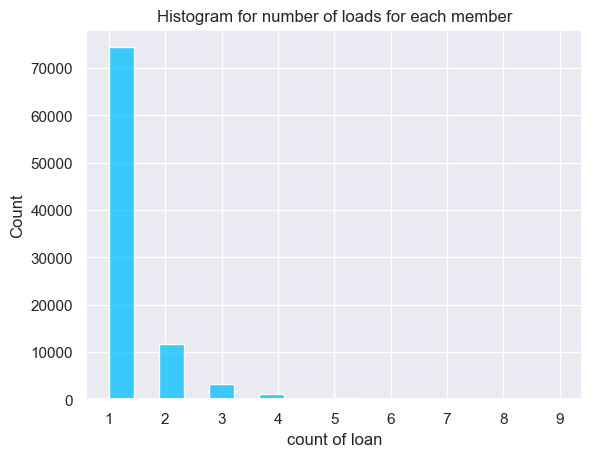

In [106]:
# Does the data set has many members that take more than one loan?

# Vast majority of customers in the data set have one loan, and roughly 2/7th of customers will have more than one loan.

mdist = dfc.groupby(['MemberKey'])['MemberKey'].count().sort_values(ascending=False).reset_index(name='counts')

ax = sns.histplot(data=mdist, x='counts', color='deepskyblue')
ax.set_xticks(sorted(mdist['counts'].unique())) # set xtickets first!! before setting xlabel below
ax.set_xticklabels(sorted(mdist['counts'].unique())) 
ax.set(xlabel="count of loan", ylabel="Count", title='Histogram for number of loads for each member');


In [18]:
# lets get a view of the rows with any NaNs and determine if pre/post Jul 2009 is a valid assumption as found in the data cleaning stage
# This shows where some variables have NaNs, other variables hold valuable data that can be useful for analysis in the same row! Therefore removing rows with 
# NaN could introduce bias in our data.

dfc[dfc.isna().any(axis=1)]#.sum()

,LoanOriginalAmount,LoanOriginationDate,MemberKey,LoanStatus,ListingCategory (numeric),Recommendations,LenderYield,EstimatedReturn,CreditGrade,CreditScoreRangeLower,...,IncomeRange,ProsperRating (Alpha),ProsperScore,IsBorrowerHomeowner,CurrentDelinquencies,DelinquenciesLast7Years,TradesOpenedLast6Months,DebtToIncomeRatio,IncomeRange,IncomeVerifiable
0,9425,2007-09-12 00:00:00,1F3E3376408759268057EDA,Completed,0,0,0.1380,NaN,C,640.0,...,"$25,000-49,999",NaN,NaN,True,2.0,4.0,0.0,0.17000,"$25,000-49,999",True
1,10000,2014-03-03 00:00:00,1D13370546739025387B2F4,Current,2,0,0.0820,0.05470,NaN,680.0,...,"$50,000-74,999",A,7.0,False,0.0,0.0,2.0,0.18000,"$50,000-74,999",True
2,3001,2007-01-17 00:00:00,5F7033715035555618FA612,Completed,0,0,0.2400,NaN,HR,480.0,...,Not displayed,NaN,NaN,False,1.0,0.0,NaN,0.06000,Not displayed,True
3,10000,2012-11-01 00:00:00,9ADE356069835475068C6D2,Current,16,0,0.0874,0.06000,NaN,800.0,...,"$25,000-49,999",A,9.0,True,4.0,14.0,0.0,0.15000,"$25,000-49,999",True
4,15000,2013-09-20 00:00:00,36CE356043264555721F06C,Current,2,0,0.1985,0.09066,NaN,680.0,...,"$100,000+",D,4.0,True,0.0,0.0,2.0,0.26000,"$100,000+",True
5,15000,2013-12-24 00:00:00,874A3701157341738DE458F,Current,1,0,0.1214,0.07077,NaN,740.0,...,"$100,000+",B,10.0,True,0.0,0.0,0.0,0.36000,"$100,000+",True
6,3000,2013-04-18 00:00:00,AA4535764146102879D5959,Current,1,0,0.2612,0.11070,NaN,680.0,...,"$25,000-49,999",E,2.0,False,0.0,0.0,0.0,0.27000,"$25,000-49,999",True
7,10000,2013-05-13 00:00:00,737F347089545035681C074,Current,2,0,0.1919,0.09840,NaN,700.0,...,"$25,000-49,999",C,4.0,False,0.0,0.0,0.0,0.24000,"$25,000-49,999",True
8,10000,2013-12-12 00:00:00,49A53699682291323D04D66,Current,7,0,0.0529,0.04231,NaN,820.0,...,"$25,000-49,999",AA,9.0,True,0.0,0.0,1.0,0.25000,"$25,000-49,999",True
9,10000,2013-12-12 00:00:00,49A53699682291323D04D66,Current,7,0,0.0529,0.04231,NaN,820.0,...,"$25,000-49,999",AA,11.0,True,0.0,0.0,1.0,0.25000,"$25,000-49,999",True


In [30]:
# We can filter out the NaNs rows further by looking at specific LoanStatuses.
# But this did not seem necessarly and does not give us any more info about the data set. a dead-end!

dfc[dfc.isna().any(axis=1)].query("LoanStatus == 'Completed'")#.sum()

,LoanOriginalAmount,LoanOriginationDate,MemberKey,LoanStatus,ListingCategory (numeric),Recommendations,LenderYield,EstimatedReturn,CreditGrade,CreditScoreRangeLower,...,IncomeRange,ProsperRating (Alpha),ProsperScore,IsBorrowerHomeowner,CurrentDelinquencies,DelinquenciesLast7Years,TradesOpenedLast6Months,DebtToIncomeRatio,IncomeRange,IncomeVerifiable
0,9425,2007-09-12 00:00:00,1F3E3376408759268057EDA,Completed,0,0,0.1380,NaN,C,640.0,...,"$25,000-49,999",NaN,NaN,True,2.0,4.0,0.0,0.17,"$25,000-49,999",True
2,3001,2007-01-17 00:00:00,5F7033715035555618FA612,Completed,0,0,0.2400,NaN,HR,480.0,...,Not displayed,NaN,NaN,False,1.0,0.0,NaN,0.06,Not displayed,True
11,1000,2007-10-18 00:00:00,59423376541417552B94BD3,Completed,0,0,0.1225,NaN,C,640.0,...,"$1-24,999",NaN,NaN,False,3.0,1.0,0.0,0.27,"$1-24,999",True
21,3000,2007-12-12 00:00:00,27F53404042184361C6DCD9,Completed,0,0,0.1975,NaN,D,620.0,...,"$25,000-49,999",NaN,NaN,False,1.0,5.0,0.0,0.09,"$25,000-49,999",True
26,4000,2013-02-21 00:00:00,D34635704845304767FB258,Completed,1,0,0.2709,0.1248,NaN,660.0,...,"$25,000-49,999",E,3.0,False,0.0,0.0,1.0,0.11,"$25,000-49,999",True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
113923,8000,2008-09-23 00:00:00,2CC43431047896407BFDB84,Completed,1,0,0.1989,NaN,B,700.0,...,"$25,000-49,999",NaN,NaN,True,0.0,0.0,4.0,0.57,"$25,000-49,999",True
113927,4292,2008-05-09 00:00:00,5BAF33803622558831EA3AC,Completed,4,2,0.0579,NaN,AA,760.0,...,"$100,000+",NaN,NaN,True,0.0,0.0,1.0,0.06,"$100,000+",True
113928,2000,2011-06-10 00:00:00,3A2F3380477699707C81385,Completed,3,0,0.1799,0.1147,NaN,740.0,...,"$25,000-49,999",C,6.0,False,0.0,0.0,0.0,0.27,"$25,000-49,999",True
113929,2500,2013-07-10 00:00:00,CBD43555702871369F462DA,Completed,2,0,0.2539,0.1093,NaN,660.0,...,"$50,000-74,999",E,3.0,False,0.0,9.0,1.0,0.05,"$50,000-74,999",True


In [17]:
get_ipython().ast_node_interactivity = 'all' #'last_expr' to revert to the default behaviour. Other possible options are 'none', 'last' and 'last_expr_or_assign'.

# let's look at the Estimated Return = NaN, which has a 25% NaNs in the data set, broken down by LoanStatus=Completed.

f"{dfc[dfc['EstimatedReturn'].isnull()]['LoanStatus'].count():.2f}", f"{dfc[dfc['EstimatedReturn'].isnull()]['LoanStatus'].count()/dfc.shape[0]:.2%}" # 0.2f for decimal, or 6.2f for decimal with leading spaces.
dfc['LoanStatus'].where(lambda x: x == 'Completed').count(), '<= Compeleted status Total Count'
dfc[dfc['EstimatedReturn'].isnull()]['LoanStatus'].where(lambda x: x == 'Completed').count(), '<= EstimatedReturn = NaN count' #isna()
dfc[dfc['EstimatedReturn'].notnull()]['LoanStatus'].where(lambda x: x == 'Completed').count(), '<= EstimatedReturn != NaN count' #notna()

# So, about 50% of LoanStatus=Completed has Estimated Return set to NaN.
# This again enforces that removing rows with NaNs from the data set is not wise.
# 'so we will deal with NaNs on a per analysis or plot basis.

('29084.00', '25.53%')

(38074, '<= Compeleted status Total Count')

(18410, '<= EstimatedReturn = NaN count')

(19664, '<= EstimatedReturn != NaN count')

In [18]:
get_ipython().ast_node_interactivity = 'all'

# let's look at the Estimated Return = NaN, which has a 25% NaNs in the data set, brokendown by LoanStatus=Current this time!

dfc['LoanStatus'].where(lambda x: x == 'Current').count(), '<= Current status Total Count'
dfc[dfc['EstimatedReturn'].isnull()]['LoanStatus'].where(lambda x: x == 'Current').count(), '<= EstimatedReturn = NaN count' #isna()
dfc[dfc['EstimatedReturn'].notnull()]['LoanStatus'].where(lambda x: x == 'Current').count(), '<= EstimatedReturn != NaN count' #notna()

(56576, '<= Current status Total Count')

(0, '<= EstimatedReturn = NaN count')

(56576, '<= EstimatedReturn != NaN count')

In [19]:
# a full breakdown of EstimatedReturn = NaNs by LoanStatus!
# We can see that only 4 LoanStatuses have EstimatedReturn with to NaNs. 
# Those are statuses that occured in the past! which makes sense given that EstimatedReturn is not filled for pre Jul 2009 data.
# So no unexpected NaNs in the post Jul 2009 is present.

dfc[dfc['EstimatedReturn'].isna()].groupby(['LoanStatus'])['LoanStatus'].count()

LoanStatus
Completed                 18410
Current                       0
Defaulted                  4013
Chargedoff                 6656
Cancelled                     5
FinalPaymentInProgress        0
Past Due (1-15 days)          0
Past Due (16-30 days)         0
Past Due (31-60 days)         0
Past Due (61-90 days)         0
Past Due (91-120 days)        0
Past Due (>120 days)          0
Name: LoanStatus, dtype: int64

In [61]:
# a full breakdown of EstimatedReturn != NaNs by LoanStatus! for analysis completion!
# we can see that EstimatedReturn is distributed acorss all entries for post Jul 2009 data.

dfc[dfc['EstimatedReturn'].notna()].groupby(['LoanStatus'])['LoanStatus'].count()

LoanStatus
Chargedoff                 5336
Completed                 19664
Current                   56576
Defaulted                  1005
FinalPaymentInProgress      205
Past Due (1-15 days)        806
Past Due (16-30 days)       265
Past Due (31-60 days)       363
Past Due (61-90 days)       313
Past Due (91-120 days)      304
Past Due (>120 days)         16
Name: LoanStatus, dtype: int64

In [32]:
dfc.LoanStatus.unique()

array(['Completed', 'Current', 'Past Due (1-15 days)', 'Defaulted',
       'Chargedoff', 'Past Due (16-30 days)', 'Cancelled',
       'Past Due (61-90 days)', 'Past Due (31-60 days)',
       'Past Due (91-120 days)', 'FinalPaymentInProgress',
       'Past Due (>120 days)'], dtype=object)

In [22]:
# double check that CreditGrade categorical variable is still an ordered list

dfc_old.CreditGrade
# we get categories listed at the bottom in provided order, like do
# ['AA' < 'A' < 'B' < 'C' < 'D' < 'E' < 'HR' < 'NC']

0          C
2         HR
11         C
17        AA
21         D
          ..
113921    AA
113922     C
113923     B
113926     E
113927    AA
Name: CreditGrade, Length: 28940, dtype: category
Categories (8, object): ['AA' < 'A' < 'B' < 'C' < 'D' < 'E' < 'HR' < 'NC']

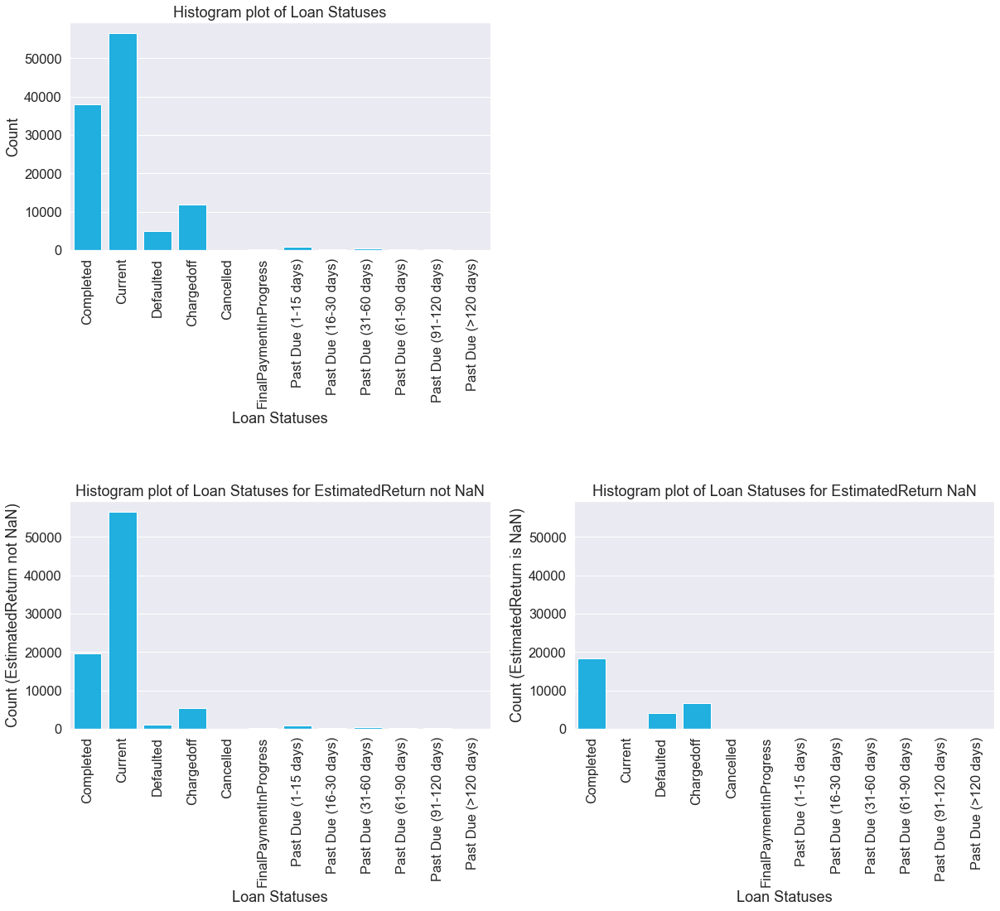

In [151]:
# let's plot the above numbers for visual inspection and ease of comparison!

plt.figure(figsize=(20,15))
plt.subplots_adjust(top = 0.8, bottom=0.01, hspace=1.1, wspace=0.2) #control gap between subplots

ax1=plt.subplot(2,2,1)
grid = sns.countplot(data=dfc, x='LoanStatus', color='deepskyblue')
#plt.xticks(rotation=90); # OR beter
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('Count plot of Loan Statuses')
grid.set(xlabel='Loan Statuses', ylabel='Count');

ax2=plt.subplot(2,2,3)
grid = sns.countplot(data=dfc[dfc['EstimatedReturn'].notna()], x='LoanStatus', color='deepskyblue')
#plt.xticks(rotation=90); # OR beter
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('Count plot of Loan Statuses for EstimatedReturn not NaN')
grid.set(xlabel='Loan Statuses', ylabel='Count (EstimatedReturn not NaN)');
ax2.sharey(ax1)

ax3=plt.subplot(2,2,4)
grid = sns.countplot(data=dfc[dfc['EstimatedReturn'].isna()], x='LoanStatus', color='deepskyblue')
#plt.xticks(rotation=90); # OR beter
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('Count plot of Loan Statuses for EstimatedReturn NaN')
grid.set(xlabel='Loan Statuses', ylabel='Count (EstimatedReturn is NaN)');
ax3.sharey(ax1);

### NaNs and EstimatedReturn / LoanStatuses analysis

The above analysis did not lead to many findings. However confirmed that NaNs are prsent predomenantly due to pre/post Jul 2009 data split.

Therefore, we still keep our initial conclusion of splitting the data to pre/post 2009 different sets for consistancy and analysis robustness!

The pre/post Jul 2009 data sets seem to suggest that we are looking at two different data sets with possibly different characteristics.

Therefore, it would be useful to have a look at the time trends for this data and see if there is any more insights can be gleaned from that!

In [558]:
# let's get a summary view of the LoanDate values.
dfc['LoanDate'].describe()

<ipython-input-558-15e7c42b1e54>:2: FutureWarning: Treating datetime data as categorical rather than numeric in `.describe` is deprecated and will be removed in a future version of pandas. Specify `datetime_is_numeric=True` to silence this warning and adopt the future behavior now.
  dfc['LoanDate'].describe()


count                  113937
unique                   1873
top       2014-01-22 00:00:00
freq                      491
first     2005-11-15 00:00:00
last      2014-03-12 00:00:00
Name: LoanDate, dtype: object

In [149]:
get_ipython().ast_node_interactivity = 'all'

years = (dfc['LoanDate'].max().year - dfc['LoanDate'].min().year)
years1 = dfc['LoanDate'].min().year
years2 = dfc['LoanDate'].max().year
months1 = dfc['LoanDate'].min().month
months2 = dfc['LoanDate'].max().month

print('Start year, End year')
years1, years2
print('Start Month, End months')
months1, months2
print('no. years, no. months')
years, years * 12

#create bins equal to number of months in the range
bins = (years - 2)*12 + months1 + months2 #(total number of years - first and last year)*12months + months from 1st year, and last year. 
bins

Start year, End year


(2005, 2014)

Start Month, End months


(11, 3)

no. years, no. months


(9, 108)

98

<Figure size 1080x360 with 0 Axes>

<AxesSubplot:>

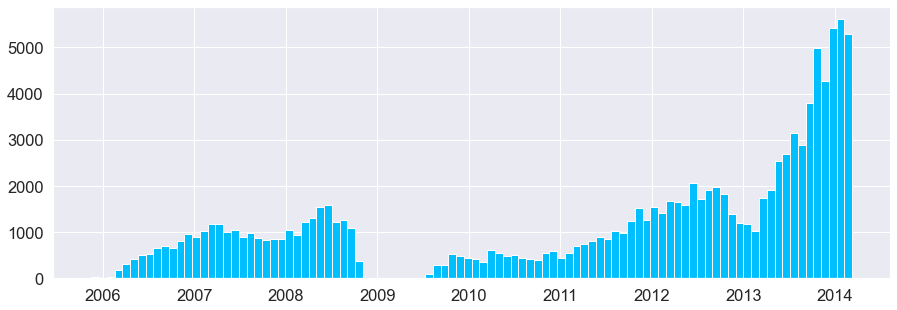

In [150]:
# let's look at the day distribution of loans.
# we can clearly see a gap in the middle of the data around end of 2008 and start 2009.
# bining data column is not a good idea, as it does not obey the month bounries. have to manually create x-axis monthly ticks for plotting in next plot.

plt.figure(figsize=(15,5))

# bin date column
dfc['LoanDate'].hist(bins=bins, color='deepskyblue') # bins is the number of months in the period between the minimum and maximum date years.

# I think bins did not work properly because the split is equals intervals, which does not necessarly respect months start and end.
# better to plot date x-axcess bar plot than using df.hist

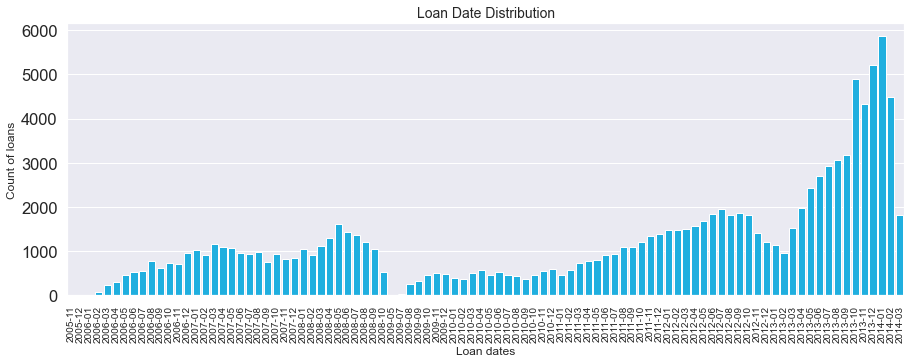

In [146]:
# let's look at the date distribution for the loans data set.
# we can see a gap in the middle splitting the data into two periods, 
# Some metrics are only present in one of the periods but not the other. Looks like some metrics are removed and some new ones
# are introduced in the second period starting Aug2008.

plt.figure(figsize=(15,5))

# get year_month values for ease of plotting timeline in ordered consistent manner: 
dfc['y_m'] = dfc['LoanDate'].map(lambda x: x.strftime('%Y-%m'))

grid = sns.countplot(data=dfc.sort_values(by=['y_m']), x='y_m', color='deepskyblue')
grid.tick_params(axis='x', labelrotation=90, labelsize=10)
grid.set_title('Loan Date Distribution', fontsize=14)
grid.set_xlabel("Loan dates", fontsize=12)
grid.set_ylabel("Count of loans", fontsize=12)

plt.show();

### Let's investigate the main features of interest

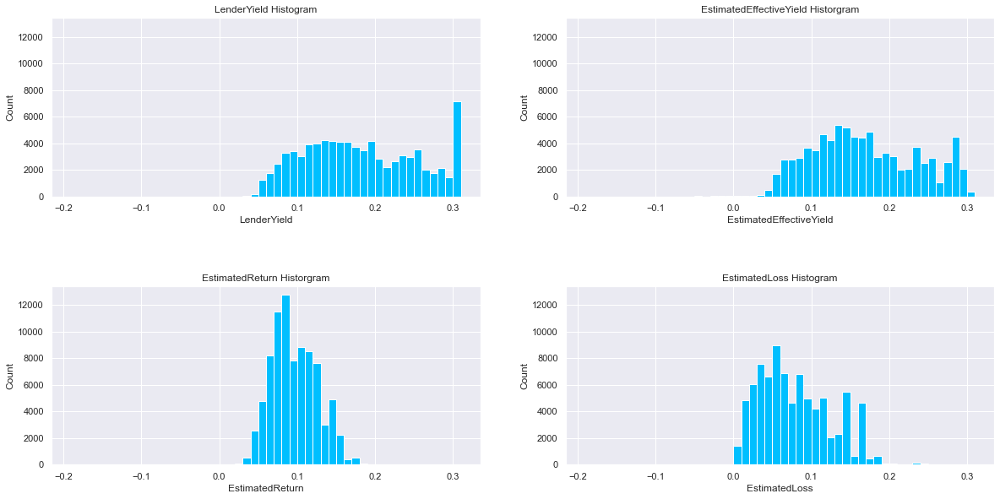

In [140]:
# What is the LenderYield and EstimatedReturn histograms look like? so to understand the distribution of values.

plt.figure(figsize = [20, 15])
plt.subplots_adjust(top = 0.5, bottom=0.01, hspace=.5, wspace=0.2)

# calcualte bins
start = int((dfc_new['EstimatedReturn'].min()-0.01) * 100)/100
end = int((dfc_new['EstimatedEffectiveYield'].max()+0.01)*100)/100
bins = np.arange(start, end , 0.01, dtype=float)

ax2 = plt.subplot(2, 2, 2)
ax2 = dfc_new['EstimatedEffectiveYield'].hist(bins = bins , color='deepskyblue');
ax2.set(xlabel="EstimatedEffectiveYield", ylabel="Count", title='EstimatedEffectiveYield Historgram')

ax1 = plt.subplot(2, 2, 1, sharex=ax2, sharey=ax2)
ax=dfc_new['LenderYield'].hist(bins = bins , color='deepskyblue')
ax.set(xlabel="LenderYield", ylabel="Count", title='LenderYield Histogram')


ax3 = plt.subplot(2, 2, 3, sharex=ax2, sharey=ax2)
ax = dfc_new['EstimatedReturn'].hist(bins = bins , color='deepskyblue');
ax.set(xlabel="EstimatedReturn", ylabel="Count", title='EstimatedReturn Historgram')

ax4 = plt.subplot(2, 2, 4, sharex=ax2, sharey=ax2)
ax=dfc_new['EstimatedLoss'].hist(bins = bins , color='deepskyblue')
ax.set(xlabel="EstimatedLoss", ylabel="Count", title='EstimatedLoss Histogram')

xleft, xright = ax4.get_xlim()
yleft, yright = ax4.get_ylim()
plt.show();

In [156]:
# validate values
get_ipython().ast_node_interactivity = 'all'

xleft, xright
yleft, yright
# (0.014500000000000002, 0.35550000000000004)
# (0.0, 7343.7)

(-0.21500000000000002, 0.33500000000000046)

(0.0, 13433.7)

(194, 85)

-0.1827

-0.0251    29
-0.0461    26
-0.0100     5
-0.0836     5
-0.0166     4
           ..
-0.0470     1
-0.0508     1
-0.0859     1
-0.1398     1
-0.0050     1
Name: EstimatedReturn, Length: 100, dtype: int64

<Figure size 1440x720 with 0 Axes>

[Text(0.5, 0, 'EstimatedEffectiveYield'),
 Text(0, 0.5, 'Count'),
 Text(0.5, 1.0, 'EstimatedEffectiveYield Historgram')]

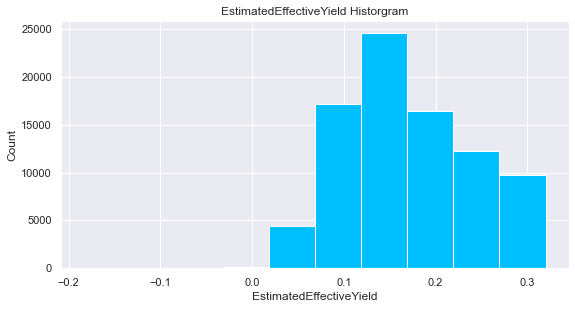

In [138]:
# If used LenderYield for generating bins, it trims EstimatedReturn x-axis for values below 0. 
# These values under 0 are very few and not noticable in the histogram plot as show in the below numbers and plot
get_ipython().ast_node_interactivity = 'all'

dfc_new[dfc_new['EstimatedReturn'] < 0 ].shape
dfc_new[dfc_new['EstimatedReturn'] < 0 ]['EstimatedReturn'].min()
dfc_new[dfc_new['EstimatedReturn'] < 0 ]['EstimatedReturn'].value_counts()

plt.figure(figsize = [20, 10])
ax2 = plt.subplot(2, 2, 2)
ax2 = dfc_new['EstimatedEffectiveYield'].hist( color='deepskyblue');
ax2.set(xlabel="EstimatedEffectiveYield", ylabel="Count", title='EstimatedEffectiveYield Historgram')

In [159]:
# compare np bin generated array vs manually generated array of bins
np.set_printoptions(suppress=False)

bins_old = np.histogram_bin_edges(dfc_old['LenderYield'], bins='fd')
bins_old

bins_calc = np.arange(dfc_old['LenderYield'].min(), dfc_old['LenderYield'].max()+0.01 , 0.01)
bins_calc

array([-0.01      , -0.00320946,  0.00358108,  0.01037162,  0.01716216,
        0.0239527 ,  0.03074324,  0.03753378,  0.04432432,  0.05111486,
        0.05790541,  0.06469595,  0.07148649,  0.07827703,  0.08506757,
        0.09185811,  0.09864865,  0.10543919,  0.11222973,  0.11902027,
        0.12581081,  0.13260135,  0.13939189,  0.14618243,  0.15297297,
        0.15976351,  0.16655405,  0.17334459,  0.18013514,  0.18692568,
        0.19371622,  0.20050676,  0.2072973 ,  0.21408784,  0.22087838,
        0.22766892,  0.23445946,  0.24125   ,  0.24804054,  0.25483108,
        0.26162162,  0.26841216,  0.2752027 ,  0.28199324,  0.28878378,
        0.29557432,  0.30236486,  0.30915541,  0.31594595,  0.32273649,
        0.32952703,  0.33631757,  0.34310811,  0.34989865,  0.35668919,
        0.36347973,  0.37027027,  0.37706081,  0.38385135,  0.39064189,
        0.39743243,  0.40422297,  0.41101351,  0.41780405,  0.42459459,
        0.43138514,  0.43817568,  0.44496622,  0.45175676,  0.45

array([-0.01,  0.  ,  0.01,  0.02,  0.03,  0.04,  0.05,  0.06,  0.07,
        0.08,  0.09,  0.1 ,  0.11,  0.12,  0.13,  0.14,  0.15,  0.16,
        0.17,  0.18,  0.19,  0.2 ,  0.21,  0.22,  0.23,  0.24,  0.25,
        0.26,  0.27,  0.28,  0.29,  0.3 ,  0.31,  0.32,  0.33,  0.34,
        0.35,  0.36,  0.37,  0.38,  0.39,  0.4 ,  0.41,  0.42,  0.43,
        0.44,  0.45,  0.46,  0.47,  0.48,  0.49,  0.5 ])

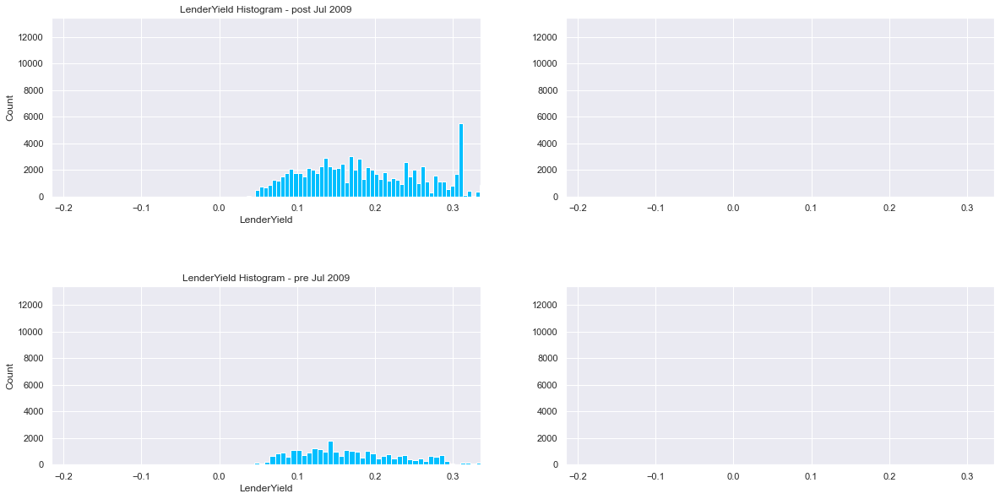

In [135]:
# LenderYield is the only variable present in pre Jul 2009
# So, what is the distribution of LenderYield values like for pre 2009 and post 2009 periods?

# The distributions of pre Jul 2009 and post Jul 2009 look very similar with one noticable distinction, post Jul 2009 data has a 
# large peak around LenderYield 3.1 vs pre Jul 2009, which could be due to some change in post Jul 2009 data, e.g.:
# introducing new product / loan category with fixed rate at around 3.1
# or making a change to how LenderYield is calculated.

plt.figure(figsize = [20, 15])
plt.subplots_adjust(top = 0.5, bottom=0.01, hspace=.5, wspace=0.2) # control gap between subplots

bins_new = np.histogram_bin_edges(dfc_new['LenderYield'], bins='fd') # bins=auto or bins='fd' to force the Freedman Diaconis Estimator
bins_old = np.histogram_bin_edges(dfc_old['LenderYield'], bins='fd')

ax1=plt.subplot(221)
ax1.set_xlim(xleft, xright)  # set to previous plot for ease of comparison
ax1.set_ylim(yleft, yright)

ax=dfc_new['LenderYield'].hist(bins = bins_new, color='deepskyblue')
ax.set(xlabel="LenderYield", ylabel="Count", title='LenderYield Histogram - post Jul 2009')

# just a placeholder to align plots
ax2=plt.subplot(222, sharex=ax1, sharey=ax1)


ax3=plt.subplot(223, sharex=ax1, sharey=ax1)
ax=dfc_old['LenderYield'].hist(bins = bins_old, color='deepskyblue')
ax.set(xlabel="LenderYield", ylabel="Count", title='LenderYield Histogram - pre Jul 2009')

# just a placeholder to align plots
ax4=plt.subplot(224, sharex=ax1, sharey=ax1)

plt.show();

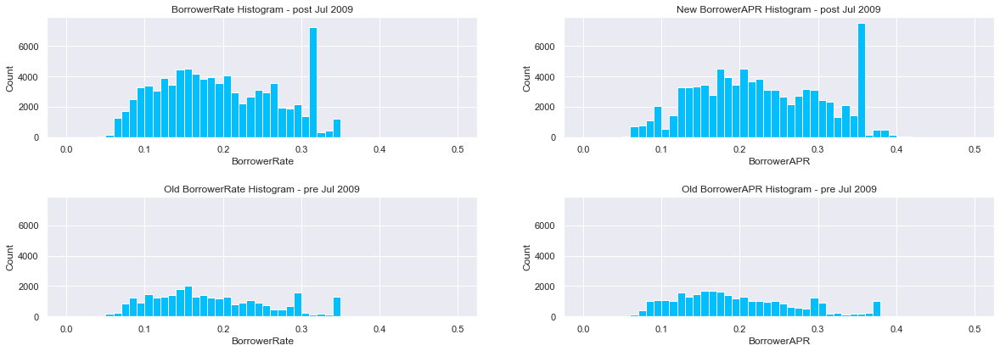

In [136]:
# Does BorrowerRate and BorrowerRateAPR exhibit the same observations for LenderYield when comparing pre 2009 and post 2009 periods?

# Those plots below reiterate and confirms the the previous observations in LenderYield in the above plots, where in the 
# post Jul 2009 there is a large peak of BorrowerRate around (0.3-0.32) and BorrowerRateAPR (around 0.35-0.36).


# using ax2.sharey(ax1)
# using own clac of bins

plt.figure(figsize = [20, 10])
plt.subplots_adjust(top = 0.5, bottom=0.01, hspace=.5, wspace=0.2) #control gap between subplots

bins_calc = np.arange(dfc['BorrowerRate'].min(), dfc['BorrowerRate'].max()+0.01 , 0.01)

plt.subplot(221)
ax1=dfc_new['BorrowerRate'].hist(bins = bins_calc, color='deepskyblue')
ax1.set(xlabel="BorrowerRate", ylabel="Count", title='BorrowerRate Histogram - post Jul 2009')

plt.subplot(222)
ax2=dfc_new['BorrowerAPR'].hist(bins = bins_calc, color='deepskyblue')
ax2.set(xlabel="BorrowerAPR", ylabel="Count", title='New BorrowerAPR Histogram - post Jul 2009')
ax2.sharex(ax1)
ax2.sharey(ax1);

plt.subplot(223)
ax3=dfc_old['BorrowerRate'].hist(bins = bins_calc, color='deepskyblue')
ax3.set(xlabel="BorrowerRate", ylabel="Count", title='Old BorrowerRate Histogram - pre Jul 2009')
ax3.sharex(ax1)
ax3.sharey(ax1);

plt.subplot(224)
ax4=dfc_old['BorrowerAPR'].hist(bins = bins_calc, color='deepskyblue')
ax4.set(xlabel="BorrowerAPR", ylabel="Count", title='Old BorrowerAPR Histogram - pre Jul 2009')
ax4.sharex(ax1)
ax4.sharey(ax1);



### Lender Yield and Estimated Return analysis above

The analysis above revealed that:
- LenderYiled take a bimodal shaped distribution with one bell centered around 0.15 and second bell centered around 0.25.
- There is an abnormal large peak at around 0.3-0.32 for LenderYield, which is an exception to the bimodal distribution observed above.
- The Estimated Return range is very narrow, where it falls betweeen the lowe bound of 0.04 to upper band of 0.18, when compared to LenderYield and EstimatedEffectiveYield, which both spread between 0.04 to 0.32. 
- This indicates that loans with higher LenderYield are not necessarly translating into higher Returns (Profits) to lenders, This indicates that EstimatedLoss is much higher for loans with higher LenderYield.
- BorrrowerRate and BorrowerAPR follow a similar distribution and range to the LenderYiled, and EstimatedEffectiveYield, which lines up with what is expected!

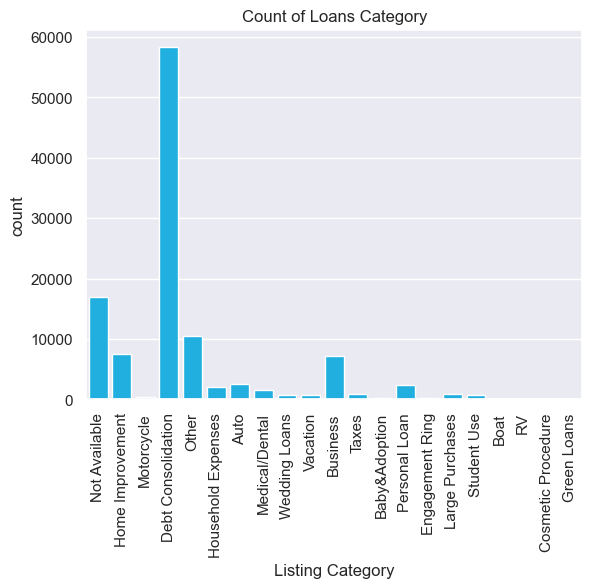

In [114]:
# Let's examine the distribution of loan Categories, where I suspect there will be important variations that influences trends in data

# Debt Consolidation is by a large margin is the most dominant loan category.
# Not Available and Other are the second most common classifications, which surprising. Also, what is the difference between them?
# Home Improvement and Business are also a bit more popular than other cateogires

grid = sns.countplot(x=df['ListingCategory'], color='deepskyblue')
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('Count of Loans Category')
grid.set(xlabel='Listing Category', ylabel='count');

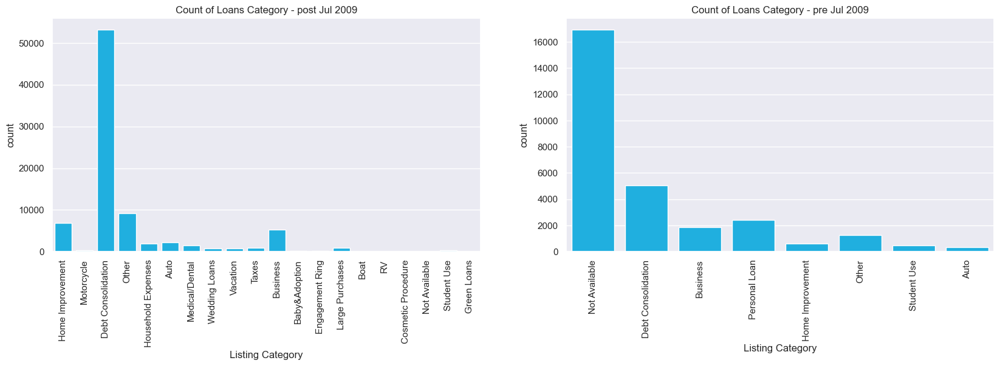

In [115]:
# Lets compare pre and post Jul 2009 for loan categories

# there are more categories introduced post Jul 2009 compared to pre Jul 2009 (19 vs 6 categories) .
# Not available is the most dominant classication of loans pre Jul 2009. Does this indicate a technical fault in data export? or data capture? in Pre Jul 2009 systems
# or was it limitation when logging cateogries. Does this classification capture categories that are now better classified in post Jul 2009?
# Post Jul 2009 data set show the introduction of Debt Consolidation, which may be a totally new loan product, or was classified as Not Available in pre Jul 2009 data set
# Post Jul 2009 still contains Other category, which is also present in pre Jul 2009.

plt.figure(figsize = [20, 5])
plt.subplot(1, 2, 1)
#dfc_new['ListingCategory'].value_counts()
grid = sns.countplot(x=dfc_new['ListingCategory'], color='deepskyblue')
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('Count of Loans Category - post Jul 2009')
grid.set(xlabel='Listing Category', ylabel='count')

plt.subplot(1, 2, 2)
grid = sns.countplot(x=dfc_old['ListingCategory'], color='deepskyblue')
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('Count of Loans Category - pre Jul 2009')
grid.set(xlabel='Listing Category', ylabel='count');

In [46]:
# How much do people borrow?

dfc['LoanOriginalAmount'].describe()

# It seems the minimum amount of borrowing is set at 1000, and the maximum is set at 35000

count    113937.00000
mean       8337.01385
std        6245.80058
min        1000.00000
25%        4000.00000
50%        6500.00000
75%       12000.00000
max       35000.00000
Name: LoanOriginalAmount, dtype: float64

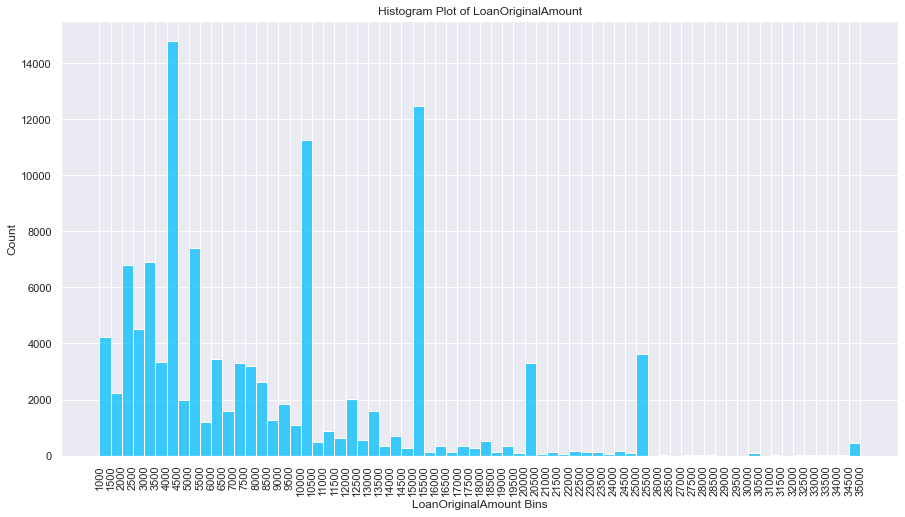

In [125]:
# how does the histogram of Loan amounts look like?

# The histogram shows a number fo very large peaks for some loan value bins. What could be causing this?
# Use white grid plot background from seaborn

plt.figure(figsize=(15,8))
bins_x = np.arange(1000, 35000+500, 500)
#print(bins_x)
grid = sns.histplot(data=dfc, x='LoanOriginalAmount', bins=bins_x, color='deepskyblue' ) #binwidth=500
grid.set_xticks(bins_x) # <--- set the ticks first
grid.set_xticklabels(bins_x,rotation=90); 
grid.set_title('Histogram Plot of LoanOriginalAmount')
grid.set(xlabel='LoanOriginalAmount Bins', ylabel='Count');


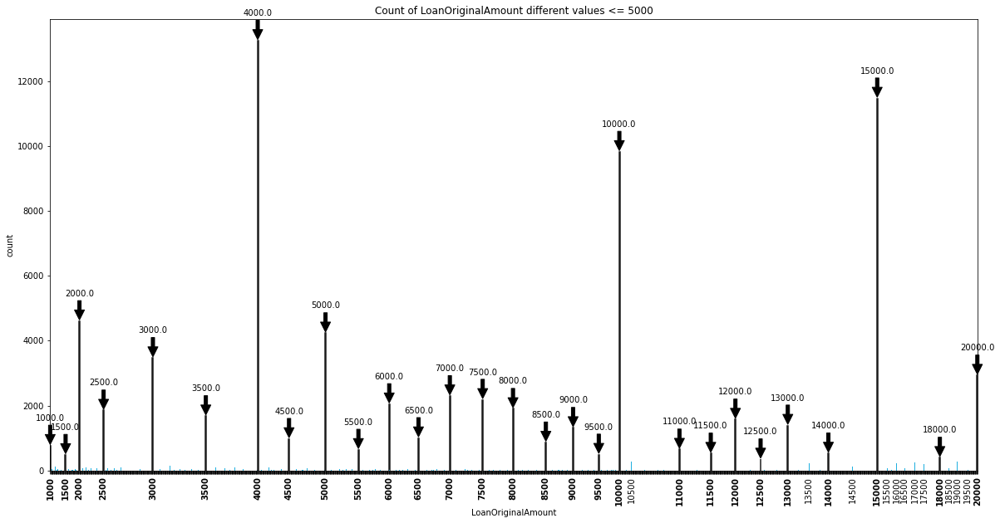

In [129]:
# Let's check the actual count of loan values to determine if loans are a spectrum spread of values or are fixed at specific values
# due to the wide range of loan values, let's zoom in at loans below 5000

# There are large concentrations (counts) of loans at specific values such as 2000, 2500, 3000, 3500, 4000, 4500, 5000. That are also many loans distributed between 
# those peak values highlighted by the very tinny blue picks at the x-axis.


import matplotlib.ticker as ticker
sns.reset_orig() 

fig = plt.figure(figsize=(20,10))

grid = sns.countplot(x=dfc_new['LoanOriginalAmount'].where(lambda x : x<=20001), color='deepskyblue')
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('Count of LoanOriginalAmount different values <= 5000')
grid.set(xlabel='LoanOriginalAmount', ylabel='count');

# annotate/highlight high volume counts bars
def annotate(ax,threshold):
    for i,t in enumerate(ax.get_xticklabels()):
        if ax.patches[i].get_height() > threshold:
            ## bold ticklabels
            t.set_weight("bold")
            ## bar edges
            ax.patches[i].set_edgecolor("k")
            ax.patches[i].set_linewidth(1.5)
            ## arrow annotations
            ax.annotate(t.get_text(),(i, ax.patches[i].get_height()), 
                        xytext=(0,30), textcoords='offset points', ha="center",
                        arrowprops=dict(facecolor='black', shrink=0.05))
annotate(grid,300)

# change rectangle width of bars (vertical lines) in the plot to make them more pronounced
def change_width(ax, frac):
    for patch in ax.patches:
        current_width = patch.get_width()
        new_value = current_width*frac

        # we change the bar width
        patch.set_width(new_value)

        # we recenter the bar
        diff = current_width - new_value
        patch.set_x(patch.get_x() + diff * .5)

change_width(grid, 2)

# display the x-ticks only at intervals we want to highlight. otherwise x-axis becomes cluttered
def format_xlabels(grid, interval):
    labelslist = grid.get_xticks().tolist()
    for i,label in enumerate(grid.get_xticklabels()):

        labelslist[i]=str(int(float(label.get_text())))
        label.set_text(str(int(float(label.get_text()))))

        if np.float64(label.get_text()) % interval == 0:  
            label.set_visible(True)
        else:
            label.set_visible(False)
    grid.set_xticklabels(labelslist)

format_xlabels(grid, 500)

fig.canvas.draw()
plt.show();

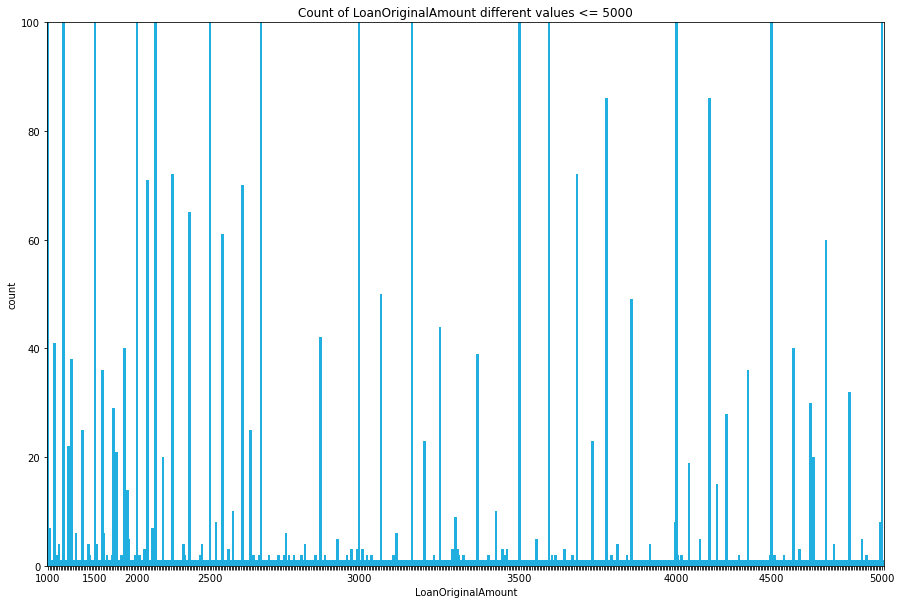

In [427]:
# Let's zoom in at the very low values to make them visible and verify that aside from the very large peaks, 
# there is a wide spread spectrum of loan values between those noticable peaks in the previous plot

import matplotlib.ticker as ticker
sns.reset_orig() 

fig = plt.figure(figsize=(15,10))

grid = sns.countplot(x=dfc_new['LoanOriginalAmount'].where(lambda x : x<=5001), color='deepskyblue')

grid.set_title('Count of LoanOriginalAmount different values <= 5000')
grid.set(xlabel='LoanOriginalAmount', ylabel='count');

# annotate/highlight high volume counts
def annotate(ax,threshold):
    for i,t in enumerate(ax.get_xticklabels()):
        if ax.patches[i].get_height() > threshold:
            ## bold ticklabels
            t.set_weight("bold")
            ## bar edges
            ax.patches[i].set_edgecolor("k")
            ax.patches[i].set_linewidth(1.5)
            ## arrow annotations
            ax.annotate(t.get_text(),(i, ax.patches[i].get_height()), 
                        xytext=(0,30), textcoords='offset points', ha="center",
                        arrowprops=dict(facecolor='black', shrink=0.05))
#annotate(grid,300)

# change rectangle width of bars (vertical lines) in the plot to make them more pronounced
def change_width(ax, frac):
    for patch in ax.patches:
        current_width = patch.get_width()
        new_value = current_width*frac

        # we change the bar width
        patch.set_width(new_value)

        # we recenter the bar
        diff = current_width - new_value
        patch.set_x(patch.get_x() + diff * .5)

change_width(grid, 2)

# display the x-ticks only at intervals we want to highlight. otherwise x-axis becomes cluttered
def format_xlabels(grid, interval):
    labelslist = grid.get_xticks().tolist()
    for i,label in enumerate(grid.get_xticklabels()):

        labelslist[i]=str(int(float(label.get_text())))
        label.set_text(str(int(float(label.get_text()))))

        if np.float64(label.get_text()) % interval == 0:  
            label.set_visible(True)
        else:
            label.set_visible(False)
    grid.set_xticklabels(labelslist)

format_xlabels(grid, 500)

# we can remove certain columns from the plot if deemed necessary.
# def remove_elm (grid, threshold):
#     for patch in grid.patches:
#         if patch.get_height() > 300:
#             patch.remove()
#     fig.canvas.draw()

# remove_elm(grid,300)


# zoom in on the y-axis to see the inbetween loans distribution
grid.set_ylim([0,100])

fig.canvas.draw();

plt.show();



In [167]:
# check top Loan Values

dfc_new.groupby('LoanOriginalAmount')['LoanOriginalAmount'].count().sort_values(ascending=False)[0:20]

LoanOriginalAmount
4000     13238
15000    11462
10000     9819
2000      4603
5000      4230
3000      3467
20000     2928
25000     2788
7000      2294
7500      2181
6000      2046
8000      1900
2500      1851
3500      1676
12000     1573
13000     1388
9000      1315
6500      1001
4500       976
8500       866
Name: LoanOriginalAmount, dtype: int64

In [428]:
# check bottom Loan Values

dfc_new.groupby('LoanOriginalAmount')['LoanOriginalAmount'].count().sort_values(ascending=True)[0:20]

LoanOriginalAmount
8544     1
10958    1
10956    1
10951    1
10950    1
10949    1
10948    1
10932    1
10914    1
10900    1
10897    1
10896    1
10884    1
10874    1
10868    1
10864    1
10831    1
10830    1
10828    1
10825    1
Name: LoanOriginalAmount, dtype: int64

### The analysis above shows three key observations

- There are no loan amounts less than 1K.

- Loan amounts 1K-5K dollars are the most popular loan amounts, followed by 5K-10K loan amounts, then followed by 10K-15K

- There are global 'very big' spikes for loan amounts at exact whole numbers e.g.: (4,000), (10,000), (15,000) ..etc.

- There are local 'big' spikes for loan amounts at exact whole numbers e.g. (1,000),(2,000), (3,000), (5,000), (6,000) ..etc. 

- Then there are local medium spikes for loans at one half of numbers e.g. (1,500), (2,500), (3,500) ..etc.

- The histogram plot is skewed to the right. Therefore, given it is monetary values, a log transformation on the x axis might be suitable for explaining the loan amount trends.

In [20]:
# lets check what a log of LoanOriginalAmount might look like:

np.log10(dfc['LoanOriginalAmount'].describe())

count    5.056665
mean     3.921011
std      3.795588
min      3.000000
25%      3.602060
50%      3.812913
75%      4.079181
max      4.544068
Name: LoanOriginalAmount, dtype: float64

In [86]:
# let's create log bins for histogram

bins_xlog = 10 ** np.arange(3, 4.55 + 0.1, 0.1)
bins_xlog

array([ 1000.        ,  1258.92541179,  1584.89319246,  1995.26231497,
        2511.88643151,  3162.27766017,  3981.07170553,  5011.87233627,
        6309.5734448 ,  7943.28234724, 10000.        , 12589.25411794,
       15848.93192461, 19952.62314969, 25118.8643151 , 31622.77660168,
       39810.71705535])

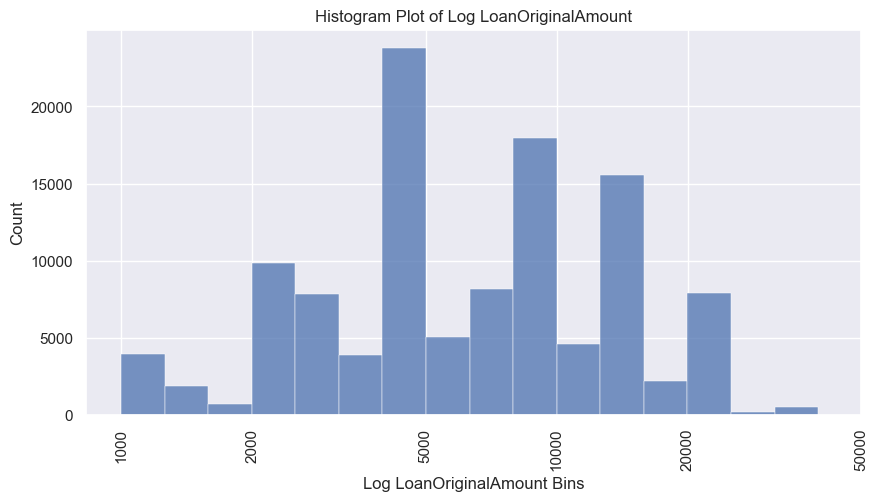

In [113]:
# let's plot the histogram of log transformation on LoanOriginalAmount:

# The histogram now exhibits a shape similar to normal distribution bell. Which indicates the LoanOriginalAmount trends to change by multiplicative factors.

plt.figure(figsize=(10,5))

tick_locs = [1000, 2000, 5000, 10000, 20000, 50000]

grid = sns.histplot(data=dfc, x='LoanOriginalAmount', bins=bins_xlog) #binwidth=500
grid.set(xscale="log") #, yscale="log"

grid.set_xticks(tick_locs) # <--- set the ticks first
grid.set_xticklabels(tick_locs, rotation=90);
grid.set_title('Histogram Plot of Log LoanOriginalAmount')
grid.set(xlabel='Log LoanOriginalAmount Bins', ylabel='Count');

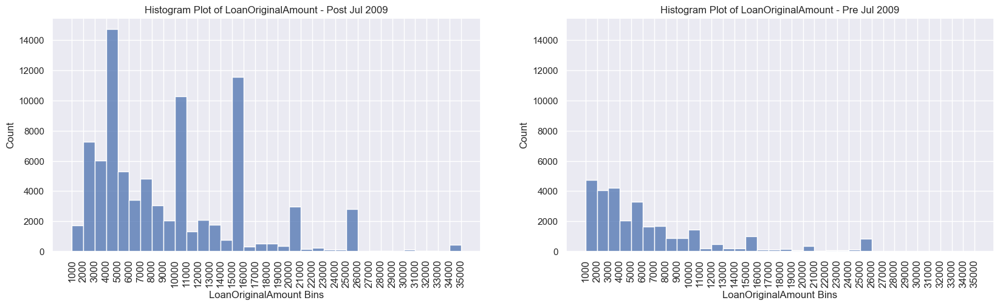

In [112]:
# So, how does the LoanOriginalAmount differ between data for post Jul 2009 and data for pre Jul 2009?
# Pre Jul 2009 data shows loan amounts in the smaller values to be the most dominant, however 
# Post Jul 2009 data shows a reduction of very small amounts less than 2000, and overall increase in the other loan amount values, but more noticably
# a very large increase in (4000-5000, 10000-11000, 15000-16000, 20000-21000, 25000-26000)!

plt.figure(figsize = [20, 5])
plt.subplot(1, 2, 1)

bins_x = np.arange(1000, 35000+1000, 1000)

grid1 = sns.histplot(data=dfc_new, x='LoanOriginalAmount', bins=bins_x) #binwidth=500
grid1.set_xticks(bins_x) # <--- set the ticks first
grid1.set_xticklabels(bins_x, rotation=90, fontsize=12); 
grid1.set_title('Histogram Plot of LoanOriginalAmount - Post Jul 2009')
grid1.set(xlabel='LoanOriginalAmount Bins', ylabel='Count');

plt.subplot(1, 2, 2)

bins_x = np.arange(1000, 35000+1000, 1000)

grid2 = sns.histplot(data=dfc_old, x='LoanOriginalAmount', bins=bins_x) #binwidth=500
grid2.sharey(grid1) # adjust y scales for ease of comparison
grid2.set_xticks(bins_x) # <--- set the ticks first
grid2.set_xticklabels(bins_x, rotation=90, fontsize=12); 
grid2.set_title('Histogram Plot of LoanOriginalAmount - Pre Jul 2009')
grid2.set(xlabel='LoanOriginalAmount Bins', ylabel='Count');

In [110]:
# product the bins for the log transformation

bins_xlog = 10 ** np.arange(3, 4.55 + 0.1, 0.1)
bins_xlog

array([ 1000.        ,  1258.92541179,  1584.89319246,  1995.26231497,
        2511.88643151,  3162.27766017,  3981.07170553,  5011.87233627,
        6309.5734448 ,  7943.28234724, 10000.        , 12589.25411794,
       15848.93192461, 19952.62314969, 25118.8643151 , 31622.77660168,
       39810.71705535])

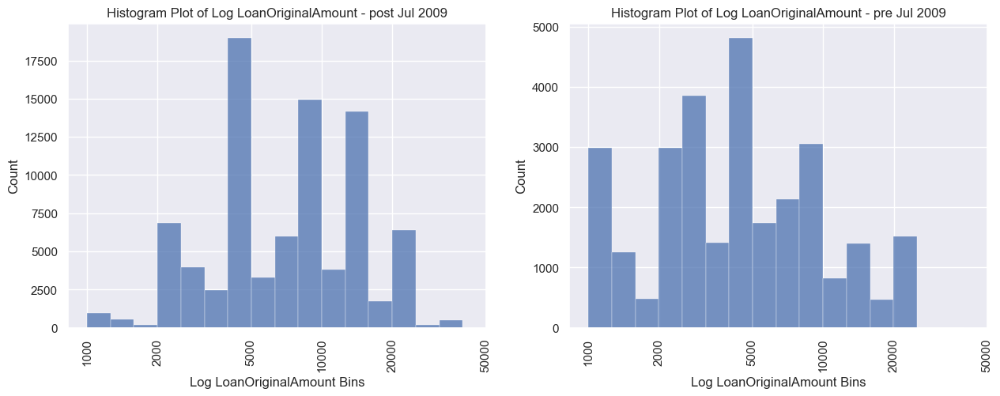

In [111]:
# Ok, so let's apply log transformation to the LoanOriginalAmount for post Jul 2009 and data for pre Jul 2009 datasets?
# The plots have resplance of a normal distribution bill curve. However the very large peaks are distorting the bill shape.
# excluding the very lage peaks for very specific loan amounts, once can potentially observe a multplicative increase of value in the 
# post Jul 2009 dataset. While the pre Jul 2009 data set could be described having bimodal shape.
# Post Jul 2009 data shows the shift towards higher loan amounts vs the pre Jul 2009

plt.figure(figsize=(15,5))

plt.subplot(1, 2, 1)

tick_locs = [1000, 2000, 5000, 10000, 20000, 50000] #cycles of 1-3-10 or 1-2-5-10 are very useful for base-10
grid = sns.histplot(data=dfc_new, x='LoanOriginalAmount', bins=bins_xlog) #binwidth=500
grid.set(xscale="log") #, yscale="log"
grid.set_xticks(tick_locs) # <--- set the ticks first
grid.set_xticklabels(tick_locs,rotation=90);
grid.set_title('Histogram Plot of Log LoanOriginalAmount - post Jul 2009')
grid.set(xlabel='Log LoanOriginalAmount Bins', ylabel='Count');

plt.subplot(1, 2, 2)

tick_locs = [1000, 2000, 5000, 10000, 20000, 50000] #cycles of 1-3-10 or 1-2-5-10 are very useful for base-10
grid = sns.histplot(data=dfc_old, x='LoanOriginalAmount', bins=bins_xlog) #binwidth=500
grid.set(xscale="log") #, yscale="log"
grid.set_xticks(tick_locs) # <--- set the ticks first
grid.set_xticklabels(tick_locs,rotation=90);
grid.set_title('Histogram Plot of Log LoanOriginalAmount - pre Jul 2009')
grid.set(xlabel='Log LoanOriginalAmount Bins', ylabel='Count');

### Loan Amount Analysis

- The previous analysis showed a shift towards higher loan amounts post Jul 2009 vs pre Jul 2009.

- pre Jul 2009 data shows a reduction in the very small loan amounts (less than 2000)

- Post Jul 2009 data shows a very large increase of (4000, 5000, 10000, 15000, 20000, and 25000) loan amounts

- The LoanOriginalAmount histogra distribution shows right skewed histogram. Ignoring the very large peaks identifed in the prievous point, the histograms take a bimodal shape specially between these values (1K-5K, 5K-10K, 10K-15K, 15K-20K, and 20K-25K)

- LoanOriginalAmoutn seems to increase in multiplicative fashion.


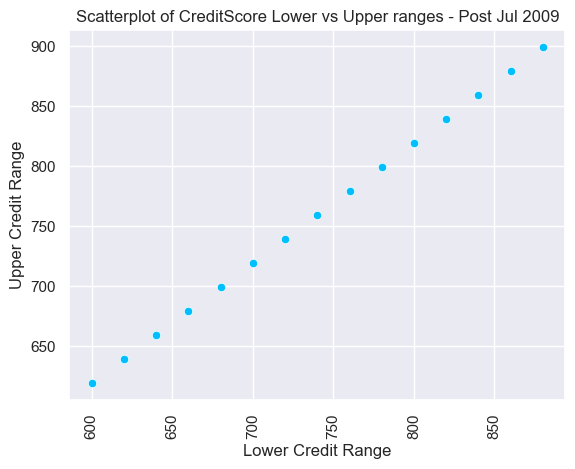

In [108]:
# how does the CreditScore look like (only available for post Jul 2009) and what is the relationship between the Lower and Upper credit scores? 

# we see that the lower and upper credit scores represent the coordinates of 15 points (credit scores) (dots on the scale), 
# and they are not a scatter of values as originally thought.

grid = sns.scatterplot(data=dfc_new[dfc_new['CreditScoreRangeLower'].notna()], x='CreditScoreRangeLower', y='CreditScoreRangeUpper', color='deepskyblue')
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('Scatterplot of CreditScore Lower vs Upper ranges - Post Jul 2009')
grid.set(xlabel='Lower Credit Range', ylabel='Upper Credit Range');

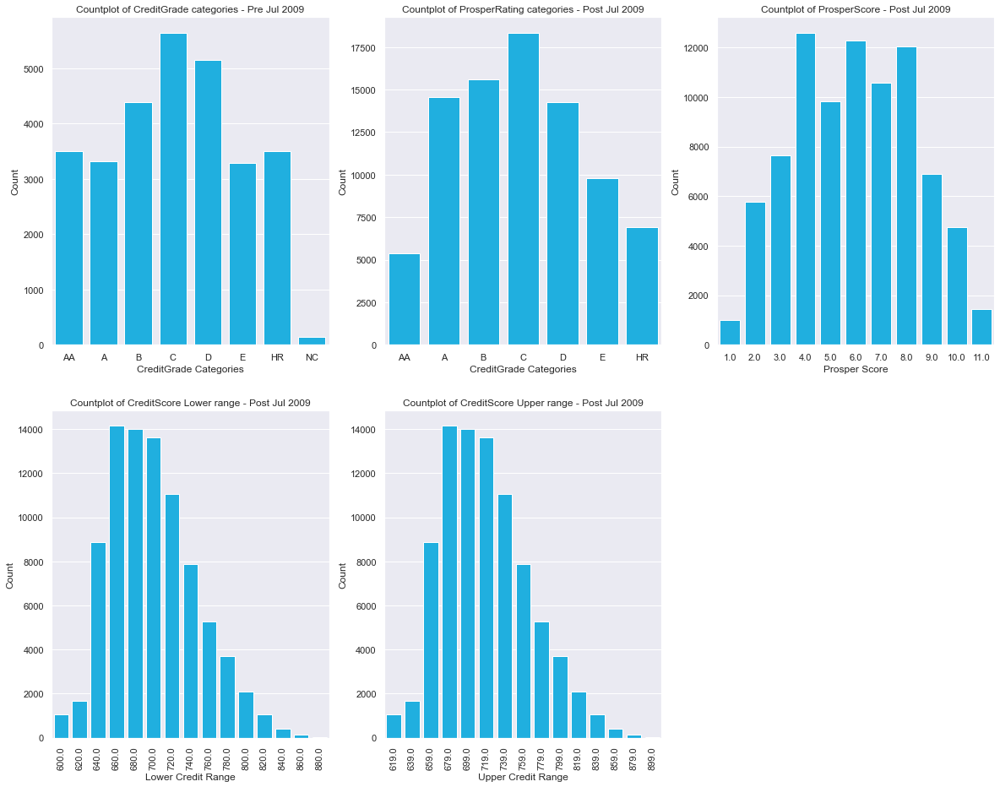

In [542]:
# let's plot the CreditScore, CreditGrade, ProsperScore, and ProsperRating variables to understand their distribution

# pre Jul 2009 data shows that CreditGrade was used solely to determine credit worthness of borrowers. However post Jul 2009 data shows 
# that other credit rating metrics were used to determine credit worthness of borrowers and and risk associated with Loans namely; 
# Prosper Rating, Prosper Score, and CreditScore.

plt.figure(figsize=(20,15))
plt.subplots_adjust(top = 0.8, bottom=0.01, hspace=0.2, wspace=0.2) #control gap between subplots

ax1=plt.subplot(2,3,1)
grid = sns.countplot(data=dfc_old[dfc_old['CreditGrade'].notna()], x='CreditGrade', color='deepskyblue')
grid.tick_params(axis='x') #, labelrotation=90
grid.set_title('Countplot of CreditGrade categories - Pre Jul 2009')
grid.set(xlabel='CreditGrade Categories', ylabel='Count');

ax2=plt.subplot(2,3,2)
grid = sns.countplot(data=dfc_new[dfc_new['ProsperRating (Alpha)'].notna()], x='ProsperRating (Alpha)', color='deepskyblue')
grid.tick_params(axis='x') #, labelrotation=90
grid.set_title('Countplot of ProsperRating categories - Post Jul 2009')
grid.set(xlabel='ProsperRating', ylabel='Count');

ax4=plt.subplot(2,3,3)
grid = sns.countplot(data=dfc_new[dfc_new['ProsperScore'].notna()], x='ProsperScore', color='deepskyblue')
grid.tick_params(axis='x') #, labelrotation=90
grid.set_title('Countplot of ProsperScore - Post Jul 2009')
grid.set(xlabel='Prosper Score', ylabel='Count');

ax3=plt.subplot(2,3,4)
grid = sns.countplot(data=dfc_new[dfc_new['CreditScoreRangeLower'].notna()], x='CreditScoreRangeLower', color='deepskyblue')
grid.tick_params(axis='x') #, labelrotation=90
grid.set_title('Countplot of CreditScore Lower range - Post Jul 2009')
grid.set(xlabel='Lower Credit Range', ylabel='Count');
grid.tick_params(axis='x', labelrotation=90)

ax3=plt.subplot(2,3,5)
grid = sns.countplot(data=dfc_new[dfc_new['CreditScoreRangeUpper'].notna()], x='CreditScoreRangeUpper', color='deepskyblue')
grid.tick_params(axis='x') #, labelrotation=90
grid.set_title('Countplot of CreditScore Upper range - Post Jul 2009')
grid.set(xlabel='Upper Credit Range', ylabel='Count');
grid.tick_params(axis='x', labelrotation=90);

### Credit Score / Prosper Rating Analysis

- pre Jul 2009 data shows that CreditGrade was used solely to determine credit worthness of borrowers.

- post Jul 2009 data shows that other credit rating metrics were used to determine credit worthness of borrowers and and risk associated with Loans namely; Prosper Rating, Prosper Score, and CreditScore.

- The Prosper Rating, Prosper Score, and CreditScore have a bell shaped normal distribution with slight skewness to the right.

- Most loand are given to borrowers that have middle score / rating. Fewer loans are given to borrowers sitting on opposite sides of the scale. This is probably just the normal distribution of borrowers anyway.

- There are loans given to borrowers marked as High Risk (HR)!

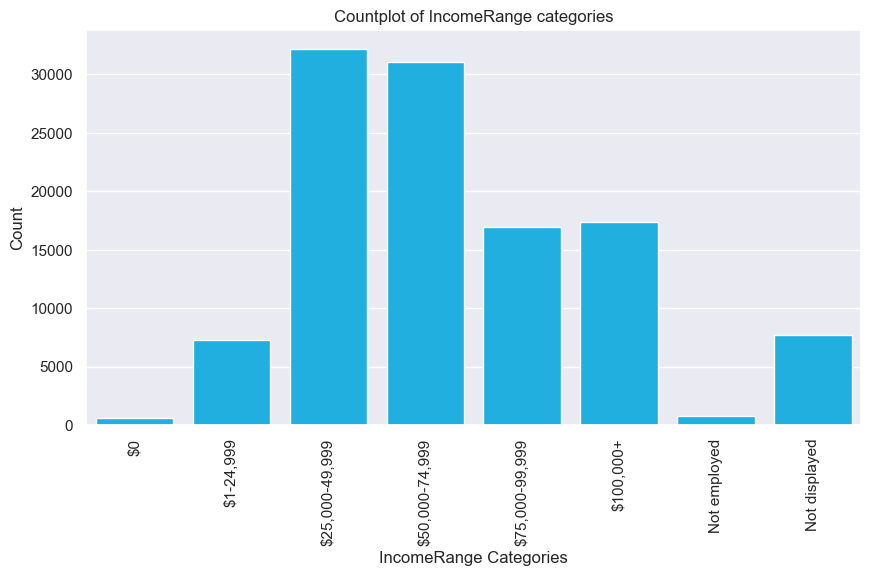

In [107]:
# Lest look into IncomeRange and see which income range gets most loans?

# The income range from 25K-75K gets the highest number of loans. The range from 75K to 100K+ gets the second highest loan numbers.
# Very few people with 0 income or no employment get a loan.

plt.figure(figsize=(10,5))
plt.subplots_adjust(top = 0.8, bottom=0.01, hspace=0.2, wspace=0.2) #control gap between subplots

grid = sns.countplot(data=dfc[dfc['IncomeRange'].notna()], x='IncomeRange', color='deepskyblue')
grid.tick_params(axis='x') #, labelrotation=90
grid.set_title('Countplot of IncomeRange categories')
grid.set(xlabel='IncomeRange Categories', ylabel='Count');
grid.tick_params(axis='x', labelrotation=90);

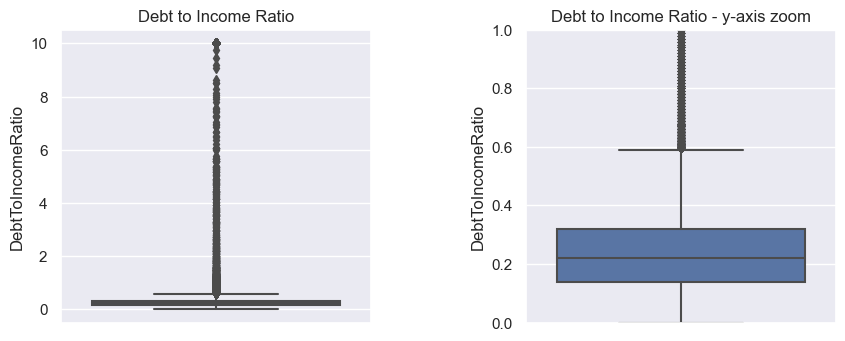

In [104]:
# What is the distribution of DebtToIncomeRatio?

# 75% of loans given have an DebtToIncome Ratio less than 0.33. With a mean value of about 0.23.
# Fewer people are have a debt to income ratio higher than 1/3!

plt.figure(figsize=(10,10))
plt.subplots_adjust(top = 0.8, bottom=0.01, hspace=0.7, wspace=0.5)

ax1=plt.subplot(2,2,1)
grid = sns.boxplot(data=dfc, y='DebtToIncomeRatio')
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('Debt to Income Ratio')
grid.set(xlabel='', ylabel='DebtToIncomeRatio');

# zoomed in plot
ax2=plt.subplot(2,2,2)
grid = sns.boxplot(data=dfc, y='DebtToIncomeRatio')
grid.set_ylim([0,1]) #zoom at the y-axis
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('Debt to Income Ratio - y-axis zoom')
grid.set(xlabel='', ylabel='DebtToIncomeRatio');

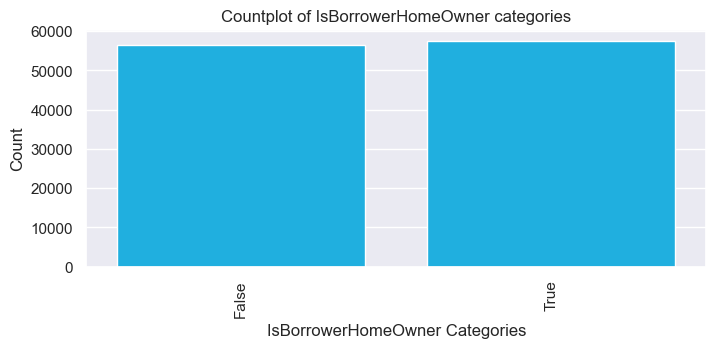

In [105]:
# How does home ownership distribution looks like in the dataset?

# We have about a 50/50 split in home ownership.
# This variable does not seem to have a strong influence on who gets a loan!

plt.figure(figsize=(8,3))
plt.subplots_adjust(top = 0.8, bottom=0.01, hspace=0.2, wspace=0.2) #control gap between subplots

grid = sns.countplot(data=dfc, x='IsBorrowerHomeowner', color='deepskyblue')
grid.set_title('Countplot of IsBorrowerHomeOwner categories')
grid.set(xlabel='IsBorrowerHomeOwner Categories', ylabel='Count');
grid.tick_params(axis='x', labelrotation=90);

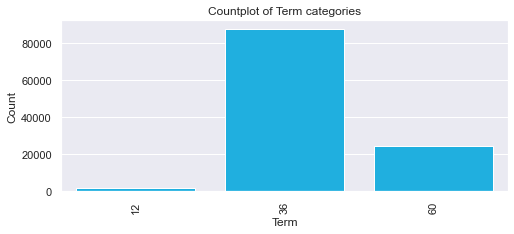

In [134]:
# Lest look into Term and see which Terms are most popular?

# The 36 months Term is the mos popular type of Loan, followed by the 60 months Term Loan, then a finally a small presence of 12 months Term Loan.

plt.figure(figsize=(8,3))
plt.subplots_adjust(top = 0.8, bottom=0.01, hspace=0.2, wspace=0.2) #control gap between subplots

grid = sns.countplot(data=dfc[dfc['Term'].notna()], x='Term', color='deepskyblue')

grid.set_title('Countplot of Term categories')
grid.set(xlabel='Term', ylabel='Count');
grid.tick_params(axis='x', labelrotation=90);

### Discuss the distribution(s) of your variable(s) of interest. Were there any unusual points? Did you need to perform any transformations?

**Timeline Variations**
- Data is split into two data sets; one for post Jul 2009 and one for pre Jul 2009.
- The two data sets have some difference such the presence of new data variables introduced in post Jul 2009 data, that warrants treating them differently in the analysis phase.
- Would the two different periods (pre Jul 2009 and post Jul 2009) show different trends for Lender Yield and Estimated Return?

**Loan Categories**
- Post Jul 2009 had 19 loan Categories, whereas pre Jul 2009 had 6 categories.
- Debt Concolidation by far has the highest number of loans assigned, followed by a smaller Home Improvement and Business. Pre Jul 2009 data had most loans assigned to Not Available Categories. So, looks like post Jul 2009 data had received tracking and data collection improvements by capturing loan categories that were not available in the pre Jul 2009 data.
- Home Improvement and Business were the second highest categories, but much lower volumes compared to Debt Consolidation.
- Do Loan Categories influence LenderYield and EstimatedReturn?

**Lender Yield**
- Lender Yield exhibited Bimodal Histogram distribution, where one bell is centered around 0.15 and the second bell centered around 0.25, with the presence of a very large abnormal peak at about 0.3
- The very large peak at 0.3 is present in the post Jul 2009 data set only! indicating either a new loan category or some change to LenderYield calculation!
- What factors in the data set may impact LenderYield?

**Estimated Return**
- Estimated Return, which calculates return minus all costs and loss estimates, takes a bell shaped normal distribution centered around 0.08, with a slight skewness to the right.
- The Estimated Return range is very narrow, where it falls betweeen the lowe bound of 0.04 to upper band of 0.18, when compared to LenderYield and EstimatedEffectiveYield, which both spread between 0.04 to 0.32. This indicates that loans with higher LenderYield are not necessarly translating into higher Returns (Profits) to lenders, probably due to EstimatedLoss being much higher for those loans.
- What factors in the data set may impact EstimatedReturn?

**Loan Amount**
- Loans from 1K-5K are the most popular loans, followed by 5K-10K, and so forth.
- Pre Jul 2009 loans under 2K were the most popular type of loans. Post Jul 2009 loans under 2K were reduced to a small number, whereas loans at higher amounts increased dramatically specifically
- 4K, 10K, and 15K where the very largest present loan amounts, followed by a large number of loans at 2K, 3K, 5K, 6K..etc, then followed by 1.5K, 2.5K, 3.5K loans. A wide spread of loans existed in between those large peaks.
- Applying a logarithmic transformation on the LoanOriginalAmount metric, we were able to spot that for the post Jul 2009 data, the frequency of larger loan amounts increases for multiplicative values of LoanOriginalAmount.
- What factors in the data set may impact Loan Amount?
- and would loan amounts impact LenderYield and EstimatedReturn?

**Prosper Rating and Credit Score**

- Pre Jul 2009 data set used one metric (CreditGrade) for assessing borrowers, whereas post Jul 2009 data dropped using CreditScore and instead replaced it with 3 scoring merics; ProsperRating, ProsperScore, and CreditScore.
- Loan amounts for ProsperRating, ProsperScore, and CreditScore exhibited a bell shaped normal distribution with slight skewness to the right. most loans had measures falling in the middle of the rating spectrum of these three metrics.
- There were loans given to users with High Risk (HR) rating!
- How do ProsperRating, ProsperScore, and CreditScore impact LenderYield and Estimated Return?

**Income Range and Debt to Income Ratio**
- The income range from 25K-75K gets the highest number of loans, followed by the range from 75K to 100K+ getting the second highest loan numbers, and then 1-25 getting the third highest loan number of loans. Other income bands including no income and no emplyment bands had very few loans.
- Does income band have impact on the LenderYield and Estimated Return?

**Home Ownership**
- There is almost a 50/50 split of home ownership status in the data, therefore, may indicate have small impact on granting loans and and returns calculations
- How much impact home ownership have on LenderYield and EstimatedReturn?

**Term**
- The 36 months Term is the mos popular type of Loan, followed by the 60 months Term Loan, then a finally a small presence of 12 months Term Loan.


### Of the features you investigated, were there any unusual distributions? Did you perform any operations on the data to tidy, adjust, or change the form of the data? If so, why did you do this?

The following were unusual distribtions:

1- The data is split into two different sets pre Jul 2009 and post Jul 2009. The two data sets have key differences, for example post Jul 2009 introduces new variables and drop others when compared to pre Jul 2009. Therefore, for many exploratory analysis and when applying statistical measures, it was necessarly to treat those two sets differently using a split dataframe dfc_new and dfc_old.

2- Loan amounts have very large peaks in between overshadowing the rest of the loan amounts distributions. Bining the data in histograms helped smoothing the data a bit. Also applying log transformation to loan amounts helped in detecting the multiplicative nature of loan amounts spread.

3- LenderYield Histogram plot exhibited a bimodal shape, however 3.0-3.2 showed the presence of an abnormal very large peak of loans at this value. This needs further investigation to understand what may be causing it!

4- ListingCategory was converted from unmerical to category names, to display meaningful values on the x-axis.

5- LoanStatus, CreditGrade, ProsperRating (Alpha), IncomeRange, and year were converted to ordered categorical variables so that plots show ordered categories for comparison purposes.

6- Converted LoanOriginalDate to a date type column, and also extracted year-month and year columns to use for plotting monthly and yearly variations. Year will also be used for segmenting data in upcoming analysis.


## Bivariate Exploration


<Figure size 1440x720 with 0 Axes>

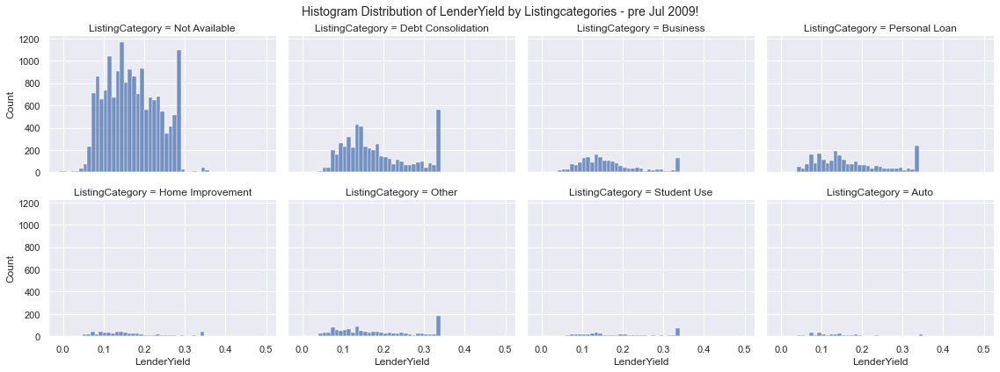

In [440]:
# Let's see how does LenderYield for pre Jul 2009 data vary according to Listing Category?

# Most distributions seems centered around the 0.15, and there is an unusual large spike around 0.34 for all Listing Categories.
# So other than volume difference, Listing Category in pre Jul 2009 data does not seem to impact LenderYield or cause changes


plt.figure(figsize = [20, 10])

sns.set(font_scale=1)
grid = sns.FacetGrid(data=dfc_old, col='ListingCategory', col_wrap=4, margin_titles=True, height=3, aspect= 1.33) # control facitgrid graph widths: margin_titles=True, height=3, aspect= 1.33
grid.map(sns.histplot, 'LenderYield', binwidth=0.01); # remove binwidth if you want auto generated different bin widths for each plot.
grid.fig.subplots_adjust(top=0.9)
grid.fig.suptitle('Histogram Distribution of LenderYield by Listingcategories - pre Jul 2009!', fontsize=14);

<Figure size 1440x720 with 0 Axes>

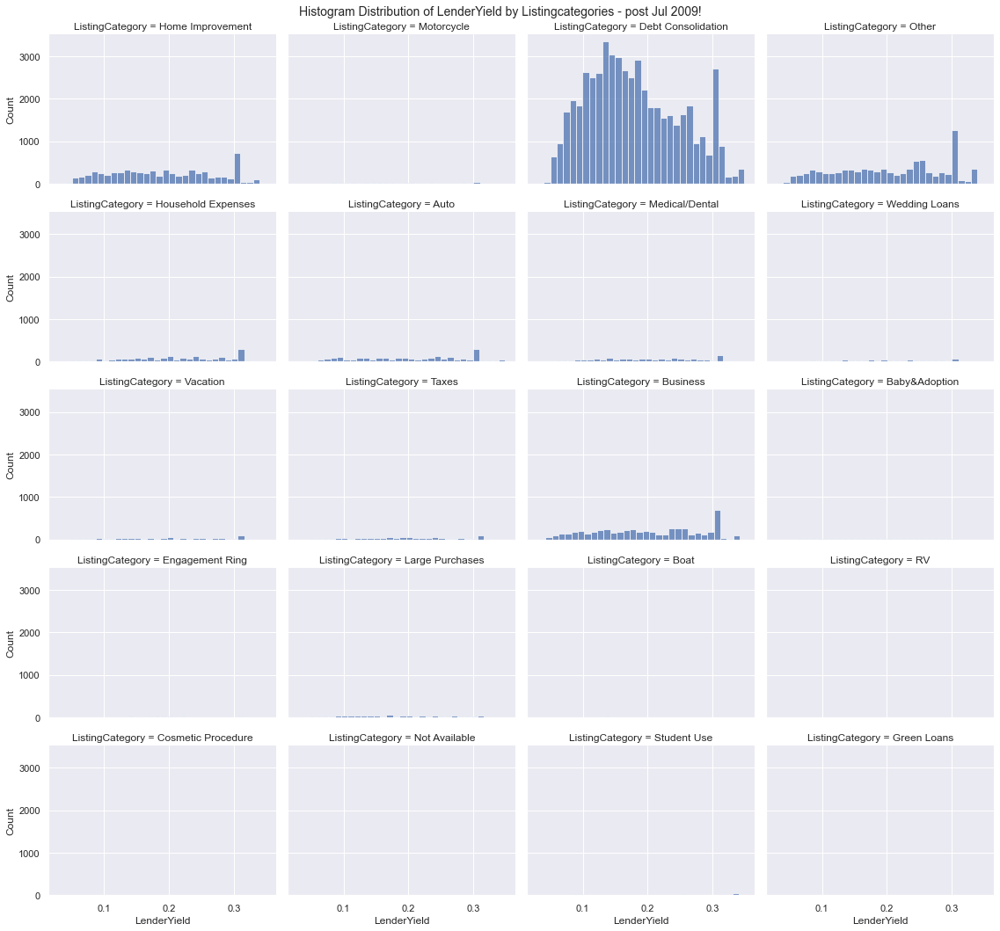

In [444]:
# How does LenderYield for post Jul 2009 vary according to Listing Category?

# Business and Home Improvement the distribution ditributions are flatter, and a bit a random shape in post Jul 2009 data when compared to pre Jul 2009 
# data, where the data takes a bell shape.

# Also, the post Jul 2009 data shows the oustanding large peak at 0.3, whilest pre Jul 2009 data appears at about 0.34!

# still listing category does not seem to change LenderYield in any predicatable or noticable trend.

plt.figure(figsize = [20, 10])

sns.set(font_scale=1) # change plots individual title size.
grid = sns.FacetGrid(data=dfc_new, col='ListingCategory', col_wrap=4, margin_titles=True, height=3, aspect= 1.33)# control facitgrid graph widths: margin_titles=True, height=3, aspect= 1.33
grid.map(sns.histplot, 'LenderYield', binwidth=0.01); # remove binwidth if you want auto generated different bin widths for each plot.
grid.fig.subplots_adjust(top=0.95)
grid.fig.suptitle('Histogram Distribution of LenderYield by Listingcategories - post Jul 2009!', fontsize=14);

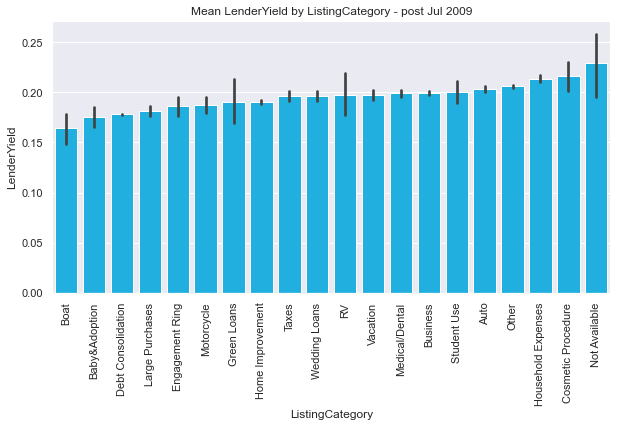

In [159]:
# let's look at the mean LenderYield distribution for all categories:
# dfc_new.groupby('ListingCategory')['LenderYield'].mean().sort_values() #.index

# Debt Consolidationhas being the most popular loan type, seems to have the third lowest LenderYields in average. 

plt.figure(figsize=(10,5))

grid = sns.barplot(data=dfc_new, x='ListingCategory', y='LenderYield', estimator=np.mean, order=dfc_new.groupby('ListingCategory')['LenderYield'].mean().sort_values().index, color='deepskyblue')
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('Mean LenderYield by ListingCategory - post Jul 2009')
grid.set(xlabel='ListingCategory', ylabel='LenderYield');




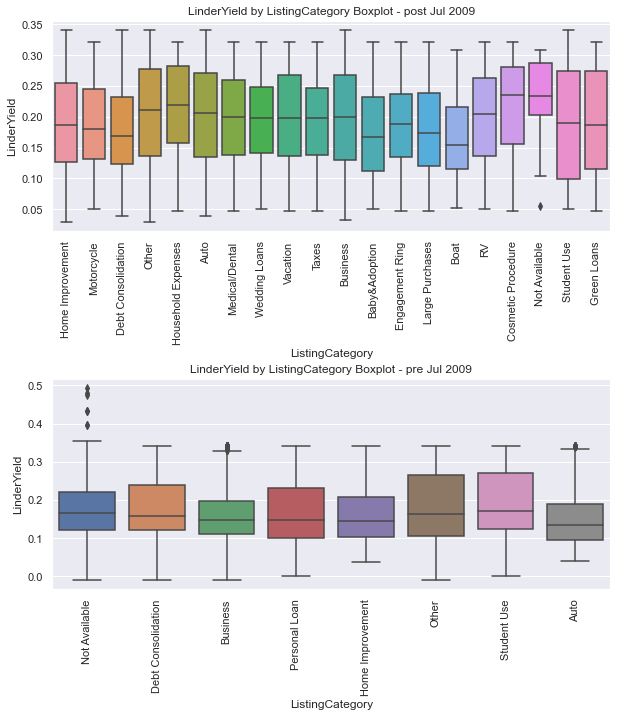

In [217]:
# lets check the distribution of of LinderYield for loans ListingCategories

# Distributions seem similar, with the median value it is centered around pushing up or down the scale. Some distributions are a bit narrower or wider than others.
# Ignoring "Other", Student User, Green Loans, and Business seem to have some of the widest spread of values.

plt.figure(figsize=(10,10))
plt.subplots_adjust(top = 0.8, bottom=0.01, hspace=0.7, wspace=0.2) #control gap between subplots
sns.set_theme() #deafult theme

ax1=plt.subplot(2,1,1)
grid = sns.boxplot(data=dfc_new, y='LenderYield', x='ListingCategory')
#grid.set_ylim([0,2])
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('LinderYield by ListingCategory Boxplot - post Jul 2009')
grid.set(xlabel='ListingCategory', ylabel='LinderYield');

ax1=plt.subplot(2,1,2)
grid = sns.boxplot(data=dfc_old, y='LenderYield', x='ListingCategory')
#grid.set_ylim([0,2])
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('LinderYield by ListingCategory Boxplot - pre Jul 2009')
grid.set(xlabel='ListingCategory', ylabel='LinderYield');

# grid = sns.stripplot(data=dfc, y='DebtToIncomeRatio', x='IncomeRange')

<Figure size 1440x720 with 0 Axes>

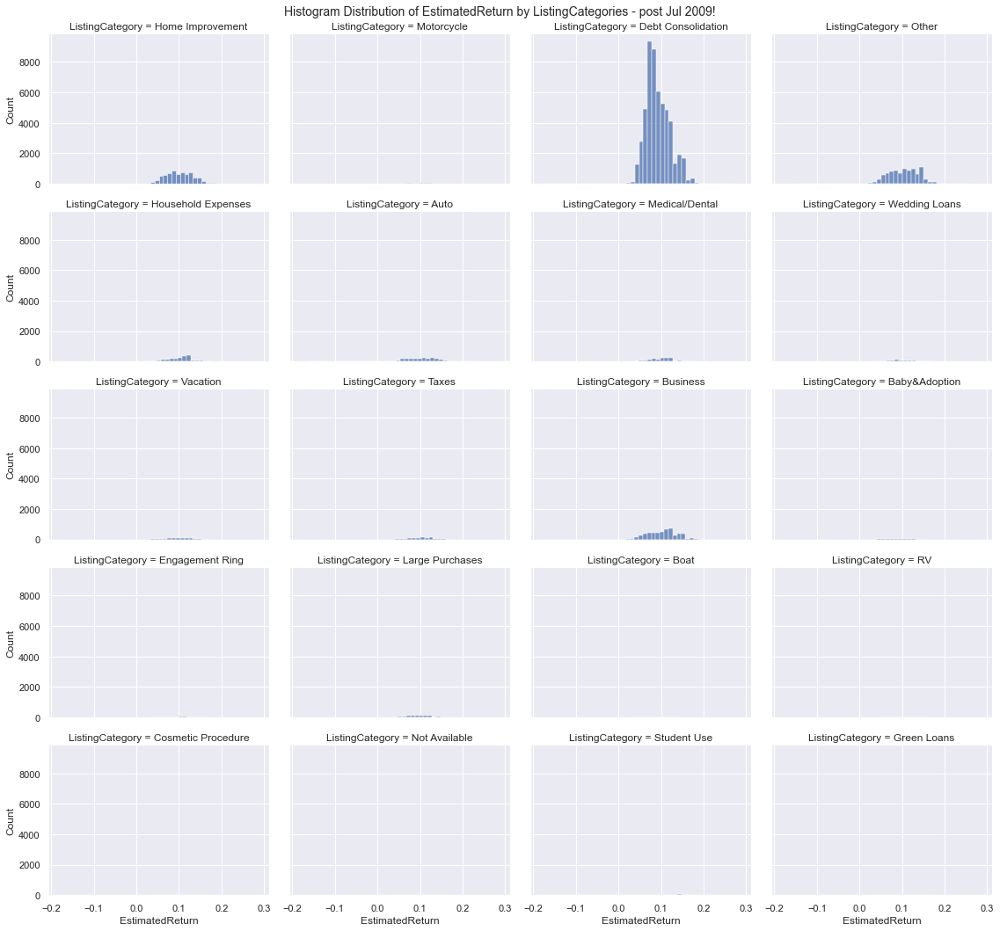

In [220]:
# How does EstimatedReturn for post Jul 2009 data vary according to Listing Category?
# this information is not available for pre Jul 2009

# We can see for all categories the EstimatedReturn is nearly centered around the 0.1 and is spread between approx. 0.5-1.5 and is less than the LenderYield
# above. The spread of values is much narrower and is less than 0.2 despite LenderYield has spread between approx. 0.5 to 3.5.
# Therefore for all listing categories the return on loans does not seem to be affected by categories, and won't increase in the same magnitude as lenderYield.

plt.figure(figsize = [20, 10])
sns.set(font_scale=1)

grid = sns.FacetGrid(data=dfc_new, col='ListingCategory', col_wrap=4, margin_titles=True, height=3, aspect= 1.33) # control facitgrid graph widths: margin_titles=True, height=3, aspect= 1.33
grid.map(sns.histplot, 'EstimatedReturn', binwidth=0.01); # remove binwidth if you want auto generated different bin widths for each plot.
grid.fig.subplots_adjust(top=0.95)
grid.fig.suptitle('Histogram Distribution of EstimatedReturn by ListingCategories - post Jul 2009!', fontsize=14);

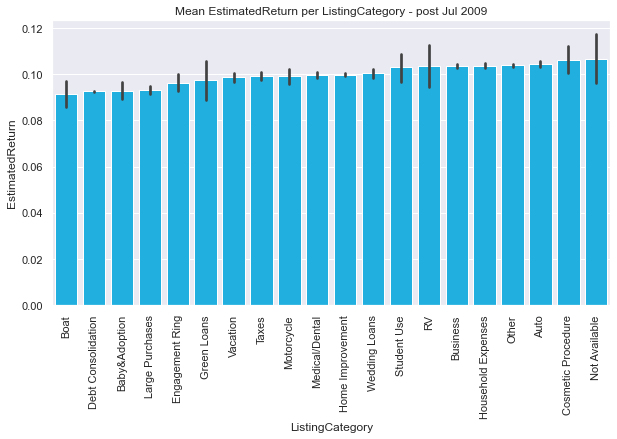

In [213]:
# let's look at the mean LenderYield distribution for all categories:
# dfc_new.groupby('ListingCategory')['LenderYield'].mean().sort_values() #.index

# Debt Consolidationhas being the most popular loan type, seems to have the third lowest LenderYields in average. 
# Error bars are likely to be influnced by the size of data availble in each Listing category

plt.figure(figsize=(10,5))
sns.set_theme() #go back to default

grid = sns.barplot(data=dfc_new, x='ListingCategory', y='EstimatedReturn', estimator=np.mean, order=dfc_new.groupby('ListingCategory')['EstimatedReturn'].mean().sort_values().index, color='deepskyblue')
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('Mean EstimatedReturn per ListingCategory - post Jul 2009')
grid.set(xlabel='ListingCategory', ylabel='EstimatedReturn')
plt.subplots_adjust(top = 0.8, bottom=0.01, hspace=0.7, wspace=0.5);



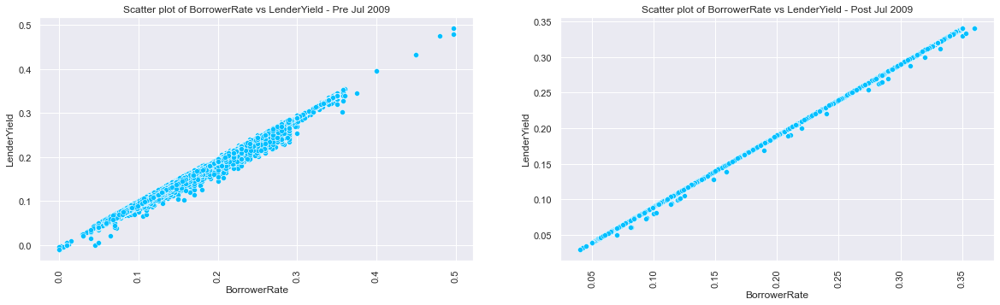

In [275]:
# Let's insepct BorrowerRate vs LenderYield (pre and post Jul 2009) and BorrowerRate vs Estimated Return (only available in post Jul 2009)
# so we can try to understand how borrower rate translates to LenderYield then to EstimatedReturn to Lenders.

# The plot shows that there is a near perfect direct linear relationship between BorrowerRate and LenderYield post Jul 2009, which makes sense. 
# For pre Jul 2009 data, it is a bit less perfect, showing some level of closely lined up bandings, 
# why does LenderYiled in pre Jul 2009 have multiple layers, does it include calcualtions of other factors such as cost?

plt.figure(figsize = [20, 5])
plt.subplots_adjust(top = 0.8, bottom=0.01, hspace=0.7, wspace=0.2) #control gap between subplots

plt.subplot(1, 2, 1)

grid = sns.scatterplot(data=dfc_old[dfc_old['BorrowerRate'].notna()], x='BorrowerRate', y='LenderYield', color='deepskyblue')
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('Scatter plot of BorrowerRate vs LenderYield - Pre Jul 2009')
grid.set(xlabel='BorrowerRate', ylabel='LenderYield');

plt.subplot(1, 2, 2)

grid = sns.scatterplot(data=dfc_new[dfc_new['BorrowerRate'].notna()], x='BorrowerRate', y='LenderYield', color='deepskyblue')
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('Scatter plot of BorrowerRate vs LenderYield - Post Jul 2009')
grid.set(xlabel='BorrowerRate', ylabel='LenderYield');



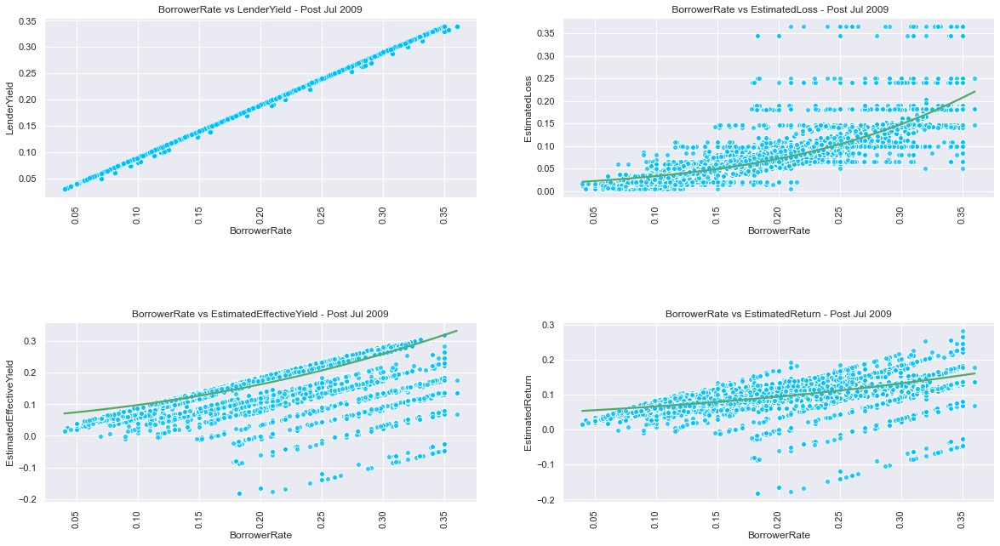

In [278]:
# Let's insepct BorrowerRate vs LenderYield, EstimatedLoss, EstimatedEffectiveYield, and  EstimatedReturn which are only available in post Jul 2009.
# so we can try to understand how BorrowerRate translates to LenderYield and then to EstimatedReturn.

# The plot shows that there is a near perfect direct linear relationship between BorrowerRate and LenderYield post Jul 2009, which makes sense. 
# The BorrowerRate vs EstimatedLoss, EstimatedEffectiveYield, and  EstimatedReturn show the presence of two types of swarm of data:
# one swarm of data is split into clearly layered bands that seem to correlated to a fixed EstimatedLoss and don't change with BorrowerRate!
# A second swarm of data exhibits a linear relationship between BorrowerRate and EstimatedLoss.
# Those swarms/bands of data are indicative of other variables/factors impacting the duo relationship. To be investigated further in the Multi variate Explorations.

# One key observation to take away is that the EstimatedLoss plot shows that as EstimatedLoss increases, BorrowerRate increases sharply in direct positive manner!

plt.figure(figsize = [20, 10])
plt.subplots_adjust(top = 0.8, bottom=0.01, hspace=0.7, wspace=0.2) #control gap between subplots

plt.subplot(2, 2, 1)

grid = sns.scatterplot(data=dfc_new[dfc_new['BorrowerRate'].notna()], x='BorrowerRate', y='LenderYield', color='deepskyblue')
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('BorrowerRate vs LenderYield - Post Jul 2009')
grid.set(xlabel='BorrowerRate', ylabel='LenderYield');

plt.subplot(2, 2, 2)

grid = sns.regplot(data=dfc_new[dfc_new['BorrowerRate'].notna()], x='BorrowerRate', y='EstimatedLoss',
                        line_kws={'color': 'g'}, scatter_kws={'color': 'deepskyblue','edgecolor':'white'}, fit_reg=True, ci=68, logistic=True);
grid.tick_params(axis='x', labelrotation=90)
grid.set_title(' BorrowerRate vs EstimatedLoss - Post Jul 2009')
grid.set(xlabel='BorrowerRate', ylabel='EstimatedLoss');

plt.subplot(2, 2, 3)

grid = sns.regplot(data=dfc_new[dfc_new['BorrowerRate'].notna()], x='BorrowerRate', y='EstimatedEffectiveYield',
                   line_kws={'color': 'g'}, scatter_kws={'color': 'deepskyblue','edgecolor':'white'}, fit_reg=True, ci=68, logistic=True);

grid.tick_params(axis='x', labelrotation=90)
grid.set_title('BorrowerRate vs EstimatedEffectiveYield - Post Jul 2009')
grid.set(xlabel='BorrowerRate', ylabel='EstimatedEffectiveYield');

plt.subplot(2, 2, 4)

grid = sns.regplot(data=dfc_new[dfc_new['BorrowerRate'].notna()], x='BorrowerRate', y='EstimatedReturn',
                   line_kws={'color': 'g'}, scatter_kws={'color': 'deepskyblue','edgecolor':'white'}, fit_reg=True, ci=68, logistic=True);

grid.tick_params(axis='x', labelrotation=90)
grid.set_title('BorrowerRate vs EstimatedReturn - Post Jul 2009')
grid.set(xlabel='BorrowerRate', ylabel='EstimatedReturn');



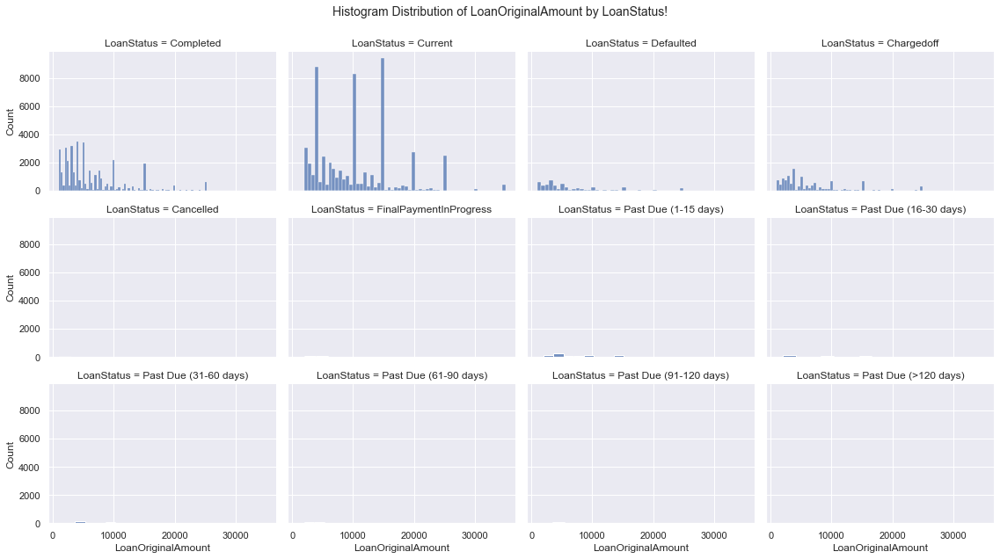

In [733]:
# let's see if splitting LoanOriginalAmount by LoanStatus show any sub relationsships:

# The graph seems to suggest that the there are no Past Due loans. But this may be due to scaling effect of very low volumes. needs another count test in the next cell.
# The most current loan amounts are 15K, 4K, and 10K.

#sns.displot(dfc, x='LoanOriginalAmount', row='LoanStatus')
grid = sns.FacetGrid(data = dfc, col = 'LoanStatus', col_wrap=4, margin_titles=True, height=3, aspect= 1.33)
grid.map(sns.histplot, 'LoanOriginalAmount');
grid.fig.subplots_adjust(top=0.9)
grid.fig.suptitle('Histogram Distribution of LoanOriginalAmount by LoanStatus!', fontsize=14);

In [130]:
# let's check a table sum of the LoanStatuses.
# Past Due columns have loans present, but due the volumes being quite low, graph above did not show them clearly.

dfc.groupby(['LoanStatus'])['ListingKey'].agg([('count',lambda x: np.count_nonzero(x)),('percent',lambda x: 100*np.count_nonzero(x)/len(dfc))]).reset_index()
#dfc.groupby(['LoanStatus'])['ListingKey'].count().apply(lambda x: x/len(dfc))
#np.count_nonzero([np.nan,1,2]) # => 3
#np.count_nonzero([0,1,2]) #=> 2

,LoanStatus,count,percent
0,Completed,38074,33.416713
1,Current,56576,49.655511
2,Defaulted,5018,4.404188
3,Chargedoff,11992,10.525115
4,Cancelled,5,0.004388
5,FinalPaymentInProgress,205,0.179924
6,Past Due (1-15 days),806,0.707408
7,Past Due (16-30 days),265,0.232585
8,Past Due (31-60 days),363,0.318597
9,Past Due (61-90 days),313,0.274713


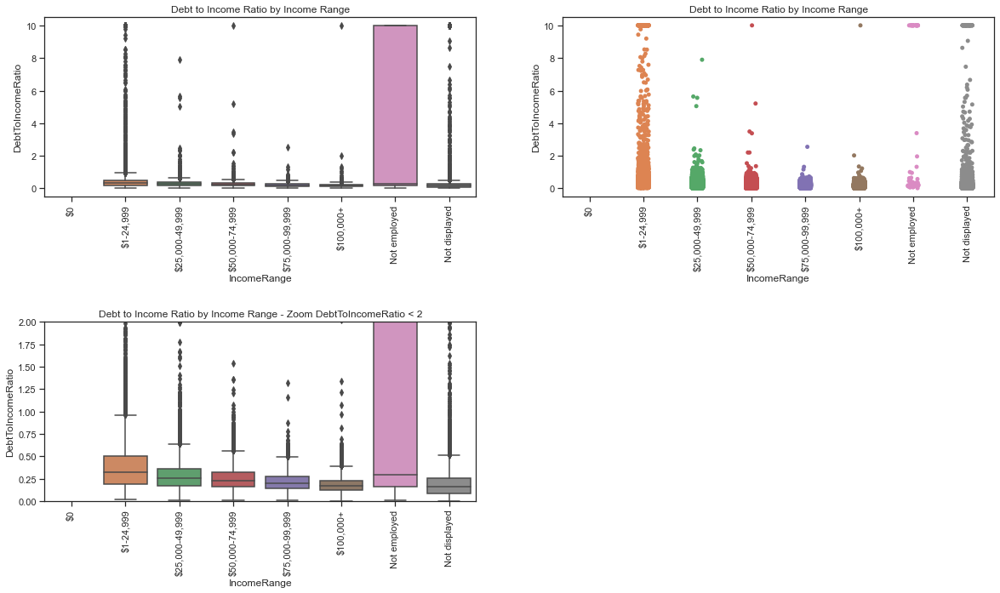

In [210]:
# how does IncomeRange vs DebtToIncomeRatio look like?

# borrowers in the 1-24,999 earning bracket are more common to take up loans with a higher fraction of their income with many having ratios higher than their income.
# The No Employment group although the smallest group, shows very high DebtToIncomeRatio compared to other groups.
# As the income bracket inceases, the DebtToIncomeRatio decreases. Is this due to borrowers of higher incoming taking smaller loans? 
# or is this observation is due to merely the math (dividing by larger value) related to the increase of their income?
# What is the average loan amount per income group?
# These feature won't be investigated further!

plt.figure(figsize=(20,10))
plt.subplots_adjust(top = 0.8, bottom=0.01, hspace=0.7, wspace=0.2) #control gap between subplots
sns.set_style("ticks")

ax1=plt.subplot(2,2,1)
grid = sns.boxplot(data=dfc, y='DebtToIncomeRatio', x='IncomeRange')
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('Debt to Income Ratio by Income Range')
grid.set(xlabel='IncomeRange', ylabel='DebtToIncomeRatio');

ax1=plt.subplot(2,2,2)
grid = sns.stripplot(data=dfc, y='DebtToIncomeRatio', x='IncomeRange')
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('Debt to Income Ratio by Income Range')
grid.set(xlabel='IncomeRange', ylabel='DebtToIncomeRatio');

ax1=plt.subplot(2,2,3)
grid = sns.boxplot(data=dfc, y='DebtToIncomeRatio', x='IncomeRange')
grid.set_ylim([0,2])
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('Debt to Income Ratio by Income Range - Zoom DebtToIncomeRatio < 2')
grid.set(xlabel='IncomeRange', ylabel='DebtToIncomeRatio');





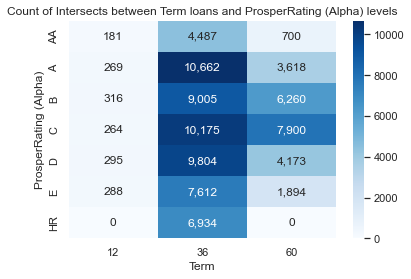

In [208]:
# What is the relationship between Terms of contract (Contract Length) and ProsperRating (Alpha)?

# We can see borrowers flaged with high risk (HR) are only awarded 36 months Term loans
# Also highest number of loans awarded are to borrowers with ProsperRating (Alpha) between A-E for 36 months Term.
# And the second highest number of loans awarded are to borrowers with ProsperRating (Alpha) between B-C for 60 months Term.

dfc_new = dfc_new.loc[:,~dfc_new.columns.duplicated()].copy()
tabular = dfc_new.pivot_table(values='MemberKey', index=['ProsperRating (Alpha)'], columns=['Term'], aggfunc='count', fill_value=0)
#tabular
grid = sns.heatmap(tabular, annot=True, cmap='Blues', fmt=',d')
grid.set_title('Count of Intersects between Term loans and ProsperRating (Alpha) levels');

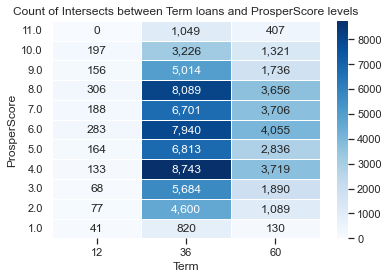

In [203]:
# What is the relationship between Term and ProsperScore?

# Contrary to ProspectRating, we can see that ProspectScore levels having loans with all the three Terms (12, 36, 60).
# But similar to ProspectRating, ProspectScore have most loans awarded for middle tier levels.

tabular = dfc_new.pivot_table(values='MemberKey', index=['ProsperScore'], columns=['Term'], aggfunc='count', fill_value=0)
tabular
grid = sns.heatmap(tabular, annot=True, cmap='Blues', fmt=',d', linewidth=.5) 
grid.set_title('Count of Intersects between Term loans and ProsperScore levels')
grid.set(xlabel="Term", ylabel="ProsperScore")
grid.xaxis.tick_bottom();
grid.invert_yaxis();


<__array_function__ internals>:180: RuntimeWarning: Converting input from bool to <class 'numpy.uint8'> for compatibility.
<__array_function__ internals>:180: RuntimeWarning: Converting input from bool to <class 'numpy.uint8'> for compatibility.


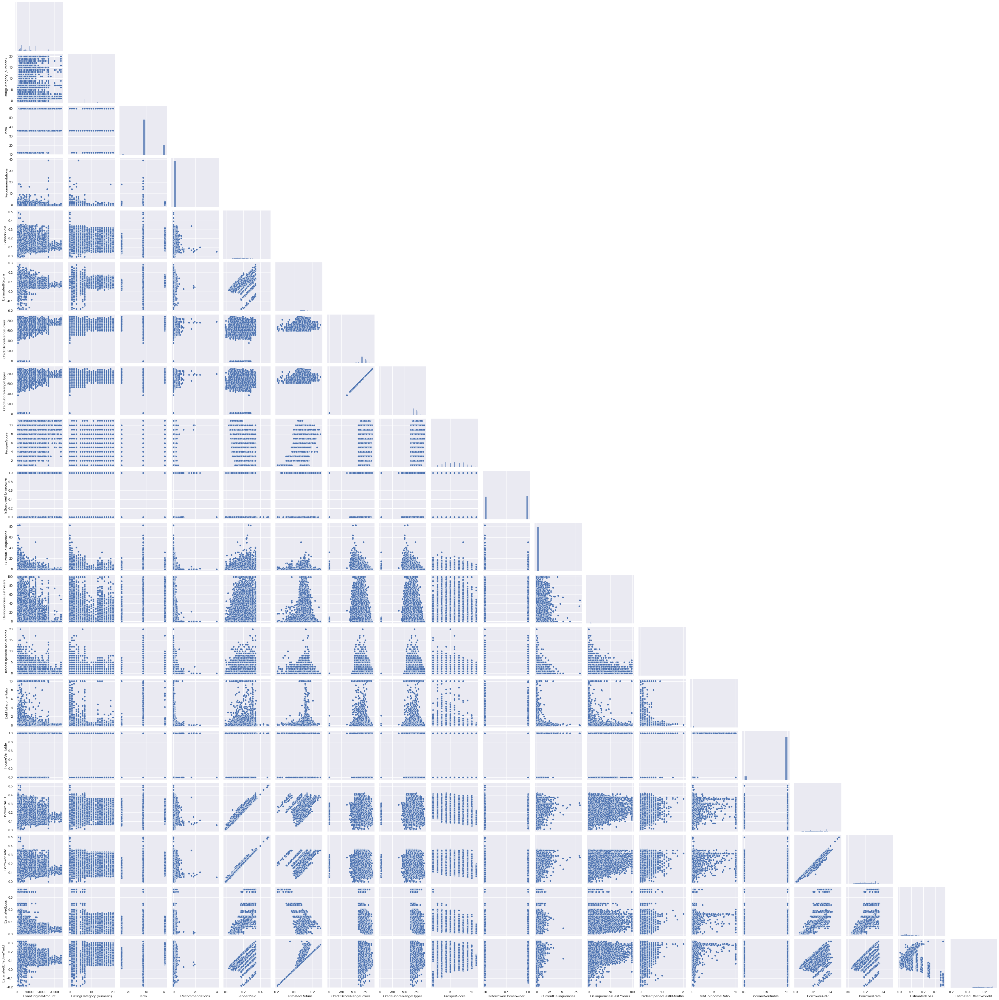

In [732]:
# Instead of checking pairs of data hoping to stumble upon meaningful relationships
# let's plot multiple pairwise bivariate distributions in the dataset to quickly glean hidden relationships between those pairs of variables.

# Relationships can be spotted between BorrowerRate vs LenderYield, BorrowerRate vs EstimatedReturn, BorrowerRate vs BorrowerAPR, 
# Estimated Return vs LenderYield, BorrowerAPR vs vs LenderYield, CreditScoreRatingUpper vs CreditScoreRatingLower, 
# borrowerRate vs EstimatedLoss, LenderYield vs Estimated Loss, and Estimated Return vs EstimatedEffectiveYield.
# a number of plots show the presence of bands of data points, indicating third variables affecting the duo relationship.

sns.pairplot(dfc, diag_kind="hist", corner=True);

### Talk about some of the relationships you observed in this part of the investigation. How did the feature(s) of interest vary with other features in the dataset?

A number of bivariate investigations were carried out on the dataset:

- The LenderYield was analyised for the different loan ListingCategories. ListingCategories showed different average levels for LenderYield. Also, the data set showed some categories to be the most domenant type of categories for loans such as Debt Consolidation, Home Improvement and Business. It would be interesting to see how these vary according to period (pre/post Jul 2009) in a multivariate explorations.
- the EstimatedReturn was analyised or the different loan ListingCategories. Again, different ListingCateogries showed different average levels. The order of EstimatedReturn did not follow the same order as the LenderYield. Which indicates that some Listing categories are more profitable than others. It would be intesting 
- given that BorrowerRate underpins all other rate metrics, a BorrowerRate vs LenderYiled and BorrowerRte vs EstimatedReturn was ploted for pre and post Jul 2009 datasets, where it was found that BorrowerRate translates to LenderYiled in a stright linear fashion as would be expected, but interestingly it was found that BorrowerRate translates to EstimatedReturn through different bands of linear stright relationships, suggeting an underlying third variables reponsible for those different levels, which will be investigated further in the next section (multivariate analysis).
- LoanStatus vs LoanOriginalAmount was analysed, but was not a useful one. It is worth noting that the most current loan amounts are 15K, 4K, and 10K, which have much larger count than any other loan amount noticable by the very large peaks in the plot. Charged off loans distribution shows loans across the entire spectrum of loans, probably with a slight skewness towards smaller amounts keeping in mind that the loansOriginalAmount historgram is skewed to the right anyway. Further analysis can be carried out to determine this probably, but no further analysis to be carried out on these variables.
- The IncomeRange vs. DebttoIncomeRatio was analysed, which revealed that DebtToIncomeRatio decreased with increasing IncomeRange. What was noticable is that the 1-24K IncomeRange and the Not Employed are more likely to take much higher debt than their income level. No further analysis to be carried out on these variables.
- Terms of contract (Contract Length) vs ProsperRating (Alpha) was analysed which revealed that High Risk (HR) individuals were awarded 36 months term loans only. Also, it was found middle tier ProsperRatings (A-E) where the most common ProsperRating bands for loans awarded.
- Looking at Term vs. ProsperScore it was noticed that loans were awarded to all levels from 1.0 - 11.0 for all loan Terms. Similar to PrsoperRating (Alpha), middle tier PrsopecrScores received the highest number of loans.

### Did you observe any interesting relationships between the other features (not the main feature(s) of interest)?

- A  pairwise bivariate plot was plot for all variables in the dataset, which revealled more relationships between existing variables, and which further highlighted that the bandings present seem to be caused by other variables (as a third dimension) impacting those relationships. This will be further investigated in the next section.

## Multivariate Exploration


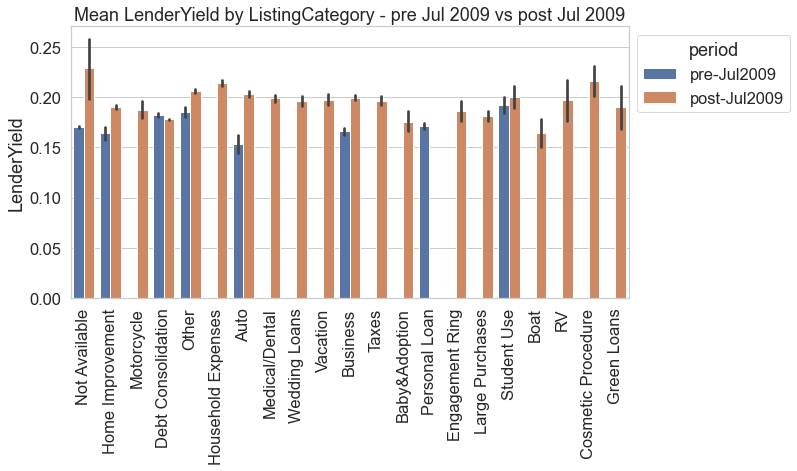

In [219]:
# let's check the average LenderYield for each category split by period pre/post Jul 2009

# post Jul 2009 data shows higher LenderYiled for the categories where there are pre and post Jul 2009 data except Debt Consolidation, where it was slightly less.

plt.figure(figsize=(10,5))
sns.set(font_scale=1.5, style="whitegrid")

grid = sns.barplot(data=dfc, x='ListingCategory', y='LenderYield', hue='period', estimator=np.mean) #np.count_nonzero # np.sum
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('Mean LenderYield by ListingCategory - pre Jul 2009 vs post Jul 2009')
grid.set(xlabel='', ylabel='LenderYield');
sns.move_legend(grid, "upper left", bbox_to_anchor=(1, 1));

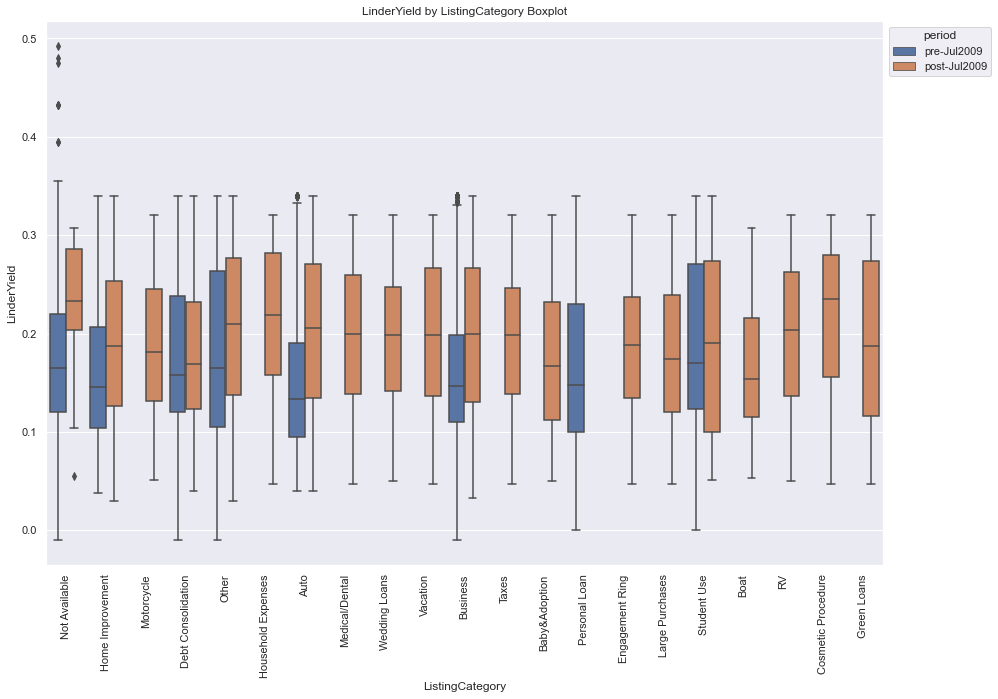

In [202]:
# lets see how LinderYield varies per category for pre and post Jul 2009 data sets in one plot

# The plot shows that that post-Jul 2009 loans have higher LinderYields compared to pre-Jul 2009 loans

plt.figure(figsize=(15,10))
sns.set_theme()
grid = sns.boxplot(data=dfc, y='LenderYield', x='ListingCategory', hue='period')
#grid.set_ylim([0,2])
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('LinderYield by ListingCategory Boxplot')
grid.set(xlabel='ListingCategory', ylabel='LinderYield');
sns.move_legend(grid, "upper left", bbox_to_anchor=(1, 1));

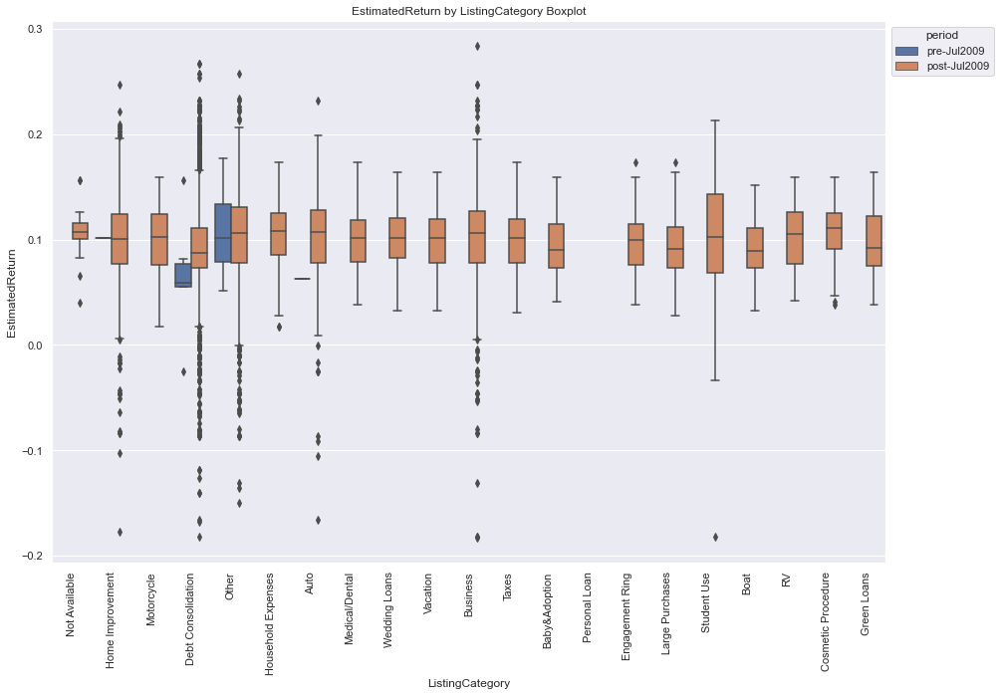

In [201]:
# lets see how EstimatedReturn varies per category for pre and post Jul 2009 data sets in one plot

# This comparison was not useful because EstimatedReturn is not present for pre-Jul2009 dataset except for odd handful outlier datapoints!

plt.figure(figsize=(15,10))
sns.set_theme()
grid = sns.boxplot(data=dfc, y='EstimatedReturn', x='ListingCategory', hue='period')
#grid.set_ylim([0,2])
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('EstimatedReturn by ListingCategory Boxplot')
grid.set(xlabel='ListingCategory', ylabel='EstimatedReturn');
sns.move_legend(grid, "upper left", bbox_to_anchor=(1, 1));

In [372]:
# proves above conclusion about pre-Jul2009 not having EstimatedReturn! and so above comparison plot did not prove to be that useful

dfc.groupby(['ListingCategory', 'period'])['LoanKey'].count()#.reset_index(name='count') #dfc['EstimatedReturn'].notnull()

ListingCategory     period      
Auto                post-Jul2009     2243
                    pre-Jul2009       329
Baby&Adoption       post-Jul2009      199
Boat                post-Jul2009       85
Business            post-Jul2009     5315
                    pre-Jul2009      1874
Cosmetic Procedure  post-Jul2009       91
Debt Consolidation  post-Jul2009    53237
                    pre-Jul2009      5071
Engagement Ring     post-Jul2009      217
Green Loans         post-Jul2009       59
Home Improvement    post-Jul2009     6810
                    pre-Jul2009       623
Household Expenses  post-Jul2009     1996
Large Purchases     post-Jul2009      876
Medical/Dental      post-Jul2009     1522
Motorcycle          post-Jul2009      304
Not Available       post-Jul2009       20
                    pre-Jul2009     16945
Other               post-Jul2009     9234
                    pre-Jul2009      1260
Personal Loan       pre-Jul2009      2395
RV                  post-Jul2009       52
S

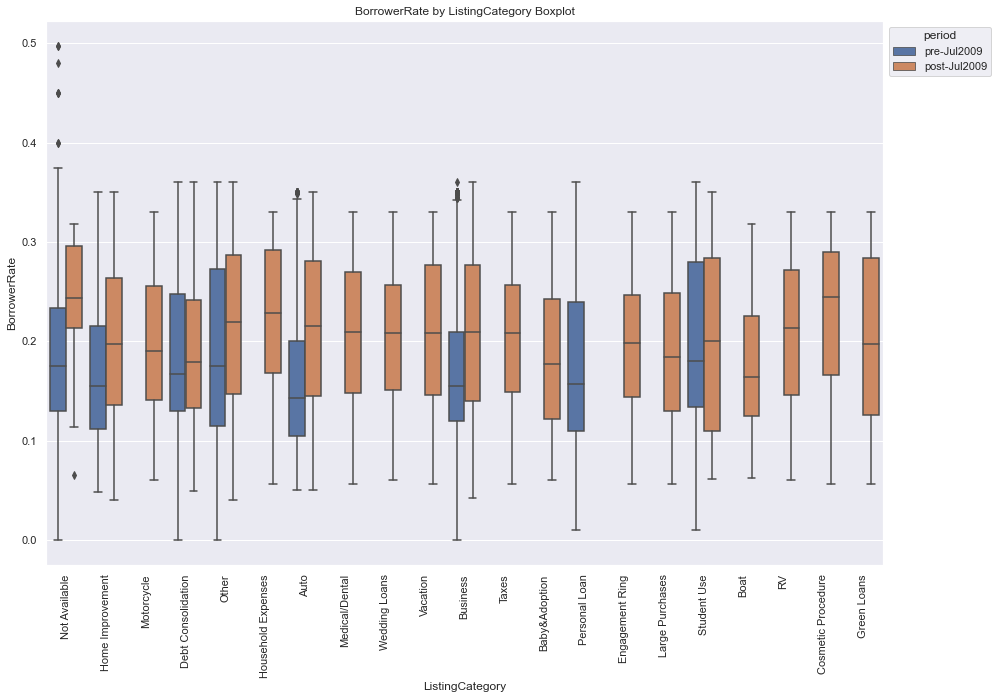

In [198]:
# lets see how BorrowerRate varies per category for pre and post Jul 2009 data sets in one plot

# The plot shows that that post-Jul 2009 loans have higher BorrowerRate compared to pre-Jul 2009 loans. Which marries up with LenderYield trends plotted above.

plt.figure(figsize=(15,10))
grid = sns.boxplot(data=dfc, y='BorrowerRate', x='ListingCategory', hue='period')
#grid.set_ylim([0,2])
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('BorrowerRate by ListingCategory Boxplot')
grid.set(xlabel='ListingCategory', ylabel='BorrowerRate');
sns.move_legend(grid, "upper left", bbox_to_anchor=(1, 1));

<Figure size 1440x720 with 0 Axes>

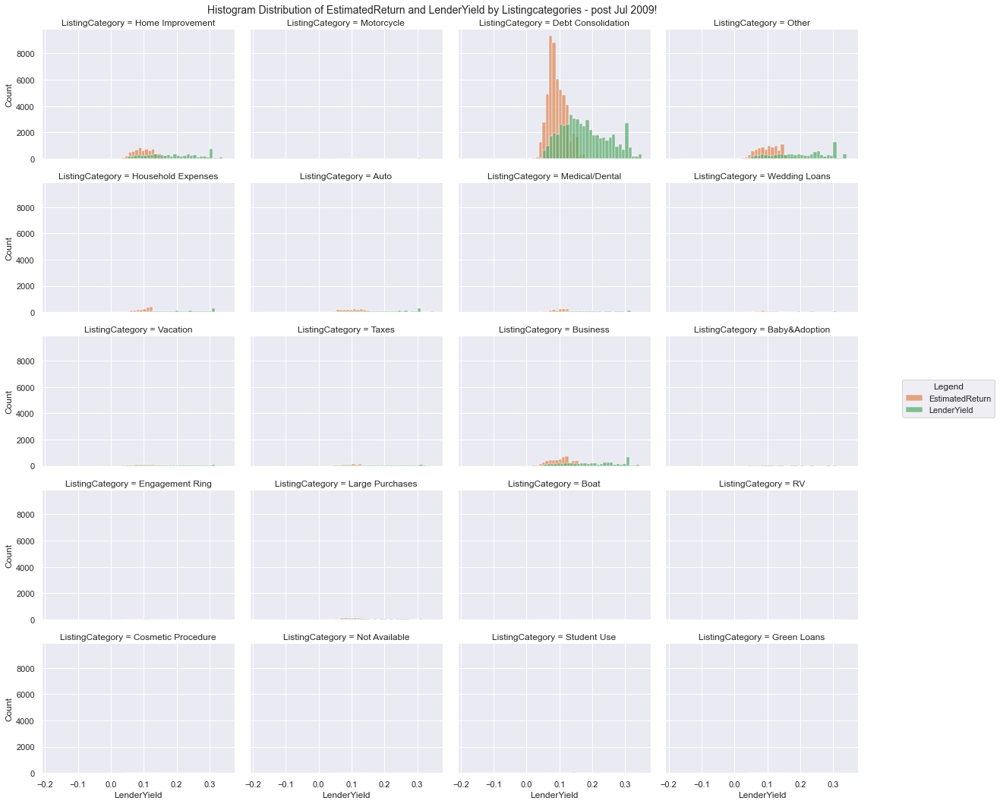

In [370]:
# How does EstimatedReturn and LenderYield distribution relate to each other for post Jul 2009 data vary according to Listing Category?
# this information is not available for pre Jul 2009

# We can see for all categories the EstimatedReturn is nearly centered around the 0.1 except for Debt Consolidation which is centered around 0.08.
# The plot shows that overall EstimatedReturn values are less than LenderYield values.
# Also, the spread of EstimatedReturn (0.02-1.8) is much narrower than LenderYield (0.05-0.36)


plt.figure(figsize = [20, 10])

palette = sns.color_palette("deep", 3)
sns.set(font_scale=1)
# plt.subplots_adjust(top = 0.5, bottom=0.01, hspace=.5, wspace=0.2) #control gap between subplots
grid = sns.FacetGrid(data=dfc_new, col='ListingCategory', col_wrap=4, margin_titles=True, height=3, aspect= 1.33)
line1 = grid.map(sns.histplot, 'EstimatedReturn', binwidth=0.01, color=palette[1], alpha = 0.7, label='EstimatedReturn'); # remove binwidth if you want auto generated different bin widths for each plot.
line2 = grid.map(sns.histplot, 'LenderYield', binwidth=0.01, color=palette[2], alpha=0.7, label='LenderYield');
grid.fig.subplots_adjust(top=0.95)
grid.fig.suptitle('Histogram Distribution of EstimatedReturn and LenderYield by Listingcategories - post Jul 2009!', fontsize=14);

handles, labels = grid.fig.gca().get_legend_handles_labels()
grid.fig.legend(handles=handles,labels=labels, title='Legend', loc='center right', bbox_to_anchor=(1.15, 0.5)); # add a facetgrid legend for the different grid.map plots.


<Figure size 1440x720 with 0 Axes>

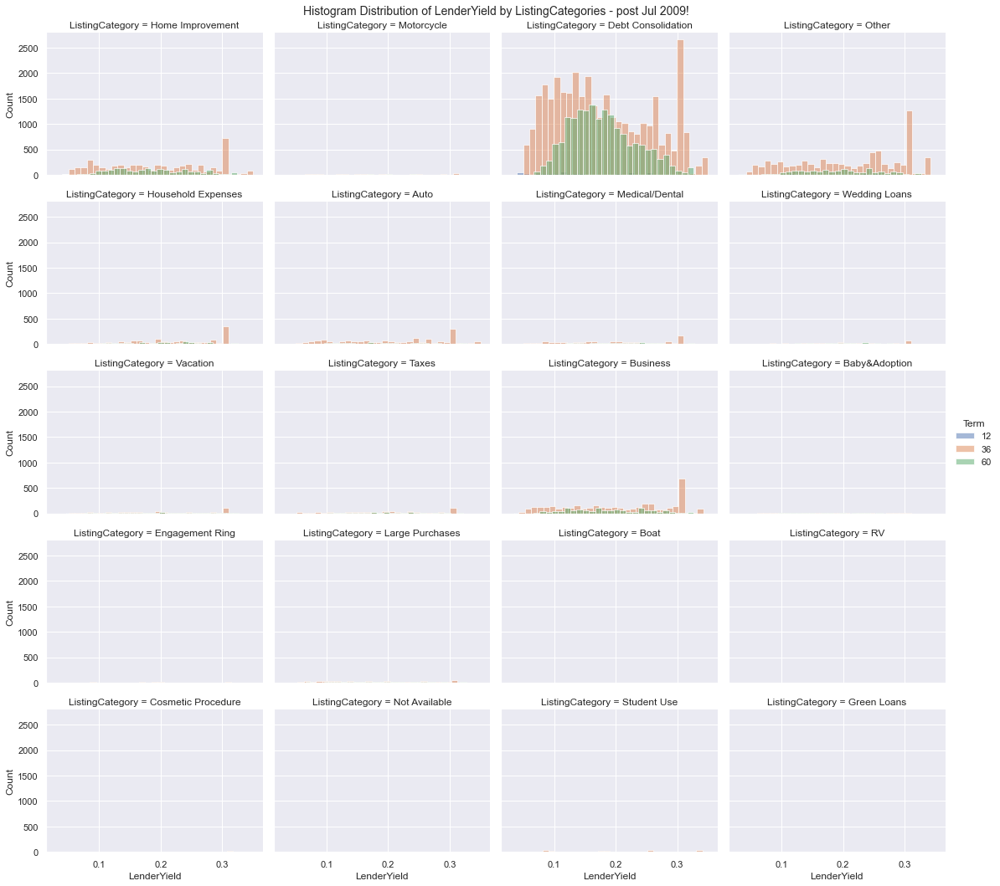

In [394]:
# How does Lender Yield for post Jul 2009 vary according to Listing Category and Term?

# This plot confirm previous univariate analysis showing 36 months the domenant Term in the data. Also, it confirm that this is trend is present in all categories.
# Also, This plot shows that LenderYield is different for different Terms.
# Looking at the Debt Consolidation Listing Category, the 60 months Term Loans seem more normally distributed with a bell peak occuring around approx 0.16, 
# Whereas the 36 months Loans have a stronger skewness to the right with the bell peak occuring around 0.13 and an unusual large peak of loans at around 0.3
# Also the 36 months Term Loans are more popular than the 12 months or the 60 months Term. the 12 months Term are the least popular and are hardly noticed in the plot.
# From this plot we can tell the large peak is associated with the 36 months Terms contract. but what for?

plt.figure(figsize = [20, 10])
# plt.subplots_adjust(top = 0.5, bottom=0.01, hspace=.5, wspace=0.2) #control gap between subplots
sns.set(font_scale=1) # change plots individual title size.
grid = sns.FacetGrid(data=dfc_new, col='ListingCategory', hue='Term', col_wrap=4, margin_titles=True, height=3, aspect= 1.33) # control facitgrid graph widths: margin_titles=True, height=3, aspect= 1.33
grid.map(sns.histplot, 'LenderYield', binwidth=0.01, alpha=0.5); # remove binwidth if you want auto generated different bin widths for each plot.
grid.fig.subplots_adjust(top=0.95)
grid.fig.suptitle('Histogram Distribution of LenderYield by ListingCategories - post Jul 2009!', fontsize=14);
grid.add_legend();


In [391]:
grouped = dfc.groupby(['period','ListingCategory'])['ListingKey'].count().reset_index().rename(columns={'ListingKey':'count'})
grouped['subTotal']=grouped.groupby(['period'])['count'].transform('sum')
grouped['percent'] = 100 * grouped['count']/grouped['subTotal']


pd.options.display.float_format = '{:.2f}'.format # does not affect number precision, but display only.
pd.reset_option('display.max_rows')
grouped#.sort_values(by='ListingCategory')#.head(30)

,period,ListingCategory,count,subTotal,percent
0,post-Jul2009,Auto,2243,84964,2.64
1,post-Jul2009,Baby&Adoption,199,84964,0.23
2,post-Jul2009,Boat,85,84964,0.10
3,post-Jul2009,Business,5315,84964,6.26
4,post-Jul2009,Cosmetic Procedure,91,84964,0.11
5,post-Jul2009,Debt Consolidation,53237,84964,62.66
6,post-Jul2009,Engagement Ring,217,84964,0.26
7,post-Jul2009,Green Loans,59,84964,0.07
8,post-Jul2009,Home Improvement,6810,84964,8.02
9,post-Jul2009,Household Expenses,1996,84964,2.35


<Figure size 1440x720 with 0 Axes>

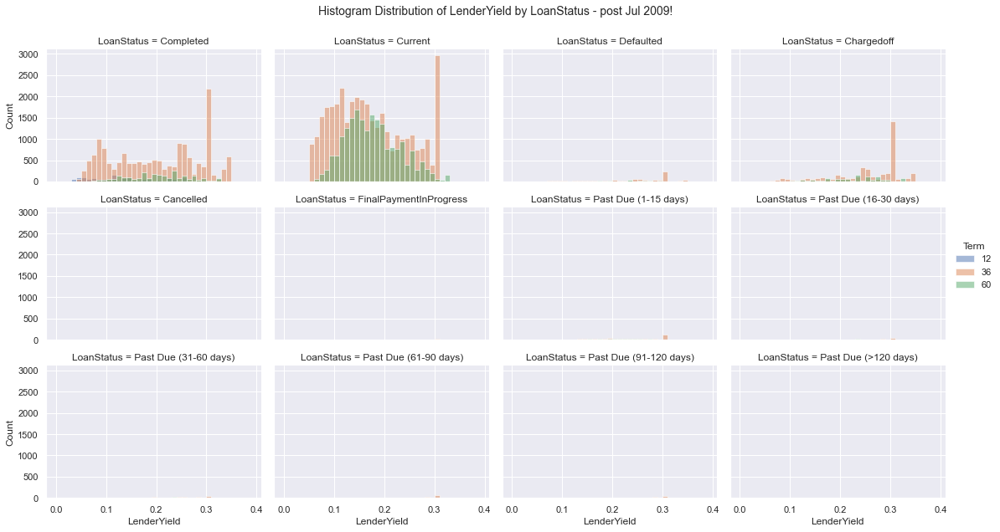

In [395]:
# How does LenderYield for post Jul 2009 vary according to LoanStatus and Term?

# We can see that current loans have the highest loans in the dataset, followed by completed status.
# Chargedoff have the 3rd highest presence in the dataset, whilest the Past Due Date have much lower number of loans.
# We still can see the high peak at around 0.3 present across all LoanStatus categories. So, it is not influenced by loanStatus. what is it related to, then?

bins = np.arange(0,0.4,0.01)
plt.figure(figsize = [20, 10])

sns.set(font_scale=1) # change plots individual title size.

grid = sns.FacetGrid(data=dfc_new, col='LoanStatus', hue='Term', col_wrap=4, margin_titles=True, height=3, aspect= 1.33)# control facitgrid graph widths: margin_titles=True, height=3, aspect= 1.33
grid.map(sns.histplot, 'LenderYield', bins=bins, alpha=0.5); # remove binwidth if you want auto generated different bin widths for each plot.
grid.fig.subplots_adjust(top=0.9)
grid.fig.suptitle('Histogram Distribution of LenderYield by LoanStatus - post Jul 2009!', fontsize=14);
grid.add_legend();



<Figure size 1440x720 with 0 Axes>

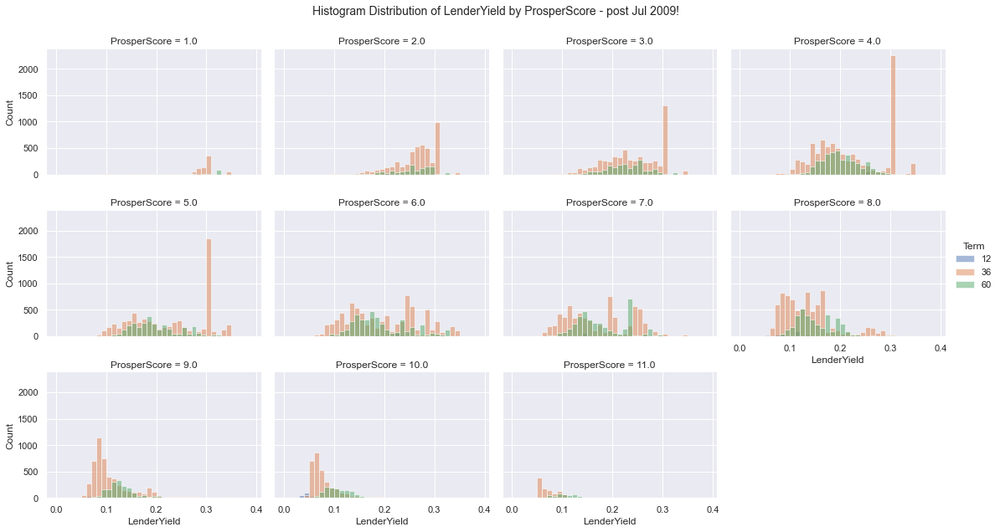

In [392]:
# How does LenderYield for post Jul 2009 vary according to ProsperScore and Term?

# We can see that the peak at 0.3 is present mainly in ProsperScore 1, 2, 3, 4, 5. 
# This suggests that it is associated with lower score borrowers. 
# How is this reflected in other borrower rating/scoring variables. 

bins = np.arange(0,0.4,0.01)
plt.figure(figsize = [20, 10])
# plt.subplots_adjust(top = 0.5, bottom=0.01, hspace=.5, wspace=0.2) #control gap between subplots
sns.set(font_scale=1) # change plots individual title size.
grid = sns.FacetGrid(data=dfc_new, col='ProsperScore', hue='Term', col_wrap=4, margin_titles=True, height=3, aspect= 1.33)# control facitgrid graph widths: margin_titles=True, height=3, aspect= 1.33
grid.map(sns.histplot, 'LenderYield', bins=bins, alpha=0.5); # remove binwidth if you want auto generated different bin widths for each plot.
grid.fig.subplots_adjust(top=0.9)
grid.fig.suptitle('Histogram Distribution of LenderYield by ProsperScore - post Jul 2009!', fontsize=14);
grid.add_legend();

<Figure size 1440x720 with 0 Axes>

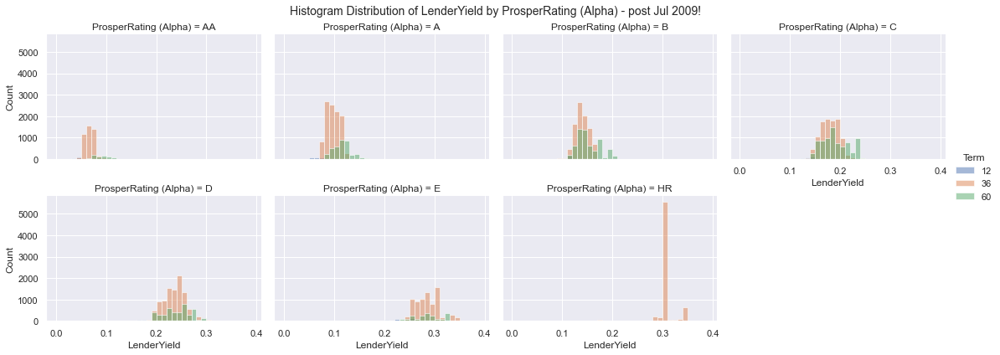

In [396]:
# How does LenderYield for post Jul 2009 vary according to ProsperRating (Alpha) and Term?

# The plots here revealed that the 0.3 high peak is very strongly associated with loans given to individuals who are identified High Risk (HR) and to a smaller degree to level E.
# Also, this plots shows that ProsperRating (Alpha) have a very strong influence on LenderYiled levels, where LenderYield increases as the ProsperRating (Alpha) decreases

bins = np.arange(0,0.4,0.01)
plt.figure(figsize = [20, 10])
# plt.subplots_adjust(top = 0.5, bottom=0.01, hspace=.5, wspace=0.2) #control gap between subplots
sns.set(font_scale=1) # change plots individual title size.
grid = sns.FacetGrid(data=dfc_new, col='ProsperRating (Alpha)', hue='Term', col_wrap=4, margin_titles=True, height=3, aspect= 1.33)# control facitgrid graph widths: margin_titles=True, height=3, aspect= 1.33
grid.map(sns.histplot, 'LenderYield', bins=bins, alpha=0.5); # remove binwidth if you want auto generated different bin widths for each plot.
grid.fig.subplots_adjust(top=0.9)
grid.fig.suptitle('Histogram Distribution of LenderYield by ProsperRating (Alpha) - post Jul 2009!', fontsize=14);
grid.add_legend();

<Figure size 1440x720 with 0 Axes>

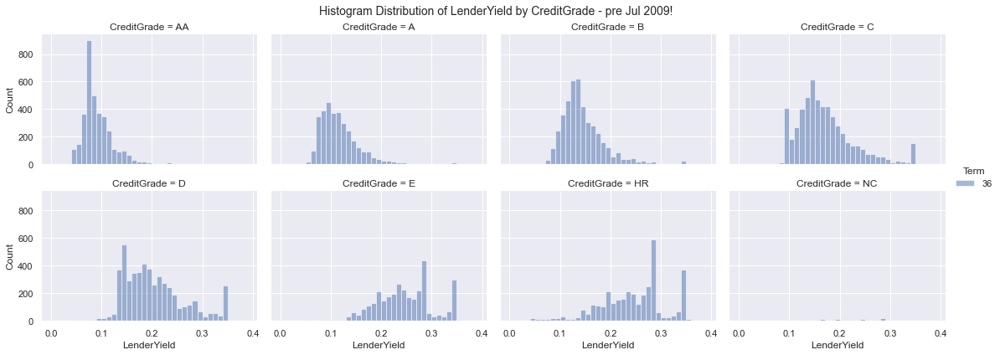

In [397]:
# Given our finding above, How does LenderYield for pre Jul 2009 vary according to CreditGrade and Term? 
# CreditGrade is for pre Jul 2009 which is similar to ProsperRating (Alpha)for post Jul 2009

# There seems to be only one Term (36 months) present in the pre Jul 2009 data.
# The plot shows that LenderYield increased on the x-axis (Histogram shift from left skewed to right skewed) as CreditGrade decreased going from AA to HR.
# The plots show that for pre Jul 2009 loans, there are two peaks; one at around 0.34-0.35 and another at around 0.28 which are present in the lower CreditGrades and HR individuals loans
# What could be causing those two peaks in the pre Jul 2009?

bins = np.arange(0,0.4,0.01)
plt.figure(figsize = [20, 10])
# plt.subplots_adjust(top = 0.5, bottom=0.01, hspace=.5, wspace=0.2) #control gap between subplots
sns.set(font_scale=1) # change plots individual title size.
grid = sns.FacetGrid(data=dfc_old, col='CreditGrade', hue='Term', col_wrap=4, margin_titles=True, height=3, aspect= 1.33)# control facitgrid graph widths: margin_titles=True, height=3, aspect= 1.33
grid.map(sns.histplot, 'LenderYield', bins=bins, alpha=0.5); # remove binwidth if you want auto generated different bin widths for each plot.
grid.fig.subplots_adjust(top=0.9)
grid.fig.suptitle('Histogram Distribution of LenderYield by CreditGrade - pre Jul 2009!', fontsize=14);
grid.add_legend();

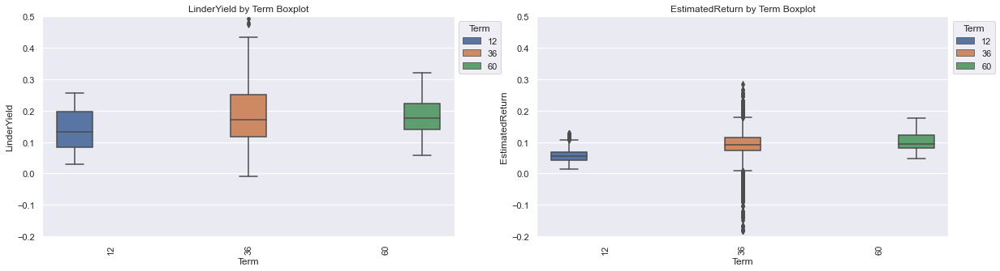

In [25]:
# lets see how LinderYield varies per category for pre and post Jul 2009 data sets in one plot

# The plot shows that that post-Jul 2009 loans have higher LinderYields compared to pre-Jul 2009 loans

plt.figure(figsize=(20,5))
# Use white grid plot background from seaborn
#sns.set(font_scale=1.2, style="ticks")
# sns.set_theme() # reset to default

plt.subplot(1, 2, 1)
grid = sns.boxplot(data=dfc, y='LenderYield', x='Term', hue='Term')
grid.set_ylim([-0.2,0.5])
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('LinderYield by Term Boxplot')
grid.set(xlabel='Term', ylabel='LinderYield');
sns.move_legend(grid, "upper left", bbox_to_anchor=(1, 1));

plt.subplot(1, 2, 2)
grid = sns.boxplot(data=dfc, y='EstimatedReturn', x='Term', hue='Term')
grid.set_ylim([-0.2,0.5])
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('EstimatedReturn by Term Boxplot')
grid.set(xlabel='Term', ylabel='EstimatedReturn');
sns.move_legend(grid, "upper left", bbox_to_anchor=(1, 1));

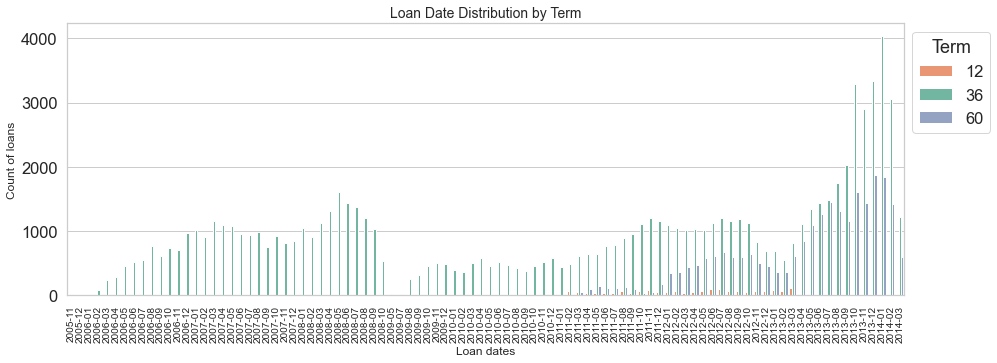

In [199]:
# let's look at the Term distribution for loans

# We can see the gap in the middle splitting the data into two periods, 
# This plot confirm the above finding, that pre Jul 2009 data has only 36 Term loans. 12 months and 60 months Term loans are introduced post Jul 2009.

plt.figure(figsize=(15,5))

# Use white grid plot background from seaborn
sns.set(font_scale=1.5, style="whitegrid")

# Create an array with the colors you want to use
colors = ['#fc8d62', '#66c2a5', '#8da0cb']
# Set your custom color palette
sns.set_palette(sns.color_palette(colors))


dfc['y_m'] = dfc['LoanDate'].dt.strftime('%Y-%m')

grid = sns.countplot(data=dfc.sort_values(by='y_m'), x='y_m', hue='Term')#, palette=palette
grid.tick_params(axis='x', labelrotation=90, labelsize=10)
grid.set_title("Loan Date Distribution by Term", fontsize=14)
grid.set_xlabel("Loan dates", fontsize=12)
grid.set_ylabel("Count of loans", fontsize=12)
sns.move_legend(grid, "upper left", bbox_to_anchor=(1, 1));

plt.show();

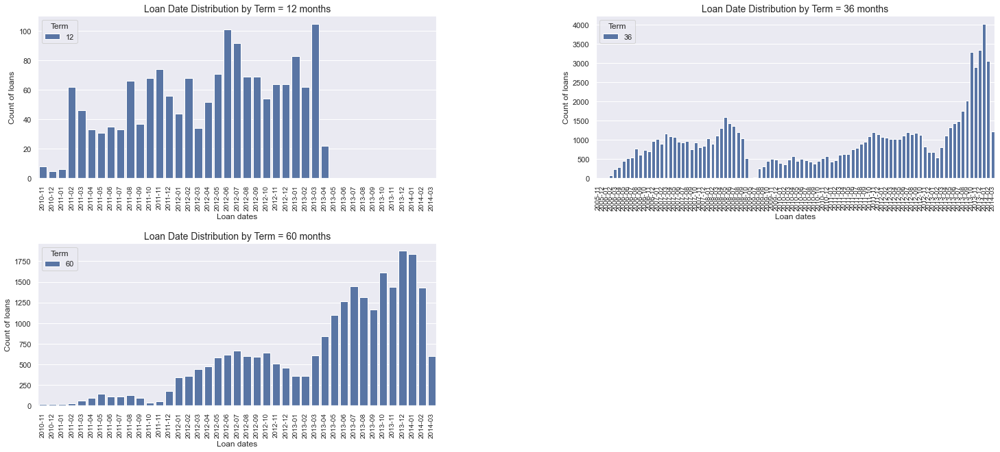

In [362]:
# # let's look further at the Term distribution for loans

# We can see that the 12 months term loans have been introduced at the same time as 60 months term loans Nov. 2010, 
# but the 12 months term loans only present in the data until in Apr. 2013
# has the 12 months term loans been discontinued? or are there missing data?

plt.figure(figsize = [25, 10])
plt.subplots_adjust(top = 0.8, bottom=0.01, hspace=0.4, wspace=0.4) #control gap between subplots
palette = sns.color_palette("deep", 3) #Paired

dfc['y_m'] = dfc['LoanDate'].dt.strftime('%Y-%m')

ax3 = plt.subplot(2, 2, 3)
grid = sns.countplot(data=dfc[dfc['Term'] == 60].sort_values(by='y_m'), x='y_m', hue='Term')#, palette=palette
grid.tick_params(axis='x', labelrotation=90, labelsize=10)
grid.set_title("Loan Date Distribution by Term = 60 months", fontsize=14)
grid.set_xlabel("Loan dates", fontsize=12)
grid.set_ylabel("Count of loans", fontsize=12)
sns.move_legend(grid, "upper left", bbox_to_anchor=(0, 1));

ax1 = plt.subplot(2, 2, 1)
grid = sns.countplot(data=dfc[dfc['Term'] == 12].sort_values(by='y_m'), x='y_m', hue='Term')#, palette=palette
grid.tick_params(axis='x', labelrotation=90, labelsize=10)
grid.set_title("Loan Date Distribution by Term = 12 months", fontsize=14)
grid.set_xlabel("Loan dates", fontsize=12)
grid.set_ylabel("Count of loans", fontsize=12)
sns.move_legend(grid, "upper left", bbox_to_anchor=(0, 1));
ax1.sharex(ax3) # make 12 and 60 plots share x-axis to show start and end points

ax2 = plt.subplot(2, 2, 2)
grid = sns.countplot(data=dfc[dfc['Term'] == 36].sort_values(by='y_m'), x='y_m', hue='Term')#, palette=palette
grid.tick_params(axis='x', labelrotation=90, labelsize=10)
grid.set_title("Loan Date Distribution by Term = 36 months", fontsize=14)
grid.set_xlabel("Loan dates", fontsize=12)
grid.set_ylabel("Count of loans", fontsize=12)
sns.move_legend(grid, "upper left", bbox_to_anchor=(0, 1));


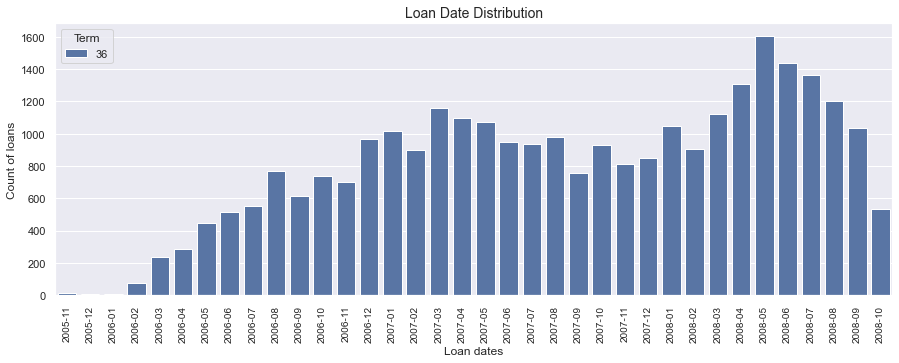

In [196]:
# let's plot the pre Jul 2009 data alone just to confirm again that it contains only 36 months loans

plt.figure(figsize=(15,5))

dfc_old['y_m'] = sorted(dfc_old['LoanDate'].map(lambda x: x.strftime('%Y-%m')))

grid = sns.countplot(data=dfc_old, x='y_m', hue='Term')
grid.tick_params(axis='x', labelrotation=90, labelsize=10)
grid.axes.set_title("Loan Date Distribution", fontsize=14)
grid.set_xlabel("Loan dates", fontsize=12)
grid.set_ylabel("Count of loans", fontsize=12)
sns.move_legend(grid, "upper left", bbox_to_anchor=(0, 1));

plt.show();

In [890]:
# obtain the colours for the above plot, so that to make 12 months loans noticable with a bright colour.

print(sns.color_palette("Set2", 3).as_hex())
sns.color_palette("Set2", 3).as_hex()

['#66c2a5', '#fc8d62', '#8da0cb']


['#66c2a5', '#fc8d62', '#8da0cb']

<Figure size 1440x720 with 0 Axes>

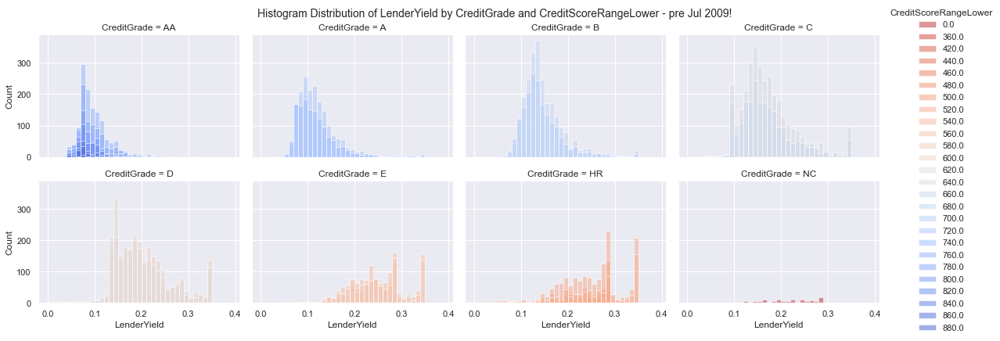

In [398]:
# Given our finding above, How does LenderYield for pre Jul 2009 vary according to CreditGrade and CreditScoreRangeLower?

# The plots shows the general trend of lower CreditScoreRangeLower values are associated with the lower CreditGrade values and visa versa, which
# cause LendeYield to increase on the x-axis when moving from the highest CreditGrade AA to the next lower one. This can be observed by observing CreditGrade
# AA having darker Blue colour bars then gradually fainting out as CreditGrade decreases, and the finally moving to stronger tones of Orange Colour as we reach the bottom
# end of the scale.
# But this plot does not explain the two peaks at 0.28 and 3.4

bins = np.arange(0,0.4,0.01)
plt.figure(figsize = [20, 10])
# plt.subplots_adjust(top = 0.5, bottom=0.01, hspace=.5, wspace=0.2) #control gap between subplots
sns.set(font_scale=1) # change plots individual title size.
palette = sns.color_palette('coolwarm_r',26) # use reverse palette to keep lower values marked with orangey/redish colour

grid = sns.FacetGrid(data=dfc_old, col='CreditGrade', hue='CreditScoreRangeLower', col_wrap=4, margin_titles=True, height=3, aspect= 1.33, palette=palette)# control facitgrid graph widths: margin_titles=True, height=3, aspect= 1.33
grid.map(sns.histplot, 'LenderYield', bins=bins, alpha=0.5); # remove binwidth if you want auto generated different bin widths for each plot.
grid.fig.subplots_adjust(top=0.9)
grid.fig.suptitle('Histogram Distribution of LenderYield by CreditGrade and CreditScoreRangeLower - pre Jul 2009!', fontsize=14);
grid.add_legend();

In [811]:
dfc_old['Term'].value_counts()

36    28940
Name: Term, dtype: int64

<Figure size 1440x720 with 0 Axes>

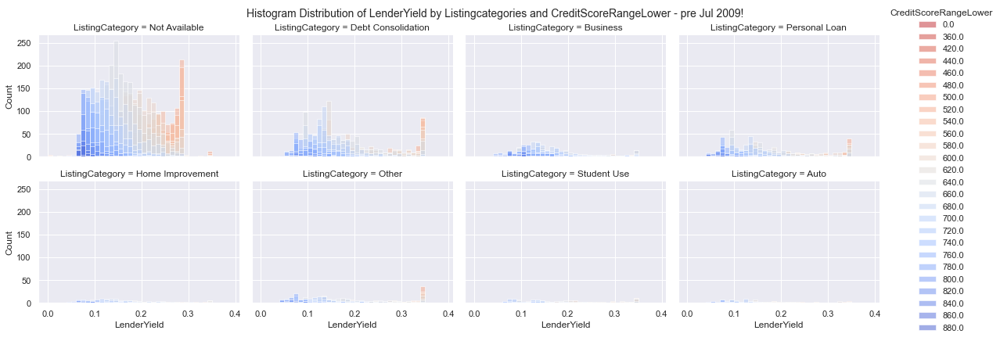

In [399]:
# Given our finding above, How does LenderYield for pre Jul 2009 vary according to LisitingCagtegory and CreditScoreRangeLower?

# The peak at 0.28 is present in the "Not Available" ListingCategory, whereas the 0.34 is present across all categories.
# The peak is present across multiple values in the bottom half of the CreditScoreRangeLower values
# We still don't have a definitive explaination for the o.28 and 0.34 peaks.
# But we can see an over all trend where the LenderYield increased as the CreditScoreRangeLower values decreased in the scale, for each category, which is
# observed in the gradual shift from darker blue on the very left hand side to darker orange on the very right hand side.

palette = sns.color_palette("coolwarm_r", 26) # use reverse palette to keep lower values marked with orangey/redish colour

bins = np.arange(0,0.4,0.01)
plt.figure(figsize = [20, 10])
# plt.subplots_adjust(top = 0.5, bottom=0.01, hspace=.5, wspace=0.2) #control gap between subplots
sns.set(font_scale=1) # change plots individual title size.
grid = sns.FacetGrid(data=dfc_old, col='ListingCategory', hue='CreditScoreRangeLower', col_wrap=4, margin_titles=True, height=3, aspect= 1.33, palette=palette)
grid.map(sns.histplot, 'LenderYield', bins=bins, alpha=0.5); # remove binwidth if you want auto generated different bin widths for each plot.
grid.fig.subplots_adjust(top=0.9)
grid.fig.suptitle('Histogram Distribution of LenderYield by Listingcategories and CreditScoreRangeLower - pre Jul 2009!', fontsize=14);
grid.add_legend();

<Figure size 1440x720 with 0 Axes>

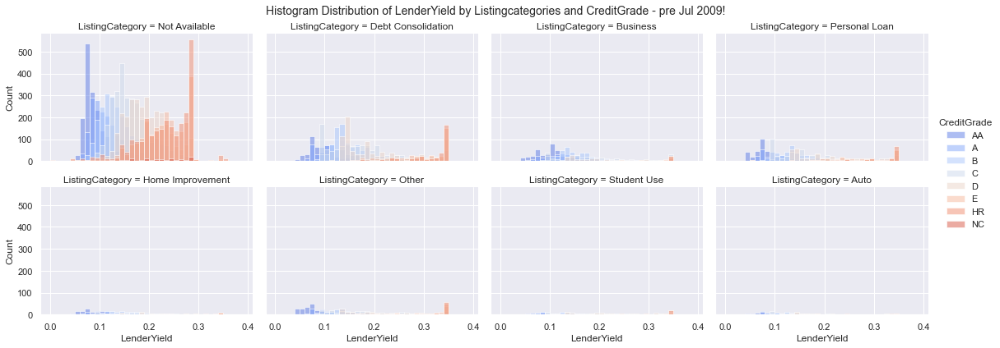

In [400]:
# Given our finding above, How does LenderYield for pre Jul 2009 vary according to ListingCategory and CreditGrade? 

# The very same trend of LenderYield increasing as CreditGrade decreased is noticable again, but we can see much greater correlation between 
# LenderYield increasing as CreditGrade decreased in the scale than CreditScoreRangeLower. This is observed in the Blue occupying the left hand side and then
# moving in the colour scale towards Orange on the right hand side. This times showing a much more segemented plot between Blue and Orange than CreditScoreRangeLower.
# The plots shows the two peaks 0.28 and 0.34 associated with the lower CreditGrade values E, HR and also NC
# We still don't have a clear cut answer as to the difference between those two peaks and what determines 0.28 and 0.34 LenderYield values for loans.
# But this is good enough for this analysis. This route will not been followed any further.

palette = sns.color_palette("coolwarm", 8) # use coolwarm palette to keep lower values marked with orangey/redish colour

bins = np.arange(0,0.4,0.01)
plt.figure(figsize = [20, 10])
# plt.subplots_adjust(top = 0.5, bottom=0.01, hspace=.5, wspace=0.2) #control gap between subplots
sns.set(font_scale=1) # change plots individual title size.
grid = sns.FacetGrid(data=dfc_old, col='ListingCategory', hue='CreditGrade', col_wrap=4, margin_titles=True, height=3, aspect= 1.33, palette = palette)# control facitgrid graph widths: margin_titles=True, height=3, aspect= 1.33
grid.map(sns.histplot, 'LenderYield', bins=bins, alpha=0.5); # remove binwidth if you want auto generated different bin widths for each plot.
grid.fig.subplots_adjust(top=0.9)
grid.fig.suptitle('Histogram Distribution of LenderYield by Listingcategories and CreditGrade - pre Jul 2009!', fontsize=14);
grid.add_legend();

In [832]:
# inspecting actual number for CreditGrade

dfc_old['CreditGrade'].value_counts()

C     5644
D     5151
B     4386
HR    3508
AA    3508
A     3313
E     3289
NC     141
Name: CreditGrade, dtype: int64

<Figure size 1440x720 with 0 Axes>

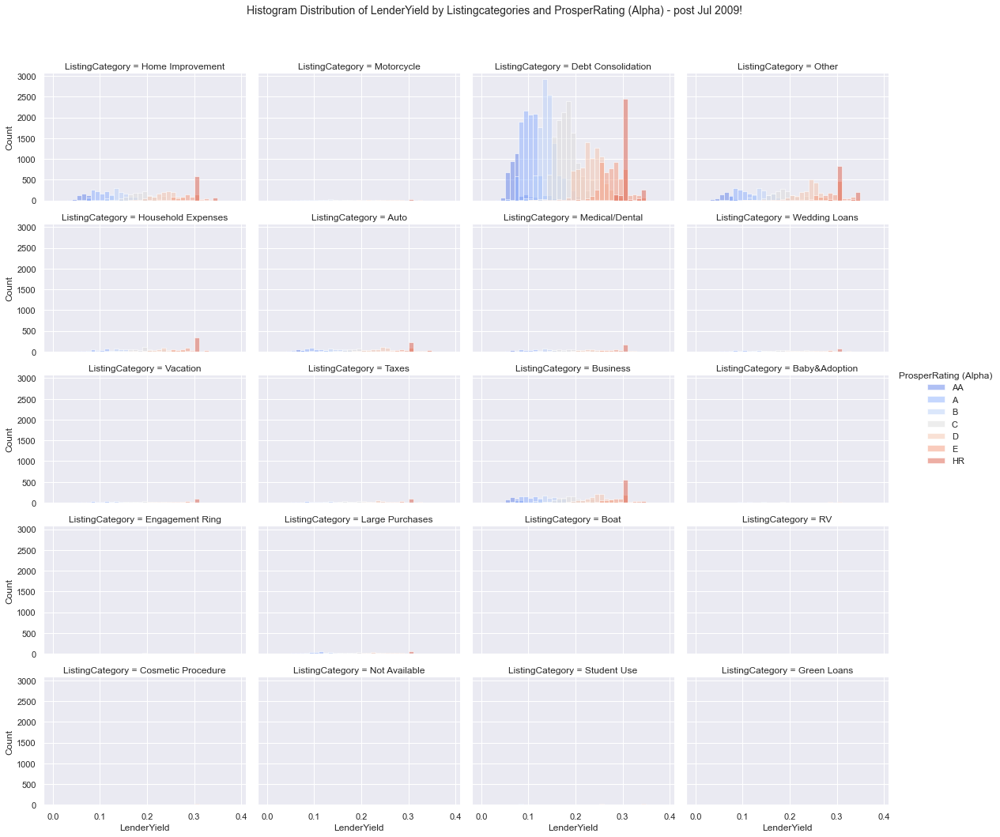

In [17]:
# Given our finding above, let's finally look at how does LenderYield for post Jul 2009 vary according to ListingCategory and 'ProsperRating (Alpha)'? 

# The very same trend of LenderYield increasing as CreditGrade or CreditScoreRangeLower decreased in pre Jul 2009 data is noticable again here. 
# LenderYield increases as ProsperRating (Alpha) decreased in the scale. This is observed in the Blue occupying the left hand side and then
# moving in the colour scale towards Orange on the right hand side. This times showing a much more segemented plot between Blue and Orange than previous plots.
# The plots shows again the peak at 0.3 associated with the lower CrediProsperRating (Alpha) rating values HR and E.


palette = sns.color_palette("coolwarm", 7) # use coolwarm palette to keep lower values marked with orangey/redish colour

bins = np.arange(0,0.4,0.01)
plt.figure(figsize = [20, 10])
# plt.subplots_adjust(top = 0.5, bottom=0.01, hspace=.5, wspace=0.2) #control gap between subplots
sns.set(font_scale=1) # change plots individual title size.
grid = sns.FacetGrid(data=dfc_new, col='ListingCategory', hue='ProsperRating (Alpha)', col_wrap=4, margin_titles=True, height=3, aspect= 1.33, palette = palette)# control facitgrid graph widths: margin_titles=True, height=3, aspect= 1.33
grid.map(sns.histplot, 'LenderYield', bins=bins, alpha=0.5); # remove binwidth if you want auto generated different bin widths for each plot.
grid.fig.subplots_adjust(top=0.9)
grid.fig.suptitle('Histogram Distribution of LenderYield by Listingcategories and ProsperRating (Alpha) - post Jul 2009!', fontsize=14);
grid.add_legend();

In [446]:
# inspecting actual number for Term

dfc['Term'].value_counts()

36    87778
60    24545
12     1614
Name: Term, dtype: int64

In [457]:
# inspecting actual number for PercentFunded

df['PercentFunded'].value_counts()

1.0000    113067
0.9998         5
0.7000         4
0.8087         4
0.7784         3
           ...  
0.8167         1
0.7854         1
0.7903         1
0.7167         1
0.9575         1
Name: PercentFunded, Length: 719, dtype: int64

In [ ]:
# What could be causing the different bands in some of the duo relationships?
# Which thrid variable is responsible for this banding?
# Those bands can be observed in the BorrowerRate vs EstimatedLoss, BorrowerRate vs EstimatedEffectiveYield, BorrowerRate vs EstimatedReturn


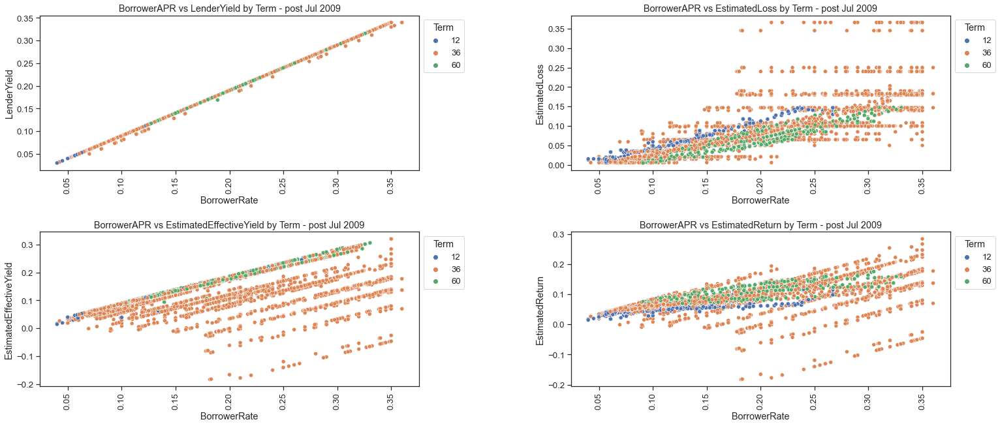

In [26]:
# The relahionship between borrowerRate and EstimateReturn, EstimatedEffectiveYield, and EstimatedLoss shows groups of data points
# What are those groups of data related to?
# lets try to segement the data by Loan Term, which may help explain the different data groupings in the plot.

# The plots shows that some of the variance observed can be explained by the loan Term, 
# The 12 and 60 months Loans have a narrow almost linear spread of points, 
# Whilest the 36 months Term loans have a wide spread with Multiple sub groups of data points.
# The 36 months loans seem to be responsible for the highest loss, and lowest EstimatedReturn and EstimatedEffectiveYield data points compared to the 12 and 60 months Term loans!
# But what are those subgroups? and what other variables can explain the reminder of the variance?

plt.figure(figsize = [25, 10])
plt.subplots_adjust(top = 0.8, bottom=0.01, hspace=0.4, wspace=0.4) #control gap between subplots
palette = sns.color_palette("deep", 3) #Paired

# Use white grid plot background from seaborn
sns.set(font_scale=1.2, style="ticks")

plt.subplot(2, 2, 1)
#dfc_new['ListingCategory'].value_counts()
grid = sns.scatterplot(data=dfc_new[dfc_new['BorrowerRate'].notna()], x='BorrowerRate', y='LenderYield', hue = 'Term', palette=palette) # , style='LoanStatus'
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('BorrowerAPR vs LenderYield by Term - post Jul 2009')
grid.set(xlabel='BorrowerRate', ylabel='LenderYield');
sns.move_legend(grid, "upper left", bbox_to_anchor=(1, 1));

plt.subplot(2, 2, 2)
#dfc_new['ListingCategory'].value_counts()
grid = sns.scatterplot(data=dfc_new[dfc_new['BorrowerRate'].notna()], x='BorrowerRate', y='EstimatedLoss', hue = 'Term', palette=palette) # , style='LoanStatus'
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('BorrowerAPR vs EstimatedLoss by Term - post Jul 2009')
grid.set(xlabel='BorrowerRate', ylabel='EstimatedLoss');
sns.move_legend(grid, "upper left", bbox_to_anchor=(1, 1));

plt.subplot(2, 2, 3)
#dfc_new['ListingCategory'].value_counts()
grid = sns.scatterplot(data=dfc_new[dfc_new['BorrowerRate'].notna()], x='BorrowerRate', y='EstimatedEffectiveYield', hue = 'Term', palette=palette)
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('BorrowerAPR vs EstimatedEffectiveYield by Term - post Jul 2009')
grid.set(xlabel='BorrowerRate', ylabel='EstimatedEffectiveYield');
sns.move_legend(grid, "upper left", bbox_to_anchor=(1, 1));

plt.subplot(2, 2, 4)
#dfc_new['ListingCategory'].value_counts()
grid = sns.scatterplot(data=dfc_new[dfc_new['BorrowerRate'].notna()], x='BorrowerRate', y='EstimatedReturn', hue = 'Term', palette=palette)
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('BorrowerAPR vs EstimatedReturn by Term - post Jul 2009')
grid.set(xlabel='BorrowerRate', ylabel='EstimatedReturn');
sns.move_legend(grid, "upper left", bbox_to_anchor=(1, 1));



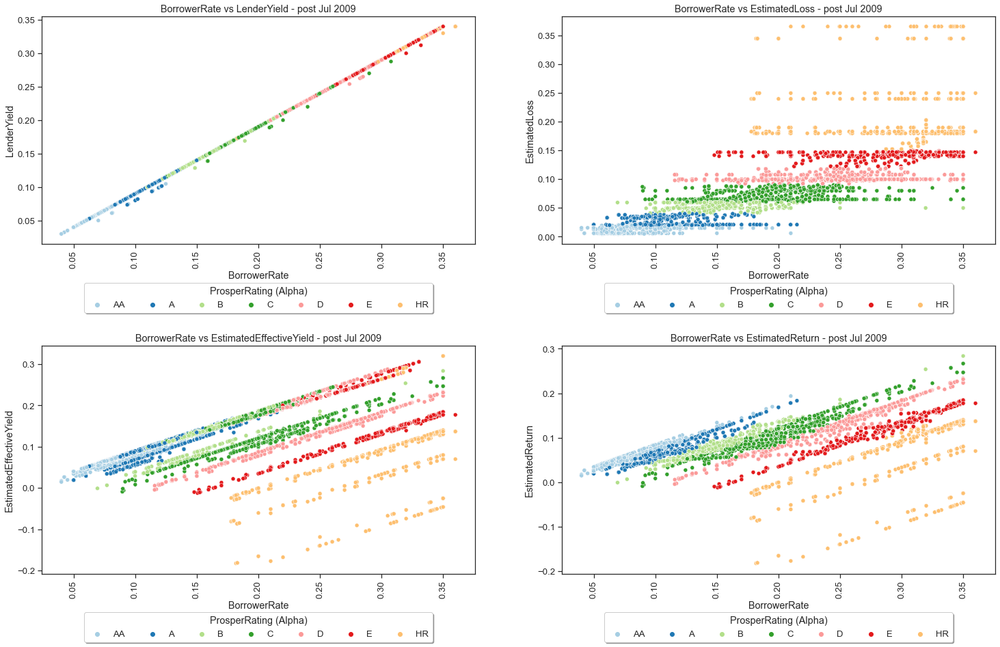

In [29]:
# The relahionship between borrowerRate and EstimateReturn, EstimatedEffectiveYield, and EstimatedLoss shows groups of data points
# What are those groups of data related to?
# lets try to segement the data by ProsperRating (Alpha), which may help explain the different data groupings in the plot too.

# The plot shows that the different ProsperRating (Alpha) ratings explain the different bands observed in our data.

# Also the plots showed that higher ProsperRating (Alpha) has lower EstimatedLoss, higher EstimatedEffectiveYield, and higher EstimatedReturn. 
# Also, As the ProsperRating (Alpha) decreased to lower ratings, the BorrowerRate and EstimatedLoss moved to higher rates, whilest EstimatedEeffectiveYield 
# and EstimatedReturn moved to lower lower rates.

# The plot still shows the presence of sub layers of groupings within those groups that manifests itself by the adjacent parrellel lines within the same colour. 
# What other variables could be contributing to the presence of those sub groups?

plt.figure(figsize = [25, 15])
plt.subplots_adjust(top = 0.8, bottom=0.01, hspace=0.3, wspace=0.2) #control gap between subplots
palette = sns.color_palette("Paired", 7)

# Use white grid plot background from seaborn
sns.set(font_scale=1.2, style="ticks")

plt.subplot(2, 2, 1)
#dfc_new['ListingCategory'].value_counts()
grid = sns.scatterplot(data=dfc_new[dfc_new['BorrowerRate'].notna()], x='BorrowerRate', y='LenderYield', hue = 'ProsperRating (Alpha)', palette=palette)
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('BorrowerRate vs LenderYield - post Jul 2009')
grid.set(xlabel='BorrowerRate', ylabel='LenderYield');

box = grid.get_position()
grid.set_position([box.x0, box.y0 + box.height * 0.1,
                 box.width, box.height * 0.9])

# Put a legend below current axis
grid.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15),
          fancybox=True, shadow=True, ncol=8, title='ProsperRating (Alpha)')

plt.subplot(2, 2, 2)
#dfc_new['ListingCategory'].value_counts()
grid = sns.scatterplot(data=dfc_new[dfc_new['BorrowerRate'].notna()], x='BorrowerRate', y='EstimatedLoss', hue = 'ProsperRating (Alpha)', palette=palette)
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('BorrowerRate vs EstimatedLoss - post Jul 2009')
grid.set(xlabel='BorrowerRate', ylabel='EstimatedLoss');

box = grid.get_position()
grid.set_position([box.x0, box.y0 + box.height * 0.1,
                 box.width, box.height * 0.9])

# Put a legend below current axis
grid.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15),
          fancybox=True, shadow=True, ncol=8, title='ProsperRating (Alpha)')

plt.subplot(2, 2, 3)
grid = sns.scatterplot(data=dfc_new[dfc_new['BorrowerRate'].notna()], x='BorrowerRate', y='EstimatedEffectiveYield', hue = 'ProsperRating (Alpha)', palette=palette)
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('BorrowerRate vs EstimatedEffectiveYield - post Jul 2009')
grid.set(xlabel='BorrowerRate', ylabel='EstimatedEffectiveYield');
box = grid.get_position()
grid.set_position([box.x0, box.y0 + box.height * 0.1,
                 box.width, box.height * 0.9])

# Put a legend below current axis
grid.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15),
          fancybox=True, shadow=True, ncol=8, title='ProsperRating (Alpha)')

plt.subplot(2, 2, 4)
grid = sns.scatterplot(data=dfc_new[dfc_new['BorrowerRate'].notna()], x='BorrowerRate', y='EstimatedReturn', hue = 'ProsperRating (Alpha)', palette=palette) 
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('BorrowerRate vs EstimatedReturn - post Jul 2009')
grid.set(xlabel='BorrowerRate', ylabel='EstimatedReturn');
box = grid.get_position()
grid.set_position([box.x0, box.y0 + box.height * 0.1,
                 box.width, box.height * 0.9])

# Put a legend below current axis
grid.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15),
          fancybox=True, shadow=True, ncol=8, title='ProsperRating (Alpha)'); # increase ncol by 1 for title to show


plt.show();


In [175]:
dfc_new.groupby(['LoanStatus'])['LoanKey'].count()#.keys()

LoanStatus
Completed                 19768
Current                   56576
Defaulted                  1007
Chargedoff                 5341
Cancelled                     0
FinalPaymentInProgress      205
Past Due (1-15 days)        806
Past Due (16-30 days)       265
Past Due (31-60 days)       363
Past Due (61-90 days)       313
Past Due (91-120 days)      304
Past Due (>120 days)         16
Name: LoanKey, dtype: int64

In [ ]:
statuses = ['Completed', 'Current', 'Defaulted', 'Chargedoff',
                  'Cancelled', 'FinalPaymentInProgress',
                  'Past Due (1-15 days)', 'Past Due (16-30 days)',
                  'Past Due (31-60 days)', 'Past Due (61-90 days)',
                  'Past Due (91-120 days)', 'Past Due (>120 days)']

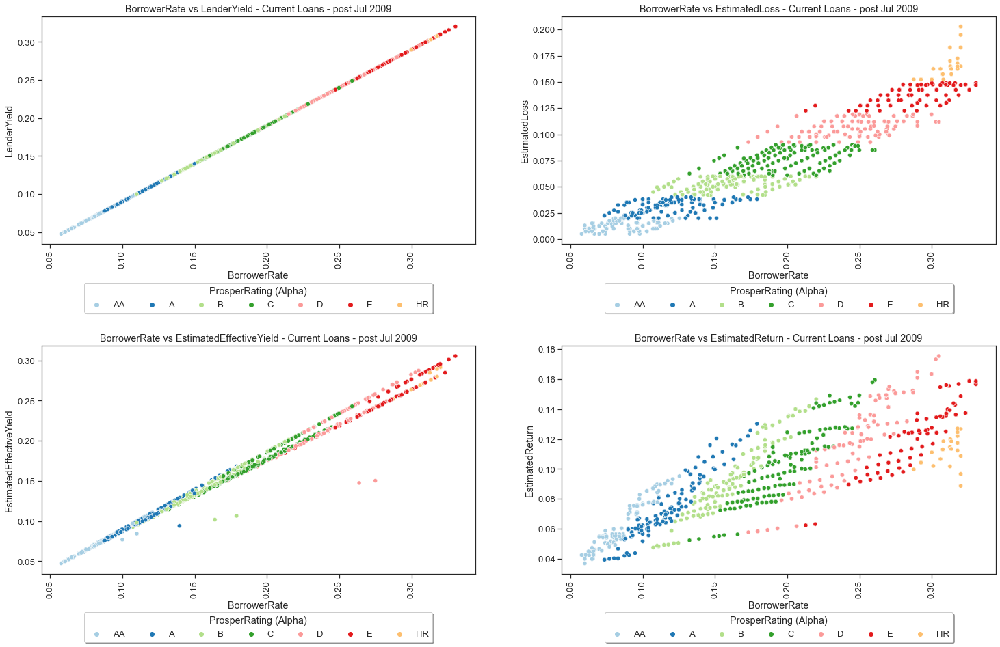

In [30]:
# The relahionship between borrowerRate and EstimateReturn, EstimatedEffectiveYield, and EstimatedLoss shows groups of data points
# What are those groups of data related to?

# lets try to segement the data by ProsperRating (Alpha) for LoanStatus = 'Current'

# What stands out is that Current loans have a linear relationship between the duo variables in the plots and the horizontal bands of data are removed by the Current loans filter.
# This suggests a different algorithm for calculating Yield, Loss, and Return is used for more recent loans vs historical loans or some type of loans are stopped in more recent loan algo changes.
# The plot demonistrates that Current Loans still constitute all levels of  ProsperRating (Alpha) inlcuding High Risk (HR) loans. 
# In other words; lower ProsperRatings and HR loans are not stopped in more recent changes.

plt.figure(figsize = [25, 15])
plt.subplots_adjust(top = 0.8, bottom=0.01, hspace=0.3, wspace=0.2) #control gap between subplots
palette = sns.color_palette("Paired", 7)

# Use white grid plot background from seaborn
sns.set(font_scale=1.2, style="ticks")

plt.subplot(2, 2, 1)
grid = sns.scatterplot(data=dfc_new[dfc_new['BorrowerRate'].notna() & (dfc_new['LoanStatus'] == 'Current')], x='BorrowerRate', y='LenderYield', hue = 'ProsperRating (Alpha)', palette=palette)
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('BorrowerRate vs LenderYield - Current Loans - post Jul 2009')
grid.set(xlabel='BorrowerRate', ylabel='LenderYield');
# Shrink current axis's height by 10% on the bottom
box = grid.get_position()
grid.set_position([box.x0, box.y0 + box.height * 0.1,
                 box.width, box.height * 0.9])

# Put a legend below current axis
grid.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15),
          fancybox=True, shadow=True, ncol=8, title='ProsperRating (Alpha)')

plt.subplot(2, 2, 2)
grid = sns.scatterplot(data=dfc_new[dfc_new['BorrowerRate'].notna() & (dfc_new['LoanStatus'] == 'Current')], x='BorrowerRate', y='EstimatedLoss', hue = 'ProsperRating (Alpha)', palette=palette)
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('BorrowerRate vs EstimatedLoss - Current Loans - post Jul 2009')
grid.set(xlabel='BorrowerRate', ylabel='EstimatedLoss');
# Shrink current axis's height by 10% on the bottom
box = grid.get_position()
grid.set_position([box.x0, box.y0 + box.height * 0.1,
                 box.width, box.height * 0.9])

# Put a legend below current axis
grid.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15),
          fancybox=True, shadow=True, ncol=8, title='ProsperRating (Alpha)')

plt.subplot(2, 2, 3)
grid = sns.scatterplot(data=dfc_new[dfc_new['BorrowerRate'].notna() & (dfc_new['LoanStatus'] == 'Current')], x='BorrowerRate', y='EstimatedEffectiveYield', hue = 'ProsperRating (Alpha)', palette=palette)#, markers=m1, style='ProsperScore' # ,x_jitter=4, y_jitter=4 dont work
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('BorrowerRate vs EstimatedEffectiveYield - Current Loans - post Jul 2009')
grid.set(xlabel='BorrowerRate', ylabel='EstimatedEffectiveYield');
box = grid.get_position()
grid.set_position([box.x0, box.y0 + box.height * 0.1,
                 box.width, box.height * 0.9])

# Put a legend below current axis
grid.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15),
          fancybox=True, shadow=True, ncol=8, title='ProsperRating (Alpha)')

plt.subplot(2, 2, 4)
grid = sns.scatterplot(data=dfc_new[dfc_new['BorrowerRate'].notna() & dfc_new['EstimatedReturn'].notna() & (dfc_new['LoanStatus'] == 'Current')], x='BorrowerRate', y='EstimatedReturn', hue = 'ProsperRating (Alpha)', palette=palette)#, markers=m1, style='ProsperScore'
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('BorrowerRate vs EstimatedReturn - Current Loans - post Jul 2009')
grid.set(xlabel='BorrowerRate', ylabel='EstimatedReturn');
box = grid.get_position()
grid.set_position([box.x0, box.y0 + box.height * 0.1,
                 box.width, box.height * 0.9])

# Put a legend below current axis
grid.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15),
          fancybox=True, shadow=True, ncol=8, title='ProsperRating (Alpha)'); # increase ncol by 1 for title to show


plt.show();


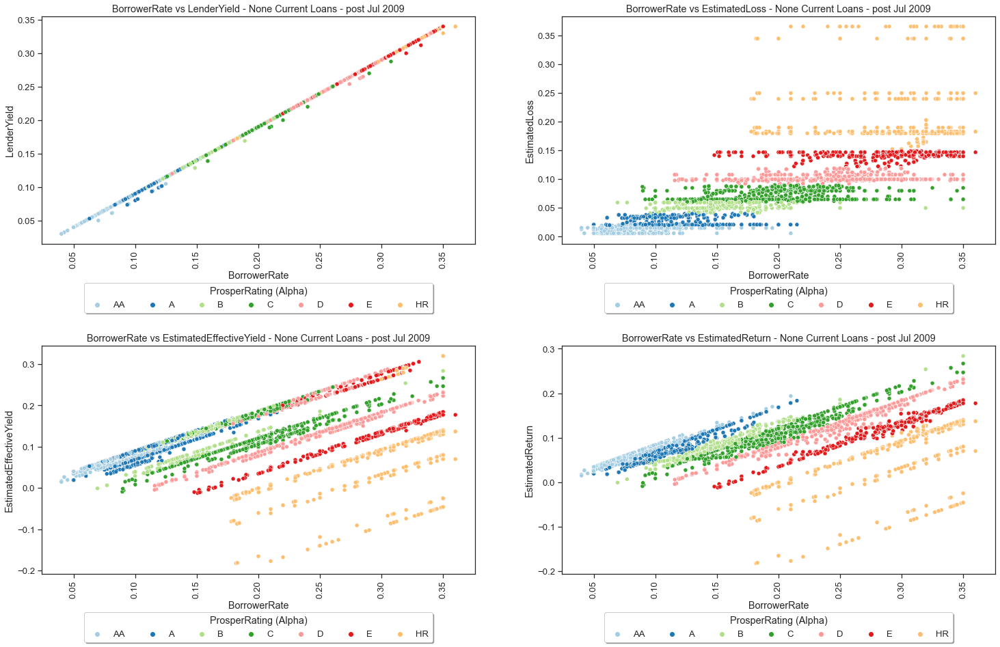

In [31]:
# The relahionship between borrowerRate and EstimateReturn, EstimatedEffectiveYield, and EstimatedLoss shows groups of data points
# What are those groups of data related to?

# lets try to segement the data by ProsperRating (Alpha) for LoanStatus != 'Current'
# The plot demonistrates that Loans 

plt.figure(figsize = [25, 15])
plt.subplots_adjust(top = 0.8, bottom=0.01, hspace=0.3, wspace=0.2) #control gap between subplots
palette = sns.color_palette("Paired", 7)

# Use white grid plot background from seaborn
sns.set(font_scale=1.2, style="ticks")

plt.subplot(2, 2, 1)
grid = sns.scatterplot(data=dfc_new[dfc_new['BorrowerRate'].notna() & (dfc_new['LoanStatus'] != 'Current')], x='BorrowerRate', y='LenderYield', hue = 'ProsperRating (Alpha)', palette=palette)
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('BorrowerRate vs LenderYield - None Current Loans - post Jul 2009')
grid.set(xlabel='BorrowerRate', ylabel='LenderYield');
# Shrink current axis's height by 10% on the bottom
box = grid.get_position()
grid.set_position([box.x0, box.y0 + box.height * 0.1,
                 box.width, box.height * 0.9])

# Put a legend below current axis
grid.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15),
          fancybox=True, shadow=True, ncol=8, title='ProsperRating (Alpha)')


plt.subplot(2, 2, 2)
grid = sns.scatterplot(data=dfc_new[dfc_new['BorrowerRate'].notna() & (dfc_new['LoanStatus'] != 'Current')], x='BorrowerRate', y='EstimatedLoss', hue = 'ProsperRating (Alpha)', palette=palette)
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('BorrowerRate vs EstimatedLoss - None Current Loans - post Jul 2009')
grid.set(xlabel='BorrowerRate', ylabel='EstimatedLoss');
# Shrink current axis's height by 10% on the bottom
box = grid.get_position()
grid.set_position([box.x0, box.y0 + box.height * 0.1,
                 box.width, box.height * 0.9])

# Put a legend below current axis
grid.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15),
          fancybox=True, shadow=True, ncol=8, title='ProsperRating (Alpha)')

plt.subplot(2, 2, 3)
grid = sns.scatterplot(data=dfc_new[dfc_new['BorrowerRate'].notna() & (dfc_new['LoanStatus'] != 'Current')], x='BorrowerRate', y='EstimatedEffectiveYield', hue = 'ProsperRating (Alpha)', palette=palette)
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('BorrowerRate vs EstimatedEffectiveYield - None Current Loans - post Jul 2009')
grid.set(xlabel='BorrowerRate', ylabel='EstimatedEffectiveYield');
box = grid.get_position()
grid.set_position([box.x0, box.y0 + box.height * 0.1,
                 box.width, box.height * 0.9])

# Put a legend below current axis
grid.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15),
          fancybox=True, shadow=True, ncol=8, title='ProsperRating (Alpha)')

plt.subplot(2, 2, 4)
grid = sns.scatterplot(data=dfc_new[dfc_new['BorrowerRate'].notna() & dfc_new['EstimatedReturn'].notna() & (dfc_new['LoanStatus'] != 'Current')], x='BorrowerRate', y='EstimatedReturn', hue = 'ProsperRating (Alpha)', palette=palette)
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('BorrowerRate vs EstimatedReturn - None Current Loans - post Jul 2009')
grid.set(xlabel='BorrowerRate', ylabel='EstimatedReturn');
box = grid.get_position()
grid.set_position([box.x0, box.y0 + box.height * 0.1,
                 box.width, box.height * 0.9])

# Put a legend below current axis
grid.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15),
          fancybox=True, shadow=True, ncol=8, title='ProsperRating (Alpha)'); # increase ncol by 1 for title to show


plt.show();


In [ ]:
import random

def jitter(x):
    #print(random.uniform(0, 0.02) -0.01)
    return x + random.uniform(0, 0.02) -.01

# adding some jitter to the scatter plot manually! because ,x_jitter=4, y_jitter=4 in sns.scatterplot dont work
dfc_new['EstimatedLoss_jitter'] = dfc_new['EstimatedLoss'].apply(lambda x: jitter(x))
dfc_new['EstimatedReturn_jitter'] = dfc_new['EstimatedReturn'].apply(lambda x: jitter(x))
dfc_new['EstimatedEffectiveYield_jitter'] = dfc_new['EstimatedEffectiveYield'].apply(lambda x: jitter(x))
dfc_new['LenderYield_jitter'] = dfc_new['LenderYield'].apply(lambda x: jitter(x))


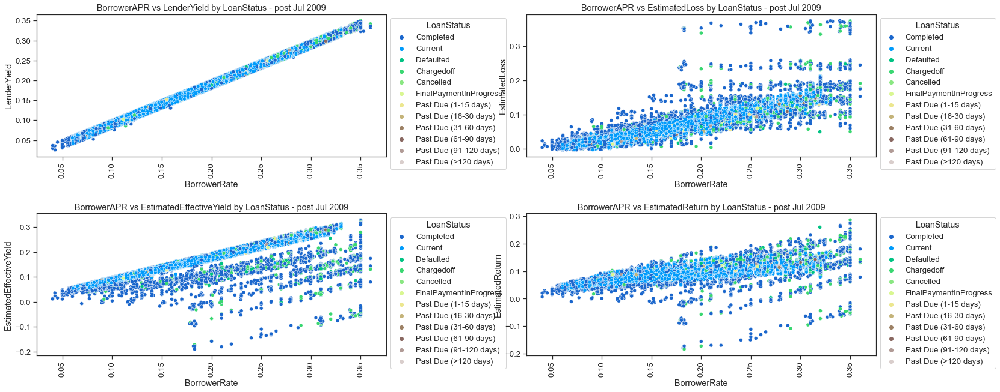

In [33]:
# The relahionship between borrowerRate and EstimateReturn, EstimatedEffectiveYield, and EstimatedLoss shows groups of data points
# What are those groups of data related to?

# lets try to segement the data by Loan Status to see all loanStatuses in one plot, instead of doing them one by one like previous two plots.
# The plots shows that current loans are associated with lower Estimatedloss, and higher EstimatedReturn and EstimatedEffectiveYield compared to other statuses.
# This may indicate a change in those metrics calculation or the way loans are allocated.

from matplotlib import cm
import random

palette = sns.color_palette("terrain", 12)

plt.figure(figsize = [25, 10])
plt.subplots_adjust(top = 0.8, bottom=0.01, hspace=0.4, wspace=0.4) #control gap between subplots

# Use white grid plot background from seaborn
sns.set(font_scale=1.2, style="ticks")

plt.subplot(2, 2, 1)
grid = sns.scatterplot(data=dfc_new[dfc_new['BorrowerRate'].notna()], x='BorrowerRate', y='LenderYield_jitter', hue = 'LoanStatus', palette=palette) # , style='LoanStatus'
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('BorrowerAPR vs LenderYield by LoanStatus - post Jul 2009')
grid.set(xlabel='BorrowerRate', ylabel='LenderYield');
sns.move_legend(grid, "upper left", bbox_to_anchor=(1, 1));

plt.subplot(2, 2, 2)
grid = sns.scatterplot(data=dfc_new[dfc_new['BorrowerRate'].notna()], x='BorrowerRate', y='EstimatedLoss_jitter', hue = 'LoanStatus', palette=palette) # , style='LoanStatus'
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('BorrowerAPR vs EstimatedLoss by LoanStatus - post Jul 2009')
grid.set(xlabel='BorrowerRate', ylabel='EstimatedLoss');
sns.move_legend(grid, "upper left", bbox_to_anchor=(1, 1));

plt.subplot(2, 2, 3)
grid = sns.scatterplot(data=dfc_new[dfc_new['BorrowerRate'].notna()], x='BorrowerRate', y='EstimatedEffectiveYield_jitter', hue = 'LoanStatus', palette=palette)
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('BorrowerAPR vs EstimatedEffectiveYield by LoanStatus - post Jul 2009')
grid.set(xlabel='BorrowerRate', ylabel='EstimatedEffectiveYield');
sns.move_legend(grid, "upper left", bbox_to_anchor=(1, 1));

plt.subplot(2, 2, 4)
grid = sns.scatterplot(data=dfc_new[dfc_new['BorrowerRate'].notna()], x='BorrowerRate', y='EstimatedReturn_jitter', hue = 'LoanStatus', palette=palette)
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('BorrowerAPR vs EstimatedReturn by LoanStatus - post Jul 2009')
grid.set(xlabel='BorrowerRate', ylabel='EstimatedReturn');
sns.move_legend(grid, "upper left", bbox_to_anchor=(1, 1));



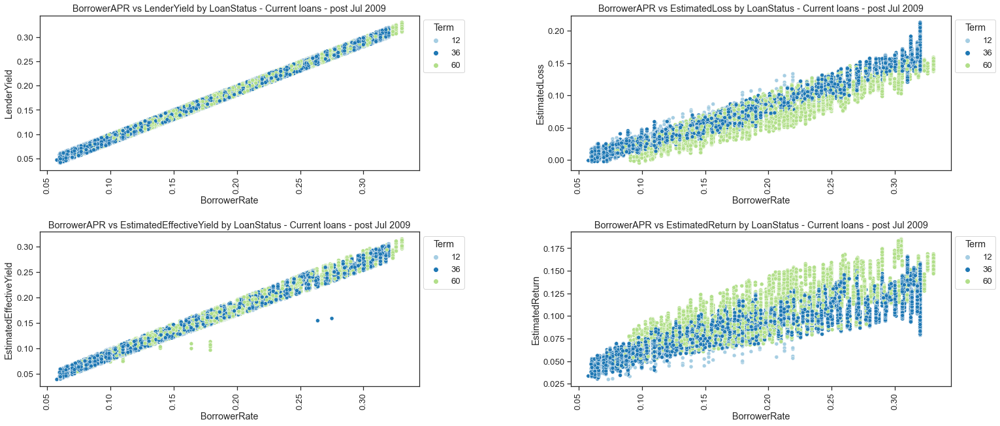

In [35]:
# The relahionship between borrowerRate and EstimateReturn, EstimatedEffectiveYield, and EstimatedLoss shows groups of data points
# What are those groups of data related to?

# lets try to segement the data by LoanStatus = 'Current' and Term to see what differences are there between the different Terms for current loans.

# It is interesting to see that 12, 36, and 60 months Terms translate in the same (equivalent) linear fashion, however we can see that EstimatedLoss is highest for 12 months Term,
# then a bit lower for 36 months Term, then lowest for 60 months Term, which Translates for better profitability for 60 months Term, then 36 months Term, and lowest profitability
# to the 12 months Term.

from matplotlib import cm
import random


palette = sns.color_palette("Paired", 3)
#palette = cm.rainbow(np.linspace(0, 1, 13))

# Use white grid plot background from seaborn
sns.set(font_scale=1.2, style="ticks")

plt.figure(figsize = [25, 10])
plt.subplots_adjust(top = 0.8, bottom=0.01, hspace=0.4, wspace=0.4) #control gap between subplots

plt.subplot(2, 2, 1)
grid = sns.scatterplot(data=dfc_new[dfc_new['BorrowerRate'].notna() & (dfc_new['LoanStatus'] == 'Current')], x='BorrowerRate', y='LenderYield_jitter', hue='Term', palette=palette) # , style='LoanStatus' ListingCategory
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('BorrowerAPR vs LenderYield by LoanStatus - Current loans - post Jul 2009')
grid.set(xlabel='BorrowerRate', ylabel='LenderYield');
sns.move_legend(grid, "upper left", bbox_to_anchor=(1, 1));

plt.subplot(2, 2, 2)
grid = sns.scatterplot(data=dfc_new[dfc_new['BorrowerRate'].notna() & (dfc_new['LoanStatus'] == 'Current')], x='BorrowerRate', y='EstimatedLoss_jitter', hue='Term', palette=palette) # , style='LoanStatus' ListingCategory
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('BorrowerAPR vs EstimatedLoss by LoanStatus - Current loans - post Jul 2009')
grid.set(xlabel='BorrowerRate', ylabel='EstimatedLoss');
sns.move_legend(grid, "upper left", bbox_to_anchor=(1, 1));

plt.subplot(2, 2, 3)
grid = sns.scatterplot(data=dfc_new[dfc_new['BorrowerRate'].notna() & (dfc_new['LoanStatus'] == 'Current')], x='BorrowerRate', y='EstimatedEffectiveYield_jitter', hue='Term', palette=palette)
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('BorrowerAPR vs EstimatedEffectiveYield by LoanStatus - Current loans - post Jul 2009')
grid.set(xlabel='BorrowerRate', ylabel='EstimatedEffectiveYield');
sns.move_legend(grid, "upper left", bbox_to_anchor=(1, 1));

plt.subplot(2, 2, 4)
grid = sns.scatterplot(data=dfc_new[dfc_new['BorrowerRate'].notna() & (dfc_new['LoanStatus'] == 'Current')], x='BorrowerRate', y='EstimatedReturn_jitter', hue='Term', palette=palette)
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('BorrowerAPR vs EstimatedReturn by LoanStatus - Current loans - post Jul 2009')
grid.set(xlabel='BorrowerRate', ylabel='EstimatedReturn');
sns.move_legend(grid, "upper left", bbox_to_anchor=(1, 1));



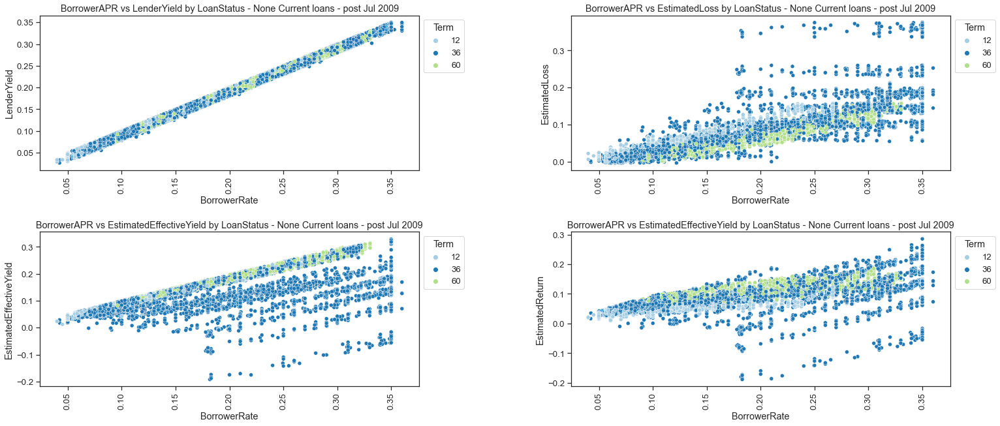

In [36]:
# The relahionship between borrowerRate and EstimateReturn, EstimatedEffectiveYield, and EstimatedLoss shows groups of data points
# What are those groups of data related to?

# lets try to segement the data by LoanStatus != 'Current' and Term to see what differences are there between the different Terms for current loans.

# We can see those None current loans having similar picture to the above for both the 12 months and 60 months loans, whereas the 36 months loans taking
# a wider range of loss and Return thus occupying the least and most profitable loans in the dataset.

from matplotlib import cm
import random

palette = sns.color_palette("Paired", 3) # LoanStatus 12 #ListingCategory 20
#palette = cm.rainbow(np.linspace(0, 1, 13))

# Use white grid plot background from seaborn
sns.set(font_scale=1.2, style="ticks")

plt.figure(figsize = [25, 10])
plt.subplots_adjust(top = 0.8, bottom=0.01, hspace=0.4, wspace=0.4) #control gap between subplots

plt.subplot(2, 2, 1)
#dfc_new['ListingCategory'].value_counts()
grid = sns.scatterplot(data=dfc_new[dfc_new['BorrowerRate'].notna() & (dfc_new['LoanStatus'] != 'Current')], x='BorrowerRate', y='LenderYield_jitter', hue = 'Term', palette=palette) # , style='LoanStatus'
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('BorrowerAPR vs LenderYield by LoanStatus - None Current loans - post Jul 2009')
grid.set(xlabel='BorrowerRate', ylabel='LenderYield');
sns.move_legend(grid, "upper left", bbox_to_anchor=(1, 1));

plt.subplot(2, 2, 2)
#dfc_new['ListingCategory'].value_counts()
grid = sns.scatterplot(data=dfc_new[dfc_new['BorrowerRate'].notna() & (dfc_new['LoanStatus'] != 'Current')], x='BorrowerRate', y='EstimatedLoss_jitter', hue = 'Term', palette=palette) # , style='LoanStatus'
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('BorrowerAPR vs EstimatedLoss by LoanStatus - None Current loans - post Jul 2009')
grid.set(xlabel='BorrowerRate', ylabel='EstimatedLoss');
sns.move_legend(grid, "upper left", bbox_to_anchor=(1, 1));

plt.subplot(2, 2, 3)
#dfc_new['ListingCategory'].value_counts()
grid = sns.scatterplot(data=dfc_new[dfc_new['BorrowerRate'].notna() & (dfc_new['LoanStatus'] != 'Current')], x='BorrowerRate', y='EstimatedEffectiveYield_jitter', hue = 'Term', palette=palette)
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('BorrowerAPR vs EstimatedEffectiveYield by LoanStatus - None Current loans - post Jul 2009')
grid.set(xlabel='BorrowerRate', ylabel='EstimatedEffectiveYield');
sns.move_legend(grid, "upper left", bbox_to_anchor=(1, 1));

plt.subplot(2, 2, 4)
#dfc_new['ListingCategory'].value_counts()
grid = sns.scatterplot(data=dfc_new[dfc_new['BorrowerRate'].notna() & (dfc_new['LoanStatus'] != 'Current')], x='BorrowerRate', y='EstimatedReturn_jitter', hue = 'Term', palette=palette)
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('BorrowerAPR vs EstimatedEffectiveYield by LoanStatus - None Current loans - post Jul 2009')
grid.set(xlabel='BorrowerRate', ylabel='EstimatedReturn');
sns.move_legend(grid, "upper left", bbox_to_anchor=(1, 1));



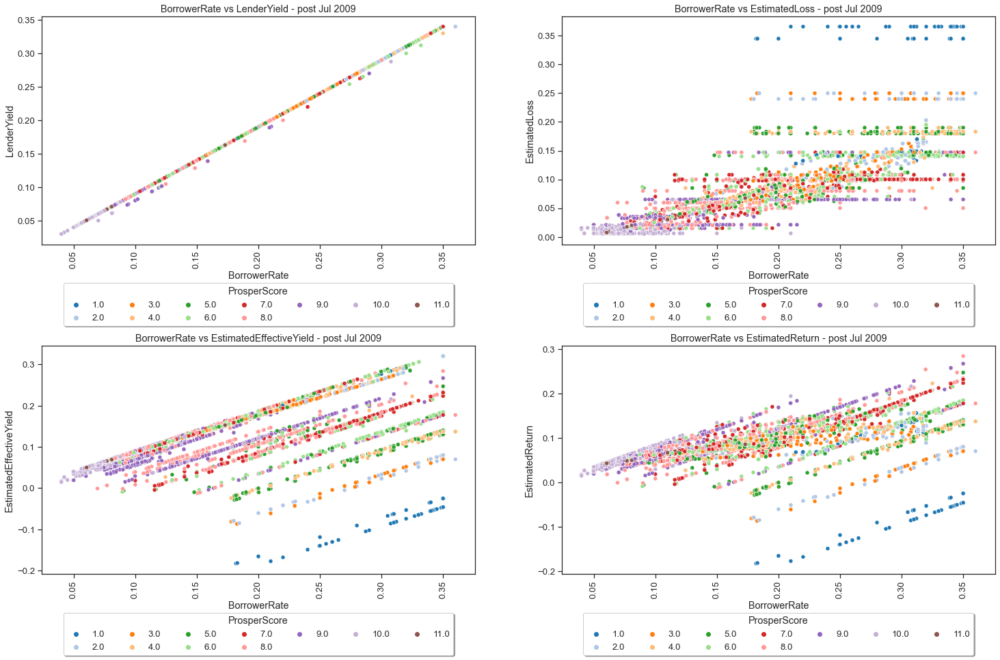

In [41]:
# The relahionship between borrowerRate and EstimateReturn, EstimatedEffectiveYield, and EstimatedLoss shows groups of data points
# What are those groups of data related to?

# lets try to segement the data by ProsperScore to see if also has an impact on how those bands are classified.

# The pattern observed with ProsperRating (Alpha) is repeated here, where "generally speaking" the lowest end of the scale dominates
# one end of the plot, and gradually increasing until reaching the highest end of the scale at the other side of the plot.
# Also, (admittedly it is a bit hard to see!) ignroing the lowest level that takes the blue band by itself, we can see that each two adjacent levels of the ProsperScore 
# dominate one band in the plot generally speaking.
# let's try a divergent palette in the next plot.

plt.figure(figsize = [25, 15])
plt.subplots_adjust(top = 0.8, bottom=0.01, hspace=0.3, wspace=0.2) #control gap between subplots

# Use white grid plot background from seaborn
sns.set(font_scale=1.2, style="ticks")

plt.subplot(2, 2, 1)
grid = sns.scatterplot(data=dfc_new[dfc_new['BorrowerRate'].notna()], x='BorrowerRate', y='LenderYield', hue = 'ProsperScore', palette="tab20")
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('BorrowerRate vs LenderYield - post Jul 2009')
grid.set(xlabel='BorrowerRate', ylabel='LenderYield');
# Shrink current axis's height by 10% on the bottom
box = grid.get_position()
grid.set_position([box.x0, box.y0 + box.height * 0.1,
                 box.width, box.height * 0.9])
# Put a legend below current axis
grid.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15),
          fancybox=True, shadow=True, ncol=7, title='ProsperScore')

plt.subplot(2, 2, 2)
grid = sns.scatterplot(data=dfc_new[dfc_new['BorrowerRate'].notna()], x='BorrowerRate', y='EstimatedLoss', hue = 'ProsperScore', palette="tab20")
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('BorrowerRate vs EstimatedLoss - post Jul 2009')
grid.set(xlabel='BorrowerRate', ylabel='EstimatedLoss');
# Shrink current axis's height by 10% on the bottom
box = grid.get_position()
grid.set_position([box.x0, box.y0 + box.height * 0.1,
                 box.width, box.height * 0.9])
# Put a legend below current axis
grid.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15),
          fancybox=True, shadow=True, ncol=7, title='ProsperScore')

plt.subplot(2, 2, 3)
grid = sns.scatterplot(data=dfc_new[dfc_new['BorrowerRate'].notna()], x='BorrowerRate', y='EstimatedEffectiveYield', hue = 'ProsperScore', palette="tab20")
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('BorrowerRate vs EstimatedEffectiveYield - post Jul 2009')
grid.set(xlabel='BorrowerRate', ylabel='EstimatedEffectiveYield');
box = grid.get_position()
grid.set_position([box.x0, box.y0 + box.height * 0.1,
                 box.width, box.height * 0.9])
# Put a legend below current axis
grid.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15),
          fancybox=True, shadow=True, ncol=7, title='ProsperScore')

plt.subplot(2, 2, 4)
grid = sns.scatterplot(data=dfc_new[dfc_new['BorrowerRate'].notna() & dfc_new['EstimatedReturn'].notna()], x='BorrowerRate', y='EstimatedReturn', hue = 'ProsperScore', palette="tab20")
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('BorrowerRate vs EstimatedReturn - post Jul 2009')
grid.set(xlabel='BorrowerRate', ylabel='EstimatedReturn');
box = grid.get_position()
grid.set_position([box.x0, box.y0 + box.height * 0.1,
                 box.width, box.height * 0.9])
# Put a legend below current axis
grid.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15),
          fancybox=True, shadow=True, ncol=7, title='ProsperScore');


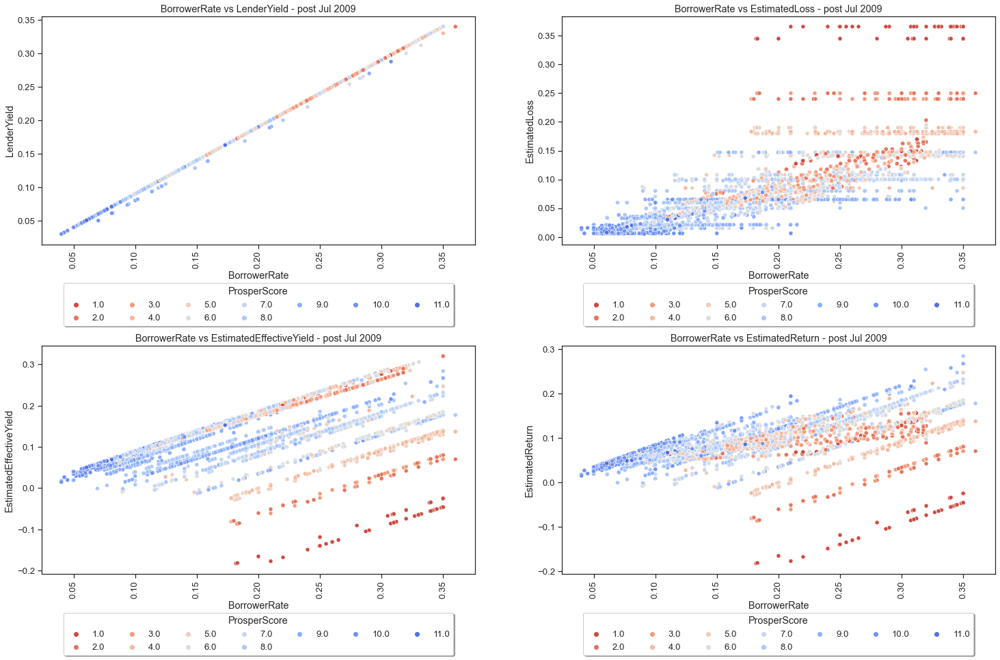

In [39]:
# The relahionship between borrowerRate and EstimateReturn, EstimatedEffectiveYield, and EstimatedLoss shows groups of data points
# What are those groups of data related to?

# lets try to segement the data by ProsperScore to see if also has an impact on how those bands are classified.

# trying a divergent palette in the plot from the preivous cell, we can see the horizontal bands moving from blue at the bottom gradually to red at the top in 
# accordance with the scale from highest to lowest. 
# The hard to see diagonal swarm of data in the middle seems to follow a similar pattern where the bottom part is in blue corresponding 
# to the highest level of the scale and then gradually moving upwards towards the lowest level in the scale represented in red.

plt.figure(figsize = [25, 15])
plt.subplots_adjust(top = 0.8, bottom=0.01, hspace=0.3, wspace=0.2) #control gap between subplots

palette = sns.color_palette("coolwarm_r", 11)

# Use white grid plot background from seaborn
sns.set(font_scale=1.2, style="ticks")

plt.subplot(2, 2, 1)
grid = sns.scatterplot(data=dfc_new[dfc_new['BorrowerRate'].notna()], x='BorrowerRate', y='LenderYield', hue = 'ProsperScore', palette=palette)
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('BorrowerRate vs LenderYield - post Jul 2009')
grid.set(xlabel='BorrowerRate', ylabel='LenderYield');
# Shrink current axis's height by 10% on the bottom
box = grid.get_position()
grid.set_position([box.x0, box.y0 + box.height * 0.1,
                 box.width, box.height * 0.9])
# Put a legend below current axis
grid.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15),
          fancybox=True, shadow=True, ncol=7, title='ProsperScore')

plt.subplot(2, 2, 2)
grid = sns.scatterplot(data=dfc_new[dfc_new['BorrowerRate'].notna()], x='BorrowerRate', y='EstimatedLoss', hue = 'ProsperScore', palette=palette)
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('BorrowerRate vs EstimatedLoss - post Jul 2009')
grid.set(xlabel='BorrowerRate', ylabel='EstimatedLoss');
# Shrink current axis's height by 10% on the bottom
box = grid.get_position()
grid.set_position([box.x0, box.y0 + box.height * 0.1,
                 box.width, box.height * 0.9])
# Put a legend below current axis
grid.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15),
          fancybox=True, shadow=True, ncol=7, title='ProsperScore')

plt.subplot(2, 2, 3)
grid = sns.scatterplot(data=dfc_new[dfc_new['BorrowerRate'].notna()], x='BorrowerRate', y='EstimatedEffectiveYield', hue = 'ProsperScore', palette=palette)
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('BorrowerRate vs EstimatedEffectiveYield - post Jul 2009')
grid.set(xlabel='BorrowerRate', ylabel='EstimatedEffectiveYield');
box = grid.get_position()
grid.set_position([box.x0, box.y0 + box.height * 0.1,
                 box.width, box.height * 0.9])
# Put a legend below current axis
grid.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15),
          fancybox=True, shadow=True, ncol=7, title='ProsperScore')

plt.subplot(2, 2, 4)
grid = sns.scatterplot(data=dfc_new[dfc_new['BorrowerRate'].notna() & dfc_new['EstimatedReturn'].notna()], x='BorrowerRate', y='EstimatedReturn', hue = 'ProsperScore', palette=palette)
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('BorrowerRate vs EstimatedReturn - post Jul 2009')
grid.set(xlabel='BorrowerRate', ylabel='EstimatedReturn');
box = grid.get_position()
grid.set_position([box.x0, box.y0 + box.height * 0.1,
                 box.width, box.height * 0.9])
# Put a legend below current axis
grid.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15),
          fancybox=True, shadow=True, ncol=7, title='ProsperScore');


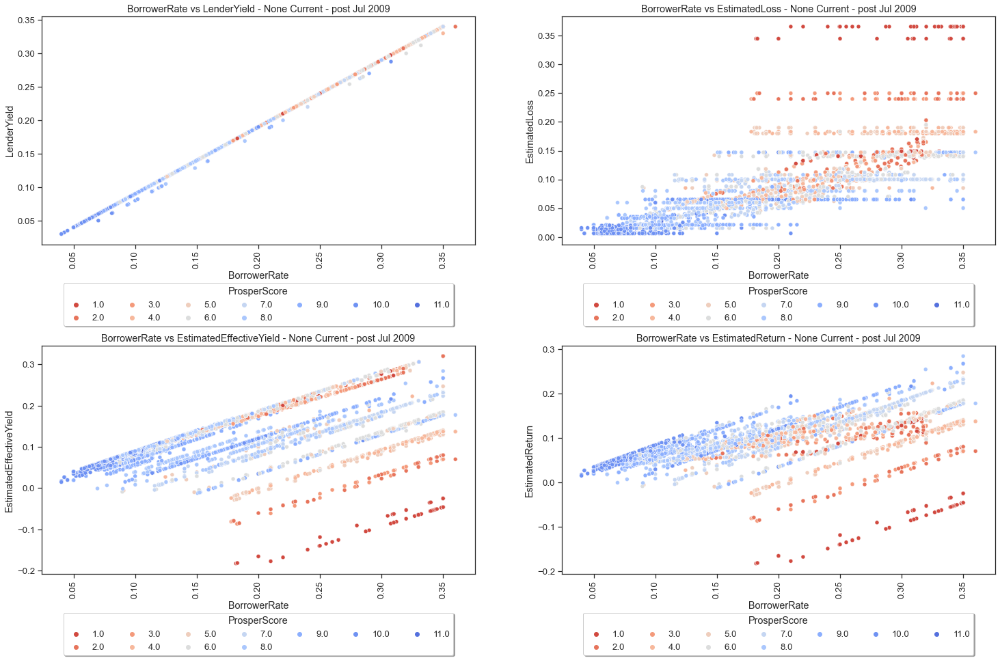

In [38]:
# The relahionship between borrowerRate and EstimateReturn, EstimatedEffectiveYield, and EstimatedLoss shows groups of data points
# What are those groups of data related to?

# lets try to segement the data by LoanStatus (Current vs other statuses) to see if they help explain the diagonal vs horizontal bands of data

# None-Current loans still exhibit the horizontal bands of data and lower density diagonal middle swarm.

plt.figure(figsize = [25, 15])
plt.subplots_adjust(top = 0.8, bottom=0.01, hspace=0.3, wspace=0.2) #control gap between subplots

palette = sns.color_palette("coolwarm_r", 11)

# Use white grid plot background from seaborn
sns.set(font_scale=1.2, style="ticks")

plt.subplot(2, 2, 1)
grid = sns.scatterplot(data=dfc_new[dfc_new['BorrowerRate'].notna() & (dfc_new['LoanStatus'] != 'Current')], x='BorrowerRate', y='LenderYield', hue = 'ProsperScore', palette=palette)
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('BorrowerRate vs LenderYield - None Current - post Jul 2009')
grid.set(xlabel='BorrowerRate', ylabel='LenderYield');
# Shrink current axis's height by 10% on the bottom
box = grid.get_position()
grid.set_position([box.x0, box.y0 + box.height * 0.1,
                 box.width, box.height * 0.9])
# Put a legend below current axis
grid.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15),
          fancybox=True, shadow=True, ncol=7, title='ProsperScore')

plt.subplot(2, 2, 2)
grid = sns.scatterplot(data=dfc_new[dfc_new['BorrowerRate'].notna() & (dfc_new['LoanStatus'] != 'Current')], x='BorrowerRate', y='EstimatedLoss', hue = 'ProsperScore', palette=palette)
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('BorrowerRate vs EstimatedLoss - None Current - post Jul 2009')
grid.set(xlabel='BorrowerRate', ylabel='EstimatedLoss');
# Shrink current axis's height by 10% on the bottom
box = grid.get_position()
grid.set_position([box.x0, box.y0 + box.height * 0.1,
                 box.width, box.height * 0.9])
# Put a legend below current axis
grid.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15),
          fancybox=True, shadow=True, ncol=7, title='ProsperScore')

plt.subplot(2, 2, 3)
grid = sns.scatterplot(data=dfc_new[dfc_new['BorrowerRate'].notna() & (dfc_new['LoanStatus'] != 'Current')], x='BorrowerRate', y='EstimatedEffectiveYield', hue = 'ProsperScore', palette=palette)
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('BorrowerRate vs EstimatedEffectiveYield - None Current - post Jul 2009')
grid.set(xlabel='BorrowerRate', ylabel='EstimatedEffectiveYield');
box = grid.get_position()
grid.set_position([box.x0, box.y0 + box.height * 0.1,
                 box.width, box.height * 0.9])
# Put a legend below current axis
grid.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15),
          fancybox=True, shadow=True, ncol=7, title='ProsperScore')

plt.subplot(2, 2, 4)
grid = sns.scatterplot(data=dfc_new[dfc_new['BorrowerRate'].notna() & dfc_new['EstimatedReturn'].notna() & (dfc_new['LoanStatus'] != 'Current')], x='BorrowerRate', y='EstimatedReturn', hue = 'ProsperScore', palette=palette)
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('BorrowerRate vs EstimatedReturn - None Current - post Jul 2009')
grid.set(xlabel='BorrowerRate', ylabel='EstimatedReturn');
box = grid.get_position()
grid.set_position([box.x0, box.y0 + box.height * 0.1,
                 box.width, box.height * 0.9])
# Put a legend below current axis
grid.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15),
          fancybox=True, shadow=True, ncol=7, title='ProsperScore');


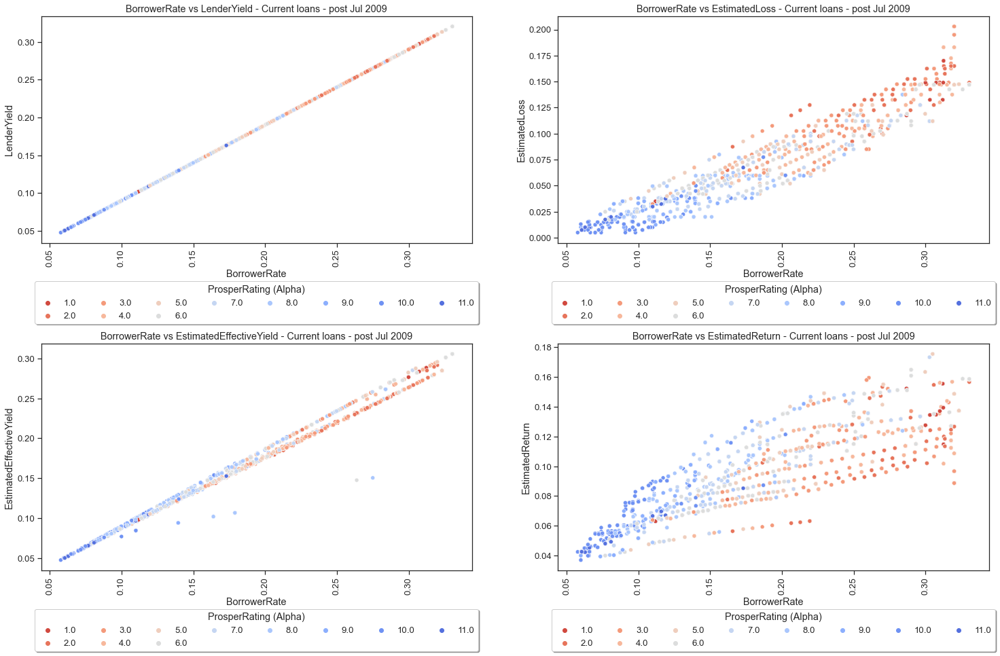

In [37]:
# The relahionship between borrowerRate and EstimateReturn, EstimatedEffectiveYield, and EstimatedLoss shows groups of data points
# What are those groups of data related to?

# lets try to segement the data by LoanStatus (Current vs other statuses) to see if they help explain the diagonal vs horizontal bands of data

# Interestingly the horizontal bands of data disappeared for Current LoanStatus while the diagonal middle swarm is the only relationship present,
# possibly suggesting differences in these metrics occured over time!

m1 = ['_','1','1','+','+','3','3','x','x',5,5]

plt.figure(figsize = [25, 15])
plt.subplots_adjust(top = 0.8, bottom=0.01, hspace=0.3, wspace=0.2) #control gap between subplots
palette = sns.color_palette("coolwarm_r", 11)

# Use white grid plot background from seaborn
sns.set(font_scale=1.2, style="ticks")

plt.subplot(2, 2, 1)
grid = sns.scatterplot(data=dfc_new[dfc_new['BorrowerRate'].notna() & (dfc_new['LoanStatus'] == 'Current')], x='BorrowerRate', y='LenderYield', hue = 'ProsperScore', palette=palette)#, markers=m1, style='ProsperScore'#, kwrags={edgecolor:'w'}
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('BorrowerRate vs LenderYield - Current loans - post Jul 2009')
grid.set(xlabel='BorrowerRate', ylabel='LenderYield');
# Shrink current axis's height by 10% on the bottom
box = grid.get_position()
grid.set_position([box.x0, box.y0 + box.height * 0.1,
                 box.width, box.height * 0.9])

# Put a legend below current axis
grid.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15),
          fancybox=True, shadow=True, ncol=8, title='ProsperRating (Alpha)')

plt.subplot(2, 2, 2)
grid = sns.scatterplot(data=dfc_new[dfc_new['BorrowerRate'].notna() & (dfc_new['LoanStatus'] == 'Current')], x='BorrowerRate', y='EstimatedLoss', hue = 'ProsperScore', palette=palette)#, markers=m1, style='ProsperScore'#, kwrags={edgecolor:'w'}
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('BorrowerRate vs EstimatedLoss - Current loans - post Jul 2009')
grid.set(xlabel='BorrowerRate', ylabel='EstimatedLoss');
# Shrink current axis's height by 10% on the bottom
box = grid.get_position()
grid.set_position([box.x0, box.y0 + box.height * 0.1,
                 box.width, box.height * 0.9])

# Put a legend below current axis
grid.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15),
          fancybox=True, shadow=True, ncol=8, title='ProsperRating (Alpha)')

plt.subplot(2, 2, 3)
grid = sns.scatterplot(data=dfc_new[dfc_new['BorrowerRate'].notna() & (dfc_new['LoanStatus'] == 'Current')], x='BorrowerRate', y='EstimatedEffectiveYield', hue = 'ProsperScore', palette=palette)#, markers=m1, style='ProsperScore' # ,x_jitter=4, y_jitter=4 dont work
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('BorrowerRate vs EstimatedEffectiveYield - Current loans - post Jul 2009')
grid.set(xlabel='BorrowerRate', ylabel='EstimatedEffectiveYield');
box = grid.get_position()
grid.set_position([box.x0, box.y0 + box.height * 0.1,
                 box.width, box.height * 0.9])

# Put a legend below current axis
grid.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15),
          fancybox=True, shadow=True, ncol=8, title='ProsperRating (Alpha)')

plt.subplot(2, 2, 4)
grid = sns.scatterplot(data=dfc_new[dfc_new['BorrowerRate'].notna() & dfc_new['EstimatedReturn'].notna() & (dfc_new['LoanStatus'] == 'Current')], x='BorrowerRate', y='EstimatedReturn', hue = 'ProsperScore', palette=palette)#, markers=m1, style='ProsperScore'
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('BorrowerRate vs EstimatedReturn - Current loans - post Jul 2009')
grid.set(xlabel='BorrowerRate', ylabel='EstimatedReturn');
box = grid.get_position()
grid.set_position([box.x0, box.y0 + box.height * 0.1,
                 box.width, box.height * 0.9])

# Put a legend below current axis
grid.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15),
          fancybox=True, shadow=True, ncol=8, title='ProsperScore'); # increase ncol by 1 for title to show


plt.show();


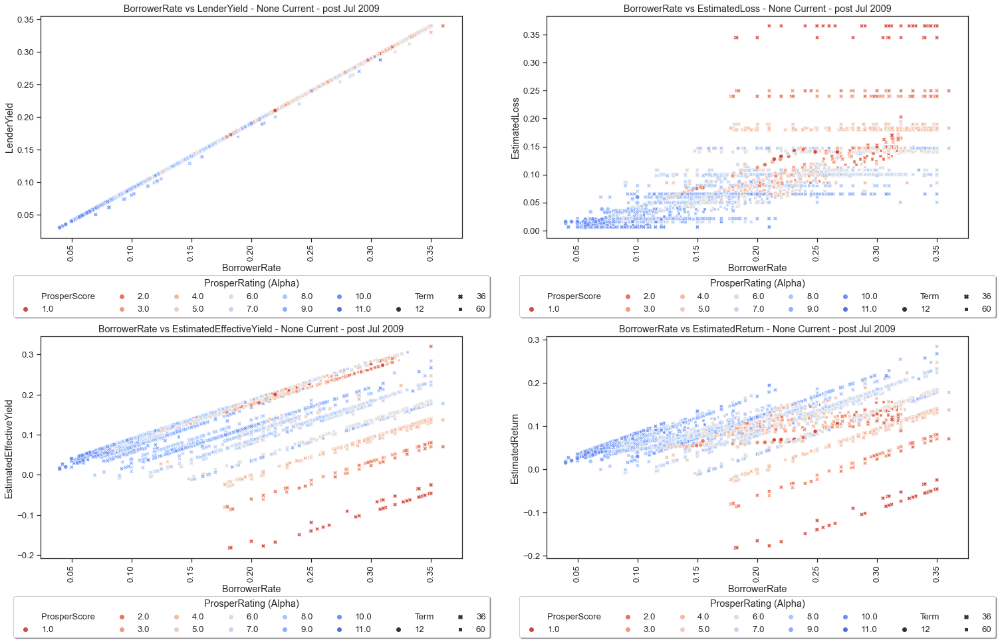

In [42]:
# The relahionship between borrowerRate and EstimateReturn, EstimatedEffectiveYield, and EstimatedLoss shows groups of data points
# What are those groups of data related to?

# let's add an fourth variable in the mix, Term, for the above plots to see if it helps explain some of the relationships we see. 
# There was no need to add the markers as an extra fourth variable, because it added clutter that is hard to decode.

m1 = ['_','1','1','+','+','3','3','x','x',5,5]

plt.figure(figsize = [25, 15])
plt.subplots_adjust(top = 0.8, bottom=0.01, hspace=0.3, wspace=0.2) #control gap between subplots
palette = sns.color_palette("coolwarm_r", 11)

# Use white grid plot background from seaborn
sns.set(font_scale=1.2, style="ticks")

plt.subplot(2, 2, 1)
grid = sns.scatterplot(data=dfc_new[dfc_new['BorrowerRate'].notna() & (dfc_new['LoanStatus'] != 'Current')], x='BorrowerRate', y='LenderYield', hue = 'ProsperScore', style='Term', palette=palette)#, markers=m1, style='ProsperScore'#, kwrags={edgecolor:'w'}
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('BorrowerRate vs LenderYield - None Current - post Jul 2009')
grid.set(xlabel='BorrowerRate', ylabel='LenderYield');
# Shrink current axis's height by 10% on the bottom
box = grid.get_position()
grid.set_position([box.x0, box.y0 + box.height * 0.1,
                 box.width, box.height * 0.9])

# Put a legend below current axis
grid.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15),
          fancybox=True, shadow=True, ncol=8, title='ProsperRating (Alpha)')

plt.subplot(2, 2, 2)
grid = sns.scatterplot(data=dfc_new[dfc_new['BorrowerRate'].notna() & (dfc_new['LoanStatus'] != 'Current')], x='BorrowerRate', y='EstimatedLoss', hue = 'ProsperScore', style='Term', palette=palette)#, markers=m1, style='ProsperScore'#, kwrags={edgecolor:'w'}
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('BorrowerRate vs EstimatedLoss - None Current - post Jul 2009')
grid.set(xlabel='BorrowerRate', ylabel='EstimatedLoss');
# Shrink current axis's height by 10% on the bottom
box = grid.get_position()
grid.set_position([box.x0, box.y0 + box.height * 0.1,
                 box.width, box.height * 0.9])

# Put a legend below current axis
grid.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15),
          fancybox=True, shadow=True, ncol=8, title='ProsperRating (Alpha)')

plt.subplot(2, 2, 3)
grid = sns.scatterplot(data=dfc_new[dfc_new['BorrowerRate'].notna() & (dfc_new['LoanStatus'] != 'Current')], x='BorrowerRate', y='EstimatedEffectiveYield', hue = 'ProsperScore', style='Term', palette=palette)#, markers=m1, style='ProsperScore' # ,x_jitter=4, y_jitter=4 dont work
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('BorrowerRate vs EstimatedEffectiveYield - None Current - post Jul 2009')
grid.set(xlabel='BorrowerRate', ylabel='EstimatedEffectiveYield');
box = grid.get_position()
grid.set_position([box.x0, box.y0 + box.height * 0.1,
                 box.width, box.height * 0.9])

# Put a legend below current axis
grid.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15),
          fancybox=True, shadow=True, ncol=8, title='ProsperRating (Alpha)')

plt.subplot(2, 2, 4)
grid = sns.scatterplot(data=dfc_new[dfc_new['BorrowerRate'].notna() & dfc_new['EstimatedReturn'].notna() & (dfc_new['LoanStatus'] != 'Current')], x='BorrowerRate', y='EstimatedReturn', hue = 'ProsperScore', style='Term', palette=palette)#, markers=m1, style='ProsperScore'
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('BorrowerRate vs EstimatedReturn - None Current - post Jul 2009')
grid.set(xlabel='BorrowerRate', ylabel='EstimatedReturn');
box = grid.get_position()
grid.set_position([box.x0, box.y0 + box.height * 0.1,
                 box.width, box.height * 0.9])

# Put a legend below current axis
grid.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15),
          fancybox=True, shadow=True, ncol=8, title='ProsperScore'); # increase ncol by 1 for title to show


plt.show();


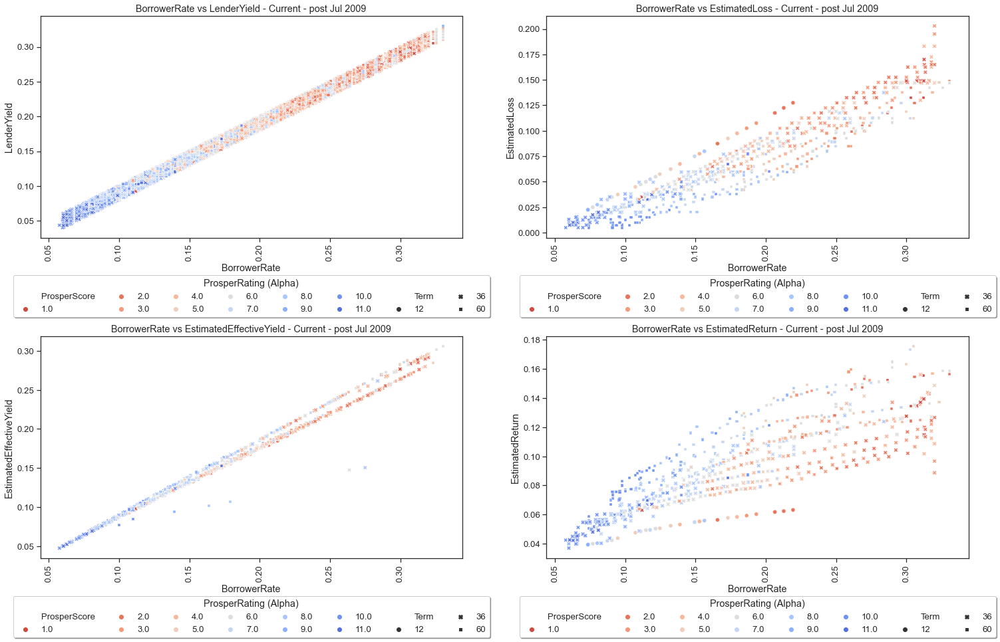

In [44]:
# The relahionship between borrowerRate and EstimateReturn, EstimatedEffectiveYield, and EstimatedLoss shows groups of data points
# What are those groups of data related to?

# let's add an fourth variable in the mix, Term, for the above plots to see if it helps explain some of the relationships we see. 
# There was no need to add the markers as an extra fourth variable, because it added clutter that is hard to decode.

m1 = ['_','1','1','+','+','3','3','x','x',5,5]

plt.figure(figsize = [25, 15])
plt.subplots_adjust(top = 0.8, bottom=0.01, hspace=0.3, wspace=0.2) #control gap between subplots
palette = sns.color_palette("coolwarm_r", 11)

plt.subplot(2, 2, 1)
grid = sns.scatterplot(data=dfc_new[dfc_new['BorrowerRate'].notna() & (dfc_new['LoanStatus'] == 'Current')], x='BorrowerRate', y='LenderYield_jitter', hue = 'ProsperScore', style='Term', palette=palette)#, markers=m1, style='ProsperScore'#, kwrags={edgecolor:'w'}
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('BorrowerRate vs LenderYield - Current - post Jul 2009')
grid.set(xlabel='BorrowerRate', ylabel='LenderYield');
# Shrink current axis's height by 10% on the bottom
box = grid.get_position()
grid.set_position([box.x0, box.y0 + box.height * 0.1,
                 box.width, box.height * 0.9])

# Put a legend below current axis
grid.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15),
          fancybox=True, shadow=True, ncol=8, title='ProsperRating (Alpha)')

plt.subplot(2, 2, 2)
grid = sns.scatterplot(data=dfc_new[dfc_new['BorrowerRate'].notna() & (dfc_new['LoanStatus'] == 'Current')], x='BorrowerRate', y='EstimatedLoss', hue = 'ProsperScore', style='Term', palette=palette)#, markers=m1, style='ProsperScore'#, kwrags={edgecolor:'w'}
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('BorrowerRate vs EstimatedLoss - Current - post Jul 2009')
grid.set(xlabel='BorrowerRate', ylabel='EstimatedLoss');
# Shrink current axis's height by 10% on the bottom
box = grid.get_position()
grid.set_position([box.x0, box.y0 + box.height * 0.1,
                 box.width, box.height * 0.9])

# Put a legend below current axis
grid.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15),
          fancybox=True, shadow=True, ncol=8, title='ProsperRating (Alpha)')

plt.subplot(2, 2, 3)
grid = sns.scatterplot(data=dfc_new[dfc_new['BorrowerRate'].notna() & (dfc_new['LoanStatus'] == 'Current')], x='BorrowerRate', y='EstimatedEffectiveYield', hue = 'ProsperScore', style='Term', palette=palette)#, markers=m1, style='ProsperScore' # ,x_jitter=4, y_jitter=4 dont work
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('BorrowerRate vs EstimatedEffectiveYield - Current - post Jul 2009')
grid.set(xlabel='BorrowerRate', ylabel='EstimatedEffectiveYield');
box = grid.get_position()
grid.set_position([box.x0, box.y0 + box.height * 0.1,
                 box.width, box.height * 0.9])

# Put a legend below current axis
grid.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15),
          fancybox=True, shadow=True, ncol=8, title='ProsperRating (Alpha)')

plt.subplot(2, 2, 4)
grid = sns.scatterplot(data=dfc_new[dfc_new['BorrowerRate'].notna() & dfc_new['EstimatedReturn'].notna() & (dfc_new['LoanStatus'] == 'Current')], x='BorrowerRate', y='EstimatedReturn', hue = 'ProsperScore', style='Term', palette=palette)#, markers=m1, style='ProsperScore'
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('BorrowerRate vs EstimatedReturn - Current - post Jul 2009')
grid.set(xlabel='BorrowerRate', ylabel='EstimatedReturn');
box = grid.get_position()
grid.set_position([box.x0, box.y0 + box.height * 0.1,
                 box.width, box.height * 0.9])

# Put a legend below current axis
grid.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15),
          fancybox=True, shadow=True, ncol=8, title='ProsperScore'); # increase ncol by 1 for title to show


plt.show();


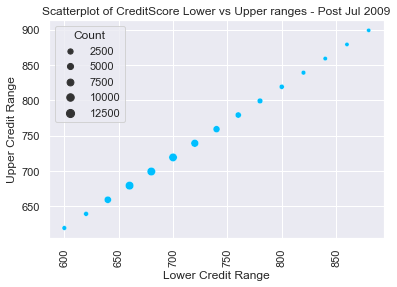

In [175]:
# how does the post Jul 2009 CreditScore look like and which has higher representation of borrowers?

# CreditScoreRangeLower and CreditScoreRangeUpper have a perfect linear relationship. No variations detected for those levels.
# Therefore in analysis we can use one of them to represent this scoring metric.

# worth noting that most common loans are given to mid lower Scores as can be seen by the circule size.

#reset theme
sns.set_theme()

dfcounted = dfc_new.groupby(['CreditScoreRangeLower', 'CreditScoreRangeUpper']).size().reset_index(name='Count')

grid = sns.scatterplot(data=dfcounted[dfcounted['CreditScoreRangeLower'].notna()], x='CreditScoreRangeLower', y='CreditScoreRangeUpper', size='Count', color='deepskyblue')
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('Scatterplot of CreditScore Lower vs Upper ranges - Post Jul 2009')
grid.set(xlabel='Lower Credit Range', ylabel='Upper Credit Range');

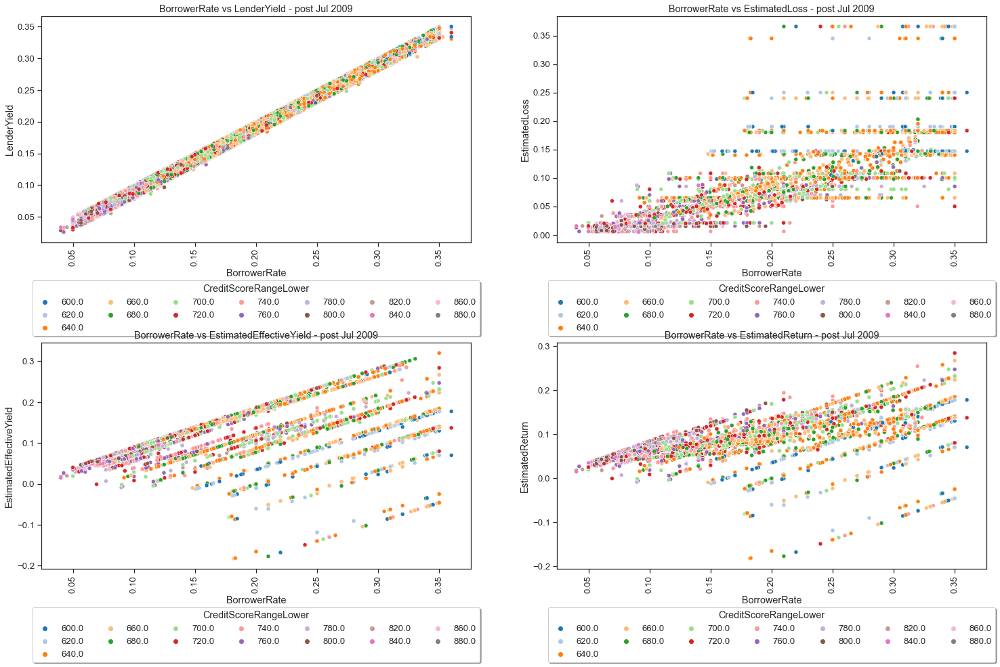

In [46]:
# The relahionship between borrowerRate and EstimateReturn, EstimatedEffectiveYield, and EstimatedLoss shows groups of data points
# What are those groups of data related to?

# lets try to segement the data by CreditScoreRangeLower to see if also has an impact on how those bands are classified.

# There is no clear trend easy to splot of how those CreditScoreRangeLower are mapped in the plot probably due to the large number of levels present in this variables, 
# but very careful observation of the plot reveals overall trend of lower CreditScoreRangeLower dominating one side (upper) of the scatterplot while the upper 
# CreditScoreRangeLower values dominating the other side (lower) of the scatterplot.
# There is a very difficult to spot hint in the plot, suggesting CreditScoreRangeLower is influencing the sub lines within the horizontal sub bands 
# (very closely adjacent horizontal lines)
# The overall trend may be better represented by choosing a diverging pallete.

plt.figure(figsize = [25, 15])
plt.subplots_adjust(top = 0.8, bottom=0.01, hspace=0.3, wspace=0.2) #control gap between subplots

# Use white grid plot background from seaborn
sns.set(font_scale=1.2, style="ticks")

plt.subplot(2, 2, 1)
grid = sns.scatterplot(data=dfc_new[dfc_new['BorrowerRate'].notna()], x='BorrowerRate', y='LenderYield_jitter', hue = 'CreditScoreRangeLower', palette="tab20")
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('BorrowerRate vs LenderYield - post Jul 2009')
grid.set(xlabel='BorrowerRate', ylabel='LenderYield');
# Shrink current axis's height by 10% on the bottom
box = grid.get_position()
grid.set_position([box.x0, box.y0 + box.height * 0.1,
                 box.width, box.height * 0.9])
# Put a legend below current axis
grid.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15),
          fancybox=True, shadow=True, ncol=7, title='CreditScoreRangeLower')

plt.subplot(2, 2, 2)
grid = sns.scatterplot(data=dfc_new[dfc_new['BorrowerRate'].notna()], x='BorrowerRate', y='EstimatedLoss', hue = 'CreditScoreRangeLower', palette="tab20")
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('BorrowerRate vs EstimatedLoss - post Jul 2009')
grid.set(xlabel='BorrowerRate', ylabel='EstimatedLoss');
# Shrink current axis's height by 10% on the bottom
box = grid.get_position()
grid.set_position([box.x0, box.y0 + box.height * 0.1,
                 box.width, box.height * 0.9])
# Put a legend below current axis
grid.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15),
          fancybox=True, shadow=True, ncol=7, title='CreditScoreRangeLower')

plt.subplot(2, 2, 3)
grid = sns.scatterplot(data=dfc_new[dfc_new['BorrowerRate'].notna()], x='BorrowerRate', y='EstimatedEffectiveYield', hue = 'CreditScoreRangeLower', palette="tab20")
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('BorrowerRate vs EstimatedEffectiveYield - post Jul 2009')
grid.set(xlabel='BorrowerRate', ylabel='EstimatedEffectiveYield');
box = grid.get_position()
grid.set_position([box.x0, box.y0 + box.height * 0.1,
                 box.width, box.height * 0.9])
# Put a legend below current axis
grid.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15),
          fancybox=True, shadow=True, ncol=7, title='CreditScoreRangeLower')

plt.subplot(2, 2, 4)
grid = sns.scatterplot(data=dfc_new[dfc_new['BorrowerRate'].notna() & dfc_new['EstimatedReturn'].notna()], x='BorrowerRate', y='EstimatedReturn', hue = 'CreditScoreRangeLower', palette="tab20")
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('BorrowerRate vs EstimatedReturn - post Jul 2009')
grid.set(xlabel='BorrowerRate', ylabel='EstimatedReturn');
box = grid.get_position()
grid.set_position([box.x0, box.y0 + box.height * 0.1,
                 box.width, box.height * 0.9])
# Put a legend below current axis
grid.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15),
          fancybox=True, shadow=True, ncol=7, title='CreditScoreRangeLower');


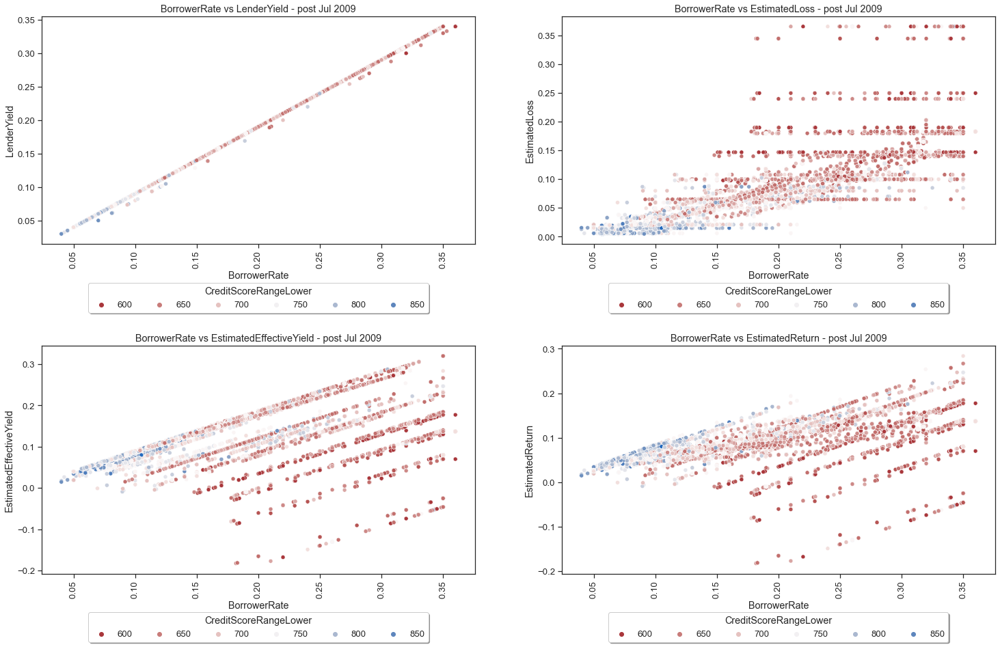

In [61]:
# The relahionship between borrowerRate and EstimateReturn, EstimatedEffectiveYield, and EstimatedLoss shows groups of data points
# What are those groups of data related to?

# lets try to segement the data by CreditScoreRangeLower to see if also has an impact on how those bands are classified using a diverging palette.

# Choosing a divering palette shows the gradual transitions in the scatterplot colours marrying up with the levels present in CreditScoreRangeLower
# for both the horizontal bands and the diagonal swarm of data.

plt.figure(figsize = [25, 15])
plt.subplots_adjust(top = 0.8, bottom=0.01, hspace=0.3, wspace=0.2) #control gap between subplots

# Use white grid plot background from seaborn
sns.set(font_scale=1.2, style="ticks")

plt.subplot(2, 2, 1)
grid = sns.scatterplot(data=dfc_new[dfc_new['BorrowerRate'].notna()], x='BorrowerRate', y='LenderYield', hue = 'CreditScoreRangeLower', palette="vlag_r")
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('BorrowerRate vs LenderYield - post Jul 2009')
grid.set(xlabel='BorrowerRate', ylabel='LenderYield');
# Shrink current axis's height by 10% on the bottom
box = grid.get_position()
grid.set_position([box.x0, box.y0 + box.height * 0.1,
                 box.width, box.height * 0.9])
# Put a legend below current axis
grid.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15),
          fancybox=True, shadow=True, ncol=7, title='CreditScoreRangeLower')

plt.subplot(2, 2, 2)
grid = sns.scatterplot(data=dfc_new[dfc_new['BorrowerRate'].notna()], x='BorrowerRate', y='EstimatedLoss', hue = 'CreditScoreRangeLower', palette="vlag_r")
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('BorrowerRate vs EstimatedLoss - post Jul 2009')
grid.set(xlabel='BorrowerRate', ylabel='EstimatedLoss');
# Shrink current axis's height by 10% on the bottom
box = grid.get_position()
grid.set_position([box.x0, box.y0 + box.height * 0.1,
                 box.width, box.height * 0.9])
# Put a legend below current axis
grid.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15),
          fancybox=True, shadow=True, ncol=7, title='CreditScoreRangeLower')

plt.subplot(2, 2, 3)
grid = sns.scatterplot(data=dfc_new[dfc_new['BorrowerRate'].notna()], x='BorrowerRate', y='EstimatedEffectiveYield', hue = 'CreditScoreRangeLower', palette="vlag_r")
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('BorrowerRate vs EstimatedEffectiveYield - post Jul 2009')
grid.set(xlabel='BorrowerRate', ylabel='EstimatedEffectiveYield');
box = grid.get_position()
grid.set_position([box.x0, box.y0 + box.height * 0.1,
                 box.width, box.height * 0.9])
# Put a legend below current axis
grid.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15),
          fancybox=True, shadow=True, ncol=7, title='CreditScoreRangeLower')

plt.subplot(2, 2, 4)
grid = sns.scatterplot(data=dfc_new[dfc_new['BorrowerRate'].notna() & dfc_new['EstimatedReturn'].notna()], x='BorrowerRate', y='EstimatedReturn', hue = 'CreditScoreRangeLower', palette="vlag_r")
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('BorrowerRate vs EstimatedReturn - post Jul 2009')
grid.set(xlabel='BorrowerRate', ylabel='EstimatedReturn');
box = grid.get_position()
grid.set_position([box.x0, box.y0 + box.height * 0.1,
                 box.width, box.height * 0.9])
# Put a legend below current axis
grid.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15),
          fancybox=True, shadow=True, ncol=7, title='CreditScoreRangeLower');


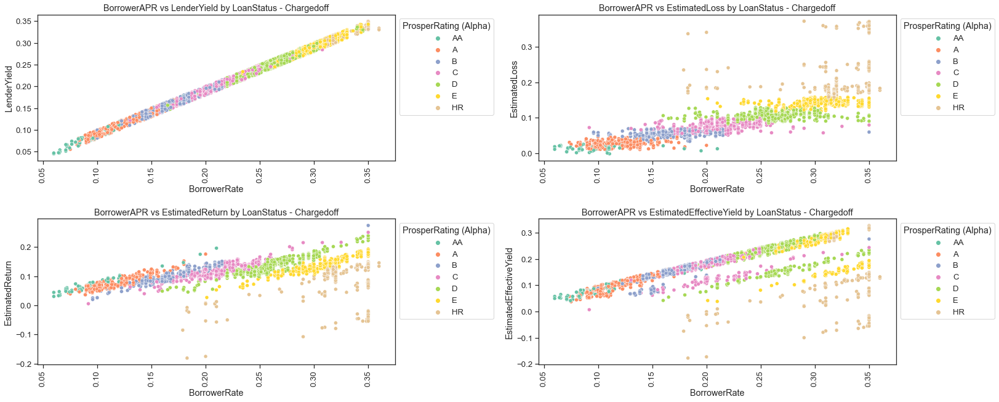

In [51]:
# The relahionship between borrowerRate and EstimateReturn, EstimatedEffectiveYield, and EstimatedLoss shows groups of data points
# What are those groups of data related to?

# lets Plot the relahionship between borrowerRate and EstimateReturn, EstimatedEffectiveYield, and EstimatedLoss for LoanStatus = 'Chargedoff'

# Contrary to our expectation, Chargedoff seems to have loans from across the spectrum of ProsperRating (Alpha) and not just High Risk (HR) loans!

from matplotlib import cm
import random

palette = sns.color_palette("Set2", 7)
#palette = cm.rainbow(np.linspace(0, 1, 13))

# Use white grid plot background from seaborn
sns.set(font_scale=1.2, style="ticks")

plt.figure(figsize = [25, 10])
plt.subplots_adjust(top = 0.8, bottom=0.01, hspace=0.4, wspace=0.4) #control gap between subplots

plt.subplot(2, 2, 1)
grid = sns.scatterplot(data=dfc_new[dfc_new['BorrowerRate'].notna() & dfc_new['LoanStatus'].isin(['Chargedoff'])], x='BorrowerRate', y='LenderYield_jitter', hue = 'ProsperRating (Alpha)', palette=palette, ) # ,x_jitter=4, y_jitter=4 dont work
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('BorrowerAPR vs LenderYield by LoanStatus - Chargedoff')
grid.set(xlabel='BorrowerRate', ylabel='LenderYield');
sns.move_legend(grid, "upper left", bbox_to_anchor=(1, 1));

plt.subplot(2, 2, 2)
grid = sns.scatterplot(data=dfc_new[dfc_new['BorrowerRate'].notna() & dfc_new['LoanStatus'].isin(['Chargedoff'])], x='BorrowerRate', y='EstimatedLoss_jitter', hue = 'ProsperRating (Alpha)', palette=palette, ) # ,x_jitter=4, y_jitter=4 dont work
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('BorrowerAPR vs EstimatedLoss by LoanStatus - Chargedoff')
grid.set(xlabel='BorrowerRate', ylabel='EstimatedLoss');
sns.move_legend(grid, "upper left", bbox_to_anchor=(1, 1));

plt.subplot(2, 2, 3)
grid = sns.scatterplot(data=dfc_new[dfc_new['BorrowerRate'].notna() & dfc_new['LoanStatus'].isin(['Chargedoff'])], x='BorrowerRate', y='EstimatedReturn_jitter', hue = 'ProsperRating (Alpha)', palette=palette)
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('BorrowerAPR vs EstimatedReturn by LoanStatus - Chargedoff')
grid.set(xlabel='BorrowerRate', ylabel='EstimatedReturn');
sns.move_legend(grid, "upper left", bbox_to_anchor=(1, 1));

plt.subplot(2, 2, 4)
grid = sns.scatterplot(data=dfc_new[dfc_new['BorrowerRate'].notna() & dfc_new['LoanStatus'].isin(['Chargedoff'])], x='BorrowerRate', y='EstimatedEffectiveYield_jitter', hue = 'ProsperRating (Alpha)', palette=palette)
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('BorrowerAPR vs EstimatedEffectiveYield by LoanStatus - Chargedoff')
grid.set(xlabel='BorrowerRate', ylabel='EstimatedEffectiveYield');
sns.move_legend(grid, "upper left", bbox_to_anchor=(1, 1));



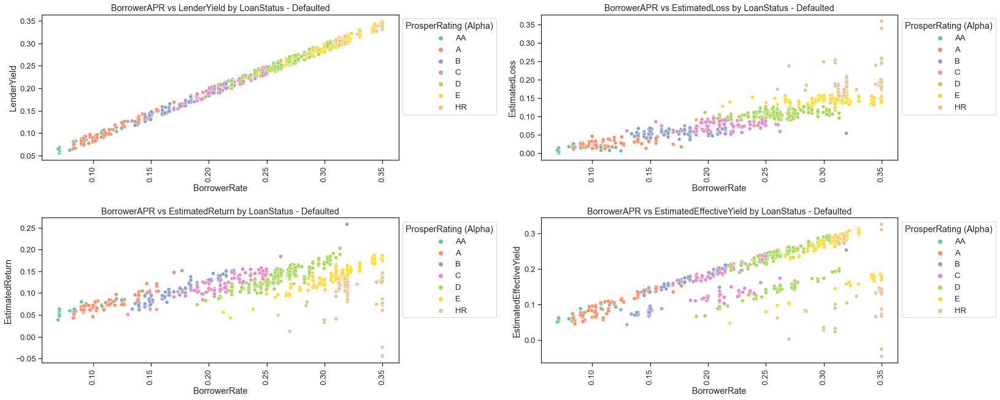

In [52]:
# The relahionship between borrowerRate and EstimateReturn, EstimatedEffectiveYield, and EstimatedLoss shows groups of data points
# What are those groups of data related to?

# lets Plot the relahionship between borrowerRate and EstimateReturn, EstimatedEffectiveYield, and EstimatedLoss for LoanStatus = 'Defaulted'

# Contrary to our expectation, Defaulted seems to have loans from across the spectrum of ProsperRating (Alpha) and not just High Risk (HR) loans!

from matplotlib import cm
import random

palette = sns.color_palette("Set2", 7)
#palette = cm.rainbow(np.linspace(0, 1, 13))

# Use white grid plot background from seaborn
sns.set(font_scale=1.2, style="ticks")

plt.figure(figsize = [25, 10])
plt.subplots_adjust(top = 0.8, bottom=0.01, hspace=0.4, wspace=0.4) #control gap between subplots

plt.subplot(2, 2, 1)
#dfc_new['ListingCategory'].value_counts()
grid = sns.scatterplot(data=dfc_new[dfc_new['BorrowerRate'].notna() & dfc_new['LoanStatus'].isin(['Defaulted'])], x='BorrowerRate', y='LenderYield_jitter', hue = 'ProsperRating (Alpha)', palette=palette) # , style='LoanStatus'
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('BorrowerAPR vs LenderYield by LoanStatus - Defaulted')
grid.set(xlabel='BorrowerRate', ylabel='LenderYield');
sns.move_legend(grid, "upper left", bbox_to_anchor=(1, 1));

plt.subplot(2, 2, 2)
#dfc_new['ListingCategory'].value_counts()
grid = sns.scatterplot(data=dfc_new[dfc_new['BorrowerRate'].notna() & dfc_new['LoanStatus'].isin(['Defaulted'])], x='BorrowerRate', y='EstimatedLoss_jitter', hue = 'ProsperRating (Alpha)', palette=palette) # , style='LoanStatus'
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('BorrowerAPR vs EstimatedLoss by LoanStatus - Defaulted')
grid.set(xlabel='BorrowerRate', ylabel='EstimatedLoss');
sns.move_legend(grid, "upper left", bbox_to_anchor=(1, 1));

plt.subplot(2, 2, 3)
#dfc_new['ListingCategory'].value_counts()
grid = sns.scatterplot(data=dfc_new[dfc_new['BorrowerRate'].notna() & dfc_new['LoanStatus'].isin(['Defaulted'])], x='BorrowerRate', y='EstimatedReturn_jitter', hue = 'ProsperRating (Alpha)', palette=palette)
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('BorrowerAPR vs EstimatedReturn by LoanStatus - Defaulted')
grid.set(xlabel='BorrowerRate', ylabel='EstimatedReturn');
sns.move_legend(grid, "upper left", bbox_to_anchor=(1, 1));

plt.subplot(2, 2, 4)
#dfc_new['ListingCategory'].value_counts()
grid = sns.scatterplot(data=dfc_new[dfc_new['BorrowerRate'].notna() & dfc_new['LoanStatus'].isin(['Defaulted'])], x='BorrowerRate', y='EstimatedEffectiveYield_jitter', hue = 'ProsperRating (Alpha)', palette=palette)
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('BorrowerAPR vs EstimatedEffectiveYield by LoanStatus - Defaulted')
grid.set(xlabel='BorrowerRate', ylabel='EstimatedEffectiveYield');
sns.move_legend(grid, "upper left", bbox_to_anchor=(1, 1));



In [202]:
# sense checking the data and variables

dfc_new[dfc_new['LoanStatus'].isin(['Defautled','Chargedoff'])]

,ListingKey,ListingNumber,ListingCreationDate,CreditGrade,Term,LoanStatus,ClosedDate,BorrowerAPR,BorrowerRate,LenderYield,...,InvestmentFromFriendsCount,InvestmentFromFriendsAmount,Investors,ListingCategory,LoanDate,year,period,EstimatedLoss_jitter,EstimatedReturn_jitter,EstimatedEffectiveYield_jitter
57,0FEA35330893790885F63E8,540655,2011-11-22 14:13:53.397000000,NaN,36,Chargedoff,2013-05-22 00:00:00,0.29394,0.2552,0.2452,...,0,0.0,2,Debt Consolidation,2012-01-20,2012,post-Jul2009,0.110602,0.120775,0.239359
74,0DEB351032566848818E832,496566,2011-03-04 14:21:40.320000000,NaN,36,Chargedoff,2013-09-15 00:00:00,0.35643,0.3199,0.3099,...,0,0.0,50,Other,2011-03-16,2011,post-Jul2009,0.152949,0.146560,0.300913
75,0DF535815829610812D7705,813784,2013-06-18 15:19:26.643000000,NaN,36,Chargedoff,2014-01-01 00:00:00,0.32538,0.2859,0.2759,...,0,0.0,42,Vacation,2013-07-01,2013,post-Jul2009,0.141824,0.109965,0.253668
83,1066354838733351352FBF8,596575,2012-06-05 14:27:23.647000000,NaN,36,Chargedoff,2012-12-08 00:00:00,0.33553,0.2958,0.2858,...,0,0.0,11,Other,2012-06-08,2012,post-Jul2009,0.138130,0.128750,0.264743
93,0FEC354965230800369FB27,597761,2012-06-08 14:51:19.073000000,NaN,60,Chargedoff,2013-02-12 00:00:00,0.27462,0.2489,0.2389,...,0,0.0,152,Taxes,2012-06-13,2012,post-Jul2009,0.092289,0.146807,0.230948
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
113808,DEE03514312653691ED9A15,503406,2011-04-22 07:42:13.620000000,NaN,36,Chargedoff,2012-07-28 00:00:00,0.35643,0.3199,0.3099,...,0,0.0,45,Home Improvement,2011-04-28,2011,post-Jul2009,0.181185,0.109513,0.283036
113835,E4B33463611044453826149,423444,2009-09-09 20:09:15.827000000,NaN,36,Chargedoff,2012-12-22 00:00:00,0.29926,0.2600,0.2500,...,0,0.0,34,Debt Consolidation,2009-09-22,2009,post-Jul2009,0.070345,0.181743,0.182455
113876,D2003560000890787A68186,647703,2012-10-01 08:02:33.090000000,NaN,60,Chargedoff,2014-01-10 00:00:00,0.23718,0.2124,0.2024,...,0,0.0,245,Debt Consolidation,2012-10-10,2012,post-Jul2009,0.065510,0.147269,0.201375
113889,E306354526977986481D1E2,581624,2012-04-23 13:55:02.287000000,NaN,12,Chargedoff,2013-06-27 00:00:00,0.17969,0.1224,0.1124,...,0,0.0,42,Household Expenses,2012-04-25,2012,post-Jul2009,0.065351,0.054805,0.107167


In [203]:
# sense checking the entire data columns/variables to pick next analysis route!

dfc_liner = dfc.loc[dfc['EstimatedReturn'] == dfc['EstimatedEffectiveYield']]
pd.set_option('display.max_columns', None)

display(dfc_liner)

,ListingKey,ListingNumber,ListingCreationDate,CreditGrade,Term,LoanStatus,ClosedDate,BorrowerAPR,BorrowerRate,LenderYield,EstimatedEffectiveYield,EstimatedLoss,EstimatedReturn,ProsperRating (numeric),ProsperRating (Alpha),ProsperScore,ListingCategory (numeric),BorrowerState,Occupation,EmploymentStatus,EmploymentStatusDuration,IsBorrowerHomeowner,CurrentlyInGroup,GroupKey,DateCreditPulled,CreditScoreRangeLower,CreditScoreRangeUpper,FirstRecordedCreditLine,CurrentCreditLines,OpenCreditLines,TotalCreditLinespast7years,OpenRevolvingAccounts,OpenRevolvingMonthlyPayment,InquiriesLast6Months,TotalInquiries,CurrentDelinquencies,AmountDelinquent,DelinquenciesLast7Years,PublicRecordsLast10Years,PublicRecordsLast12Months,RevolvingCreditBalance,BankcardUtilization,AvailableBankcardCredit,TotalTrades,TradesNeverDelinquent (percentage),TradesOpenedLast6Months,DebtToIncomeRatio,IncomeRange,IncomeVerifiable,StatedMonthlyIncome,LoanKey,TotalProsperLoans,TotalProsperPaymentsBilled,OnTimeProsperPayments,ProsperPaymentsLessThanOneMonthLate,ProsperPaymentsOneMonthPlusLate,ProsperPrincipalBorrowed,ProsperPrincipalOutstanding,ScorexChangeAtTimeOfListing,LoanCurrentDaysDelinquent,LoanFirstDefaultedCycleNumber,LoanMonthsSinceOrigination,LoanNumber,LoanOriginalAmount,LoanOriginationDate,LoanOriginationQuarter,MemberKey,MonthlyLoanPayment,LP_CustomerPayments,LP_CustomerPrincipalPayments,LP_InterestandFees,LP_ServiceFees,LP_CollectionFees,LP_GrossPrincipalLoss,LP_NetPrincipalLoss,LP_NonPrincipalRecoverypayments,PercentFunded,Recommendations,InvestmentFromFriendsCount,InvestmentFromFriendsAmount,Investors,ListingCategory,LoanDate,pre2009,post2009,period,isFunded,isRecom,isDeling,isFriend
27,0F5034867864161084F3789,463083,2010-06-16 16:23:44.533000000,NaN,36,Completed,2013-07-03 00:00:00,0.11296,0.0920,0.0820,0.0608,0.021,0.0608,6.0,A,9.0,1,CO,Executive,Full-time,10.0,True,False,NaN,2010-06-04 10:18:55,700.0,719.0,2000-04-11 00:00:00,16.0,16.0,49.0,11,294.0,2.0,8.0,0.0,0.0,0.0,0.0,0.0,7246.0,0.09,30794.0,40.0,1.00,2.0,0.26,"$75,000-99,999",True,6666.666667,7E583591759296638A02214,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN,45,43110,4000,2010-06-24 00:00:00,Q2 2010,B39A347662239828607EAC0,0.00,4594.48,4000.0,594.48,-64.62,0.0,0.0,0.0,0.0,1.0,0,0,0.0,121,Debt Consolidation,2010-06-24,False,True,post2009,yes,No,No,No
33,0F6B3496936961316AEE1B2,478891,2010-10-10 13:23:30.757000000,NaN,36,Completed,2012-12-21 00:00:00,0.08191,0.0785,0.0685,0.0555,0.013,0.0555,7.0,AA,10.0,7,IL,Other,Employed,7.0,False,False,NaN,2010-10-10 13:23:26,760.0,779.0,2003-12-01 00:00:00,6.0,3.0,17.0,3,58.0,0.0,3.0,0.0,0.0,0.0,1.0,0.0,41.0,0.01,3859.0,14.0,0.92,0.0,0.05,"$100,000+",True,13083.333333,91E0360126027167265496D,1.0,8.0,8.0,0.0,0.0,4000.0,0.01,161.0,0,NaN,41,44987,16000,2010-10-26 00:00:00,Q4 2010,133934011836722102F6685,500.28,17544.95,16000.0,1544.95,-196.82,0.0,0.0,0.0,0.0,1.0,0,0,0.0,326,Other,2010-10-26,False,True,post2009,yes,No,No,No
91,0FD13502904293521146412,487757,2010-12-13 09:44:54.653000000,NaN,36,Completed,2011-12-09 00:00:00,0.35858,0.3220,0.3120,0.1557,0.142,0.1557,2.0,E,5.0,1,MN,Other,Employed,25.0,False,False,NaN,2010-12-13 09:44:46,700.0,719.0,2008-06-29 00:00:00,5.0,5.0,11.0,3,38.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,1007.0,0.29,1193.0,5.0,1.00,1.0,0.30,"$25,000-49,999",True,2250.000000,EC883605836561789BAE123,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN,39,45977,3500,2010-12-20 00:00:00,Q4 2010,0A013502216942205867375,152.83,4479.23,3500.0,979.23,-25.64,0.0,0.0,0.0,0.0,1.0,0,0,0.0,54,Debt Consolidation,2010-12-20,False,True,post2009,yes,No,No,No
102,0F823461624751165710F76,421994,2009-08-25 13:37:08.130000000,NaN,36,Completed,2012-09-15 00:00:00,0.15529,0.1338,0.1238,0.1024,0.021,0.1024,6.0,A,9.0,1,MD,Professional,Full-time,94.0,True,False,NaN,2009-08-25 13:28:06,720.0,739.0,1991-09-27 00:00:00,9.0,7.0,31.0,6,960.0,0.0,4.0,0.0,0.0,1.0,0.0,0.0,21044.0,0.56,9420.0,28.0,0.85,0.0,0.16,"$100,000+",True,15000.000000,60B735657994093942AA7B2,1.0,14.0,14.0,0.0,0.0,15000.0,10218.19,25.0

In [754]:
# count loanStatus for colour palette generation.

dfc['LoanStatus'].value_counts()

Current                   56576
Completed                 38074
Chargedoff                11992
Defaulted                  5018
Past Due (1-15 days)        806
Past Due (31-60 days)       363
Past Due (61-90 days)       313
Past Due (91-120 days)      304
Past Due (16-30 days)       265
FinalPaymentInProgress      205
Past Due (>120 days)         16
Cancelled                     5
Name: LoanStatus, dtype: int64

In [201]:
dfc['year'].unique()

['2007', '2014', '2012', '2013', '2006', '2010', '2011', '2008', '2009', NaN]
Categories (9, object): ['2006' < '2007' < '2008' < '2009' ... '2011' < '2012' < '2013' < '2014']

In [200]:
len(dfc['year'].unique())

10

In [277]:
# generates palette for all 10 years.

colors = sns.color_palette('hls', len(dfc['year'].unique()))
palette = {mode: color for mode, color in zip(dfc['year'].unique(), colors)}
palette

{'2007': (0.86, 0.3712, 0.33999999999999997),
 '2014': (0.86, 0.6832, 0.33999999999999997),
 '2012': (0.7247999999999999, 0.86, 0.33999999999999997),
 '2013': (0.41279999999999994, 0.86, 0.33999999999999997),
 '2006': (0.33999999999999997, 0.86, 0.5792000000000002),
 '2010': (0.33999999999999997, 0.8287999999999999, 0.86),
 '2011': (0.33999999999999997, 0.5167999999999995, 0.86),
 '2008': (0.4752000000000003, 0.33999999999999997, 0.86),
 '2009': (0.7871999999999999, 0.33999999999999997, 0.86),
 nan: (0.86, 0.33999999999999997, 0.6207999999999999)}

In [65]:
# Need to resort dfc['year'] to remove years from pre Jul 2009 data, given it does not have our metrics of interest (LenderReturn and EstimatedEffectiveYield)
# So that we avoid the palette wrong number of colours error in the next plot, which uses dfc_new dataframe for post Jul 2009 loans only.

# convert some variables into ordered categorical types so that they appear in a logical order during analysis and when plotting:
def sort_categorical_vars_post_jul2009():
    
    ordinal_var_dict = {
                        'year': ['2009','2010','2011','2012','2013','2014']
                        #'col2': ['J', 'I', 'H', 'G', 'F', 'E', 'D'],
                       }
    
    for var in ordinal_var_dict:
        pd_ver = pd.__version__.split(".")
        if (int(pd_ver[0]) > 0) or (int(pd_ver[1]) >= 21): # pandas v0.21 or later
            ordered_var = pd.api.types.CategoricalDtype(ordered = True,
                                                        categories = ordinal_var_dict[var])
            dfc_new[var] = dfc_new[var].astype(ordered_var)
        else: # pandas pre-v0.21
            dfc_new[var] = dfc_new[var].astype('category', ordered = True,
                                                 categories = ordinal_var_dict[var])

sort_categorical_vars_post_jul2009()

In [56]:
# recalcualting the year categorical order to be limited to post Jul 2009 years generates the required number of years and palatte colours

dfc_new['year'].unique()

['2014', '2012', '2013', '2010', '2011', '2009']
Categories (6, object): ['2009' < '2010' < '2011' < '2012' < '2013' < '2014']

In [57]:
# recalcualting the year categorical order to be limited to post Jul 2009 years generates the required number of years and palatte colours

len(dfc_new['year'].unique())

6

In [58]:
# recalcualting the year categorical order to be limited to post Jul 2009 years generates the required number of years and palatte colours

colors = sns.color_palette('hls', len(dfc_new['year'].unique()))
palette = {mode: color for mode, color in zip(dfc_new['year'].unique(), colors)}
palette

{'2014': (0.86, 0.3712, 0.33999999999999997),
 '2012': (0.8287999999999999, 0.86, 0.33999999999999997),
 '2013': (0.33999999999999997, 0.86, 0.3712),
 '2010': (0.33999999999999997, 0.8287999999999999, 0.86),
 '2011': (0.3712, 0.33999999999999997, 0.86),
 '2009': (0.86, 0.33999999999999997, 0.8287999999999999)}

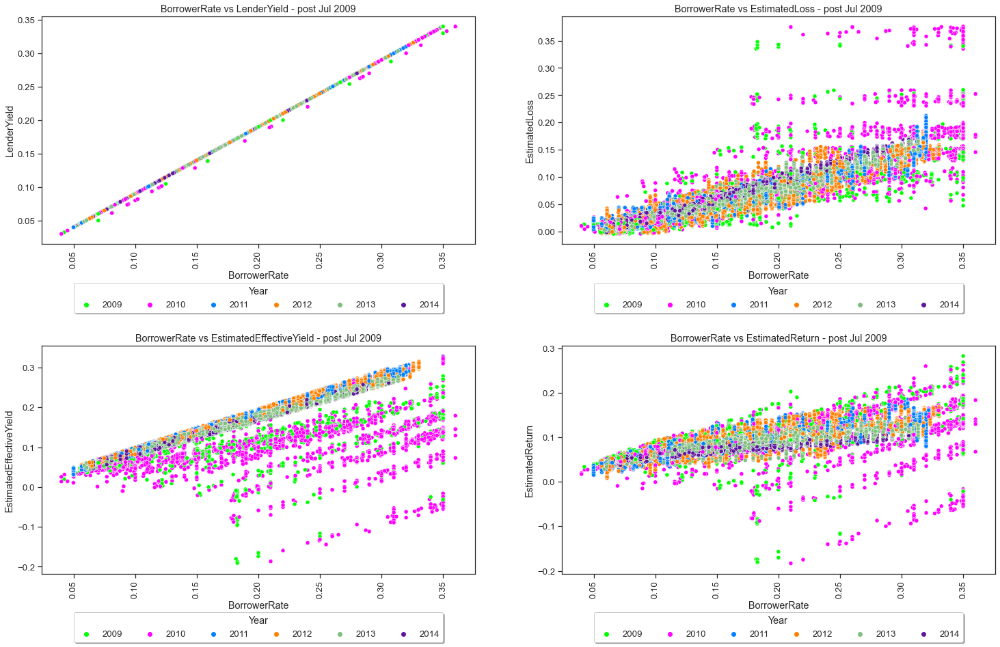

In [59]:
# The relahionship between borrowerRate and EstimateReturn, EstimatedEffectiveYield, and EstimatedLoss shows groups of data points
# What are those groups of data related to?

# lets try to segement the data by Year to see if also has an impact on how those bands are classified

# The plot below heighlights that the bands present in the relationship between those variables is present in the 2009 and 2010 years only.
# This may support the hypothesis that a possible change in the algorithm in how loan Yield, costs, loss, and ultimately Return is calculated 
# has happened from year 2011 onwards.
# Did the company move towards a linear relationship and removed negative losses from its calculation?
# Is the algorithm vetting out more HR loans in later years compared to 2009 and 2020?


from distinctipy import distinctipy
# get distinct well differentiated colours equal to number of years.
N=len(dfc_new['year'].unique().dropna())
colours = distinctipy.get_colors(N) #in seaborn palette=colors


plt.figure(figsize = [25, 15])
plt.subplots_adjust(top = 0.8, bottom=0.01, hspace=0.3, wspace=0.2) #control gap between subplots

# Use white grid plot background from seaborn
sns.set(font_scale=1.2, style="ticks")

plt.subplot(2, 2, 1)
grid = sns.scatterplot(data=dfc_new[dfc_new['BorrowerRate'].notna()], x='BorrowerRate', y='LenderYield', hue = 'year', palette=colours)
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('BorrowerRate vs LenderYield - post Jul 2009')
grid.set(xlabel='BorrowerRate', ylabel='LenderYield');
box = grid.get_position()
grid.set_position([box.x0, box.y0 + box.height * 0.1,
                 box.width, box.height * 0.9])
# Put a legend below current axis
grid.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15),
          fancybox=True, shadow=True, ncol=7, title='Year');

plt.subplot(2, 2, 2)
grid = sns.scatterplot(data=dfc_new[dfc_new['BorrowerRate'].notna()], x='BorrowerRate', y='EstimatedLoss_jitter', hue = 'year', palette=colours)
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('BorrowerRate vs EstimatedLoss - post Jul 2009')
grid.set(xlabel='BorrowerRate', ylabel='EstimatedLoss');
# Shrink current axis's height by 10% on the bottom
box = grid.get_position()
grid.set_position([box.x0, box.y0 + box.height * 0.1,
                 box.width, box.height * 0.9])
# Put a legend below current axis
grid.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15),
          fancybox=True, shadow=True, ncol=7, title='Year')

plt.subplot(2, 2, 3)
grid = sns.scatterplot(data=dfc_new[dfc_new['BorrowerRate'].notna()], x='BorrowerRate', y='EstimatedEffectiveYield_jitter', hue = 'year', palette=colours)
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('BorrowerRate vs EstimatedEffectiveYield - post Jul 2009')
grid.set(xlabel='BorrowerRate', ylabel='EstimatedEffectiveYield');
box = grid.get_position()
grid.set_position([box.x0, box.y0 + box.height * 0.1,
                 box.width, box.height * 0.9])
# Put a legend below current axis
grid.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15),
          fancybox=True, shadow=True, ncol=7, title='Year')

plt.subplot(2, 2, 4)
grid = sns.scatterplot(data=dfc_new[dfc_new['BorrowerRate'].notna() ], x='BorrowerRate', y='EstimatedReturn_jitter', hue = 'year', palette=colours)
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('BorrowerRate vs EstimatedReturn - post Jul 2009')
grid.set(xlabel='BorrowerRate', ylabel='EstimatedReturn');
box = grid.get_position()
grid.set_position([box.x0, box.y0 + box.height * 0.1,
                 box.width, box.height * 0.9])
# Put a legend below current axis
grid.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15),
          fancybox=True, shadow=True, ncol=7, title='Year');



In [60]:
dfc_new['year'].unique()

['2014', '2012', '2013', '2010', '2011', '2009']
Categories (6, object): ['2009' < '2010' < '2011' < '2012' < '2013' < '2014']

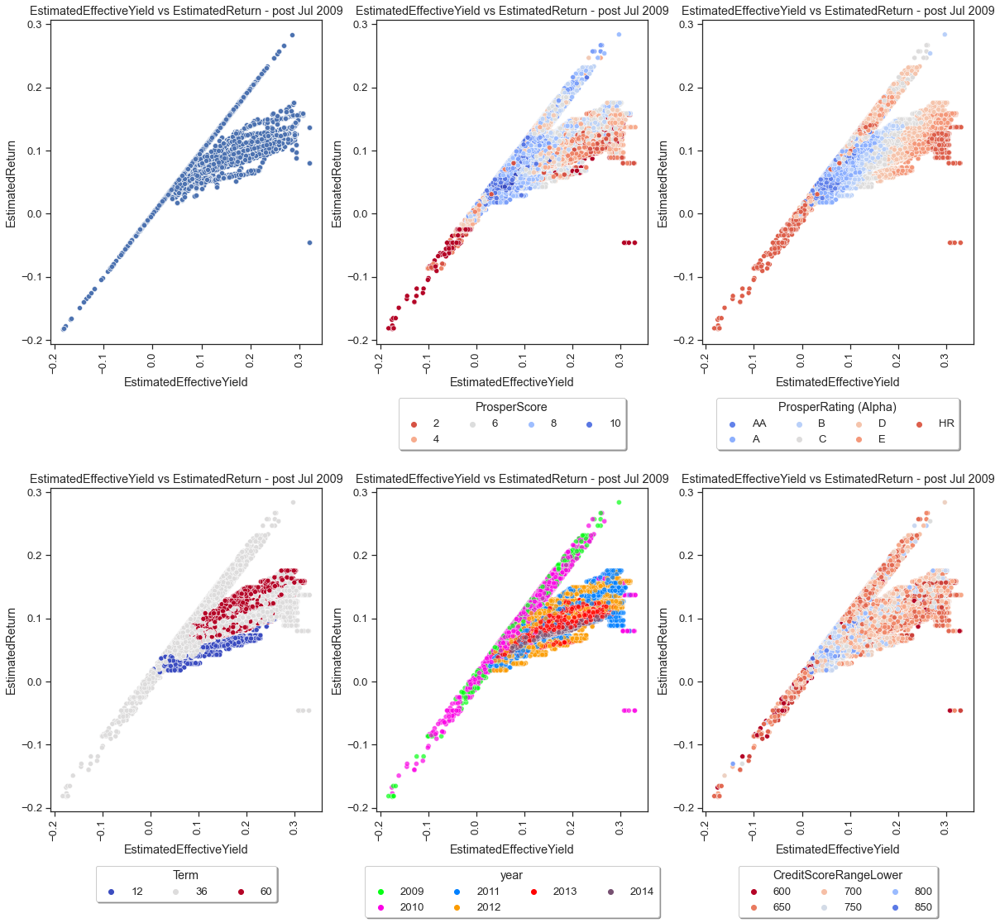

In [223]:
# The relahionship between EstimateReturn and  EstimatedEffectiveYield would be interesting to 
# investigate a bit further, specially that it encapsulates substractioin of EstimatedLoss in the relationship between them.

# lets try to segement the plot by ProsperScore, ProsperRating (Alpha), Term, Year, and CreditScoreRangeLower to see if we can glean any more insights.
# The inspection of the plots below has made a few things clearer:
# Plots 4 and 5 show the linear line in the middle is for 36 months loans which were the only loan Term in 2009 and 2010 years.
# Plot 5 shows 2013/2014 metrics relationship seem to have a narrower (smaller variance) compared to 2011/2012. This needs further analysis.
# There are two distinct groups of data; one near perfect digonal line and another that another oval swarm of data points.
# The near perfect digonal line below and bands of losses in previous plots suggests that metrics in 2009 and 2010 years were calculated using algorithms that 
# fixed losses (horizontal bands) mainly according to (ProsperRating (Alpha), ProsperScore, and CreditScoreRange Lower/Upper) which maintained a linear relationship 
# between EstimatedEffectiveYield and EstimateReturn, but also resulted into negative EstimatedReturn for some of the High Risk (HR) loans.
# Wheresas the oval swarm of data points for years 2011 onwards, suggests that metrics were calculate using algorithms that
# used a more variable calculation of losses based on factors such as (ProsperRating (Alpha), ProsperScore, and CreditScoreRange Lower/Upper)
# which resulted into less linear / larger variance direct positive relationship between EstimatedEffectiveYield and EstimateReturn without negative EstimatedReturn.


from distinctipy import distinctipy
N=len(dfc_new['year'].dropna().unique())
colours_y = distinctipy.get_colors(N) #in seaborn palette=colors
N=len(dfc_new['CreditScoreRangeLower'].dropna().unique())
colours_s = distinctipy.get_colors(N)


plt.figure(figsize = [20, 10])
plt.subplots_adjust(top = 1.4, bottom=0.01, hspace=0.3, wspace=0.2) #control gap between subplots

# Use white grid plot background from seaborn
sns.set(font_scale=1.2, style="ticks")

plt.subplot(2, 3, 1)
grid = sns.scatterplot(data=dfc_new[dfc_new['BorrowerRate'].notna()], x='EstimatedEffectiveYield', y='EstimatedReturn',  palette="coolwarm_r")#, style='ProsperRating (Alpha)'
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('EstimatedEffectiveYield vs EstimatedReturn - post Jul 2009')
grid.set(xlabel='EstimatedEffectiveYield', ylabel='EstimatedReturn');
# Shrink current axis's height by 10% on the bottom
box = grid.get_position()
grid.set_position([box.x0, box.y0 + box.height * 0.1,
                 box.width, box.height * 0.9])

plt.subplot(2, 3, 2)
grid = sns.scatterplot(data=dfc_new[dfc_new['BorrowerRate'].notna()], x='EstimatedEffectiveYield_jitter', y='EstimatedReturn', hue = 'ProsperScore', palette="coolwarm_r")#, style='ProsperRating (Alpha)'
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('EstimatedEffectiveYield vs EstimatedReturn - post Jul 2009')
grid.set(xlabel='EstimatedEffectiveYield', ylabel='EstimatedReturn');
# Shrink current axis's height by 10% on the bottom
box = grid.get_position()
grid.set_position([box.x0, box.y0 + box.height * 0.1,
                 box.width, box.height * 0.9])
grid.legend(title='ProsperScore', loc='upper center', bbox_to_anchor=(0.5, -0.15),
          fancybox=True, shadow=True, ncol=4);

plt.subplot(2, 3, 3)
grid = sns.scatterplot(data=dfc_new[dfc_new['BorrowerRate'].notna()], x='EstimatedEffectiveYield_jitter', y='EstimatedReturn', hue = 'ProsperRating (Alpha)', palette="coolwarm")#, style='ProsperRating (Alpha)'
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('EstimatedEffectiveYield vs EstimatedReturn - post Jul 2009')
grid.set(xlabel='EstimatedEffectiveYield', ylabel='EstimatedReturn');
# Shrink current axis's height by 10% on the bottom
box = grid.get_position()
grid.set_position([box.x0, box.y0 + box.height * 0.1,
                 box.width, box.height * 0.9])
grid.legend(title='ProsperRating (Alpha)', loc='upper center', bbox_to_anchor=(0.5, -0.15),
          fancybox=True, shadow=True, ncol=4);

plt.subplot(2, 3, 4)
grid = sns.scatterplot(data=dfc_new[dfc_new['BorrowerRate'].notna()], x='EstimatedEffectiveYield_jitter', y='EstimatedReturn', hue = 'Term', palette="coolwarm")#, style='ProsperRating (Alpha)'
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('EstimatedEffectiveYield vs EstimatedReturn - post Jul 2009')
grid.set(xlabel='EstimatedEffectiveYield', ylabel='EstimatedReturn');
# Shrink current axis's height by 10% on the bottom
box = grid.get_position()
grid.set_position([box.x0, box.y0 + box.height * 0.1,
                 box.width, box.height * 0.9])
grid.legend(title='Term', loc='upper center', bbox_to_anchor=(0.5, -0.15),
          fancybox=True, shadow=True, ncol=7);

plt.subplot(2, 3, 5)
grid = sns.scatterplot(data=dfc_new[dfc_new['BorrowerRate'].notna()], x='EstimatedEffectiveYield_jitter', y='EstimatedReturn', hue = 'year', palette=colours_y, alpha=0.7)#, style='ProsperRating (Alpha)' # palette="deep"
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('EstimatedEffectiveYield vs EstimatedReturn - post Jul 2009')
grid.set(xlabel='EstimatedEffectiveYield', ylabel='EstimatedReturn');
# Shrink current axis's height by 10% on the bottom
box = grid.get_position()
grid.set_position([box.x0, box.y0 + box.height * 0.1,
                 box.width, box.height * 0.9])
grid.legend(title='year', loc='upper center', bbox_to_anchor=(0.5, -0.15),
          fancybox=True, shadow=True, ncol=4);

plt.subplot(2, 3, 6)
grid = sns.scatterplot(data=dfc_new[dfc_new['BorrowerRate'].notna()], x='EstimatedEffectiveYield_jitter', y='EstimatedReturn', hue = 'CreditScoreRangeLower', palette="coolwarm_r")#palette="colours_s", style='ProsperRating (Alpha)', palette="cubehelix"
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('EstimatedEffectiveYield vs EstimatedReturn - post Jul 2009')
grid.set(xlabel='EstimatedEffectiveYield', ylabel='EstimatedReturn');
# Shrink current axis's height by 10% on the bottom
box = grid.get_position()
grid.set_position([box.x0, box.y0 + box.height * 0.1,
                 box.width, box.height * 0.9])
grid.legend(title='CreditScoreRangeLower', loc='upper center', bbox_to_anchor=(0.5, -0.15),
          fancybox=True, shadow=True, ncol=3);

In [221]:
colours_y

[(0.014336994749661325, 0.9886943961435176, 0.18714344491848878),
 (1.0, 0.0, 1.0),
 (1.0, 0.5, 0.0),
 (0.015248875184827648, 0.3812746939002396, 0.9667256857476108),
 (0.0, 1.0, 1.0),
 (0.540115739931006, 0.6709214489724704, 0.5606000443733145)]

In [222]:
# confrim 12 and 60 Temrs introduced in 2011. very small numbers in 2010, which are probably negligible

dfc_new.groupby(['year', 'Term'])['Term'].count()

year  Term
2009  12          0
      36       2014
      60          0
2010  12         13
      36       5608
      60         31
2011  12        547
      36       9651
      60       1030
2012  12        782
      36      12516
      60       6255
2013  12        272
      36      20706
      60      13367
2014  12          0
      36       8310
      60       3862
Name: Term, dtype: int64

/Users/salih/opt/anaconda3/envs/myenv2/lib/python3.8/site-packages/seaborn/axisgrid.py:670: UserWarning: Using the countplot function without specifying `order` is likely to produce an incorrect plot.
  warnings.warn(warning)


<Figure size 1440x720 with 0 Axes>

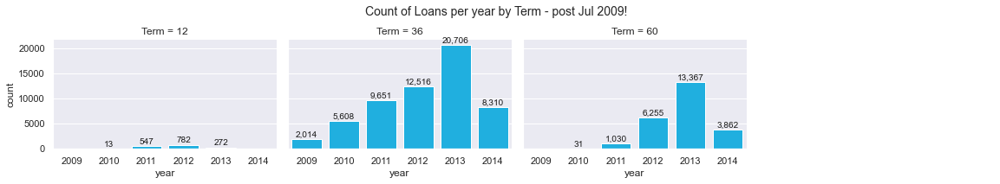

In [195]:
# confrim 12 and 60 Temrs introduced in 2011. very small numbers in 2010, which are probably negligible

def annotate_bars(ax=None, fmt='.0f', **kwargs): #'.2f' ',f'
    ax = plt.gca() if ax is None else ax
    # add labels to bars
    for p in ax.patches:
        ax.annotate('{{:{:s}}}'.format(fmt).format(p.get_height()), (p.get_x() + p.get_width() / 2., p.get_height()),
                     xytext=(0, 5),textcoords='offset points',
                     ha='center', va='center', **kwargs)
        p.set_edgecolor('white') # white is default, but can change to red to make small bars more visible!

plt.figure(figsize = [20, 10])
sns.set_theme()

sns.set(font_scale=1) # change plots individual title size.
grid = sns.FacetGrid(data=dfc_new, col='Term', col_wrap=4, margin_titles=True, height=3, aspect= 1.33)
grid.map(sns.countplot, 'year', color='deepskyblue', alpha=1.0); 
grid.map(annotate_bars, fmt=',.0f', fontsize=10, color='k') #='.2g'
grid.fig.subplots_adjust(top=0.8)
grid.fig.suptitle('Count of Loans per year by Term - post Jul 2009!', fontsize=14);
grid.add_legend();

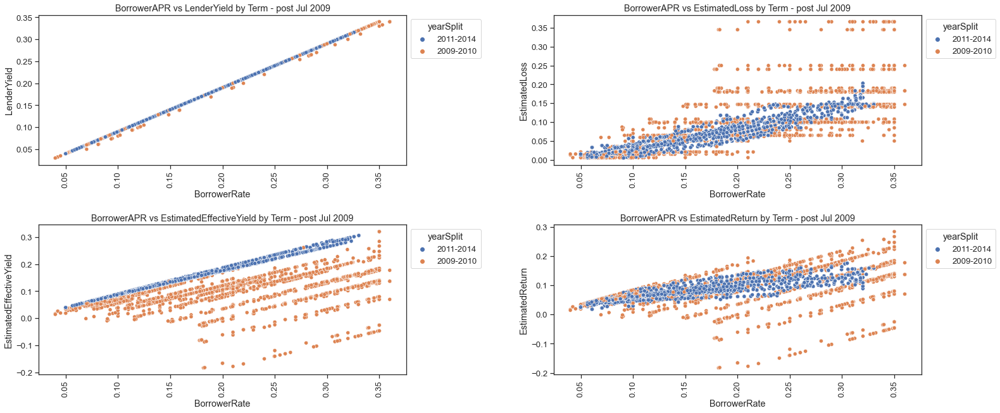

In [77]:
# The relahionship between borrowerRate and EstimateReturn, EstimatedEffectiveYield, and EstimatedLoss shows groups of data points
# What are those groups of data related to?
# lets try to segement the data by Periods, which may help explain the different data groupings in the plot.

# The plots shows that some of the variance observed can be explained by the Periods, 
# The horziontal bands are present in the 2009-2010 period, whiles in the 2011-2014 period it takes a diagonal swarm of data.
# The 2009-2010 have fixed EstimatedLoss values causing those horizontal bands of data to appear. Whereas, 2011-2014 have a incremental EstimatedLoss causing a diagonal swarm of data

plt.figure(figsize = [25, 10])
plt.subplots_adjust(top = 0.8, bottom=0.01, hspace=0.4, wspace=0.4) #control gap between subplots
palette = sns.color_palette("deep", 2) #Paired

# Use white grid plot background from seaborn
sns.set(font_scale=1.2, style="ticks")

plt.subplot(2, 2, 1)
#dfc_new['ListingCategory'].value_counts()
grid = sns.scatterplot(data=dfc_new[dfc_new['BorrowerRate'].notna()], x='BorrowerRate', y='LenderYield', hue = 'yearSplit', palette=palette) # , style='LoanStatus'
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('BorrowerAPR vs LenderYield by Term - post Jul 2009')
grid.set(xlabel='BorrowerRate', ylabel='LenderYield');
sns.move_legend(grid, "upper left", bbox_to_anchor=(1, 1));

plt.subplot(2, 2, 2)
#dfc_new['ListingCategory'].value_counts()
grid = sns.scatterplot(data=dfc_new[dfc_new['BorrowerRate'].notna()], x='BorrowerRate', y='EstimatedLoss', hue = 'yearSplit', palette=palette) # , style='LoanStatus'
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('BorrowerAPR vs EstimatedLoss by Term - post Jul 2009')
grid.set(xlabel='BorrowerRate', ylabel='EstimatedLoss');
sns.move_legend(grid, "upper left", bbox_to_anchor=(1, 1));

plt.subplot(2, 2, 3)
#dfc_new['ListingCategory'].value_counts()
grid = sns.scatterplot(data=dfc_new[dfc_new['BorrowerRate'].notna()], x='BorrowerRate', y='EstimatedEffectiveYield', hue = 'yearSplit', palette=palette)
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('BorrowerAPR vs EstimatedEffectiveYield by Term - post Jul 2009')
grid.set(xlabel='BorrowerRate', ylabel='EstimatedEffectiveYield');
sns.move_legend(grid, "upper left", bbox_to_anchor=(1, 1));

plt.subplot(2, 2, 4)
#dfc_new['ListingCategory'].value_counts()
grid = sns.scatterplot(data=dfc_new[dfc_new['BorrowerRate'].notna()], x='BorrowerRate', y='EstimatedReturn', hue = 'yearSplit', palette=palette)
grid.tick_params(axis='x', labelrotation=90)
grid.set_title('BorrowerAPR vs EstimatedReturn by Term - post Jul 2009')
grid.set(xlabel='BorrowerRate', ylabel='EstimatedReturn');
sns.move_legend(grid, "upper left", bbox_to_anchor=(1, 1));



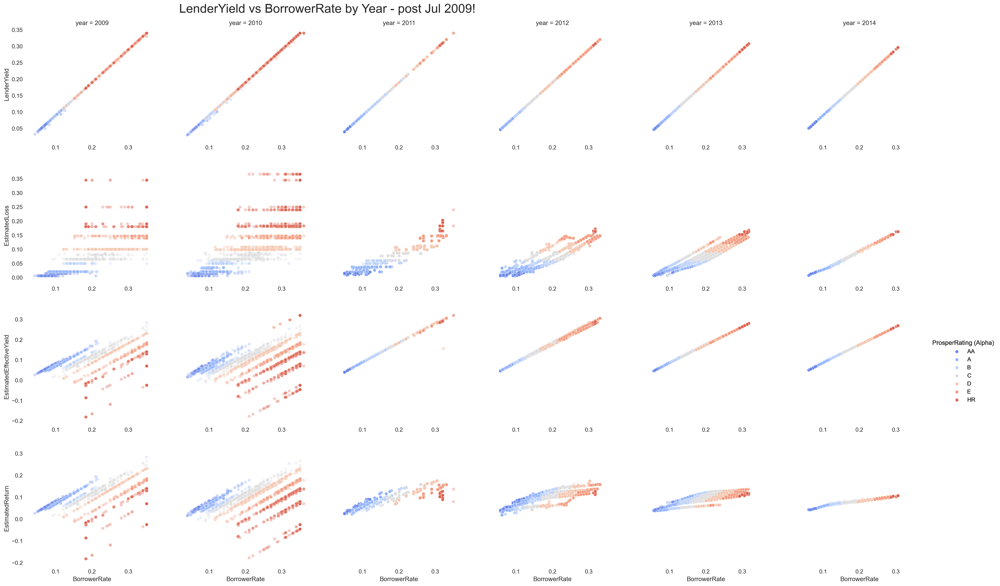

In [93]:
# Faceting the BorrowerRate vs EstimatedLoss, EstimatedEffectiveyield, and EstimatedReturn relationships by year

# This shows the Estimated Loss different calcualtions changes from fixed bands with very high variance in 2009, and 2010 towards a more linear (small variance) relationship
# in 2011, 2012, 2013 and then finally a nearly perfect linear relationship in 2014.

import patchworklib as pw

pw.overwrite_axisgrid()

sns.set_theme()
sns.set_style("darkgrid")#, {"axes.spines.left": True,'axes.spines.bottom':True}

grid1 = sns.FacetGrid(data=dfc_new, col='year', hue = 'ProsperRating (Alpha)', col_wrap=6, palette="coolwarm", margin_titles=False, height=3, aspect= 1.33)
grid1.map(sns.scatterplot, 'BorrowerRate' , 'LenderYield',  alpha=0.3);
grid1.fig.subplots_adjust(top=0.8)
grid1.fig.suptitle('LenderYield vs BorrowerRate by Year - post Jul 2009!', fontsize=24, x=8, y=15)
grid1.set_axis_labels("", "LenderYield")

grid1 = pw.load_seaborngrid(grid1, label="g1")

grid2 = sns.FacetGrid(data=dfc_new, col='year', hue = 'ProsperRating (Alpha)', col_wrap=6, palette="coolwarm", margin_titles=False, height=3, aspect= 1.33)
grid2.map(sns.scatterplot, 'BorrowerRate' , 'EstimatedLoss',  alpha=0.3);
grid2.set_axis_labels("", "EstimatedLoss")
grid2.set_titles("")
#showsplines(grid2)
grid2 = pw.load_seaborngrid(grid2, label="g2")

grid3 = sns.FacetGrid(data=dfc_new, col='year', hue = 'ProsperRating (Alpha)', col_wrap=6, palette="coolwarm", margin_titles=False, height=3, aspect= 1.33)
grid3.map(sns.scatterplot, 'BorrowerRate' , 'EstimatedEffectiveYield',  alpha=0.3)
grid3.set_axis_labels("", "EstimatedEffectiveYield")
grid3.set_titles("")
grid3.add_legend()
# showsplines(grid3)
grid3 = pw.load_seaborngrid(grid3, label="g3")

grid4 = sns.FacetGrid(data=dfc_new, col='year', hue = 'ProsperRating (Alpha)', col_wrap=6, palette="coolwarm", margin_titles=False, height=3, aspect= 1.33)
grid4.map(sns.scatterplot, 'BorrowerRate' , 'EstimatedReturn',  alpha=0.3);
grid4.set_titles("")
# showsplines(grid4)
grid4 = pw.load_seaborngrid(grid4, label="g4")

sns.set_style("darkgrid")
        
(grid1/grid2/grid3/grid4)


<Figure size 1440x720 with 0 Axes>

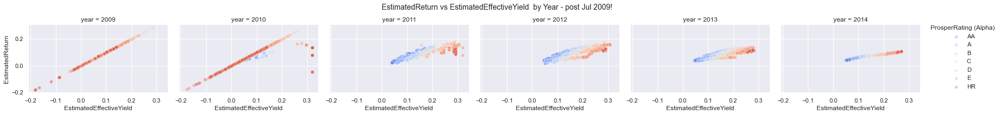

In [266]:
# To see the above yearly changes, let's facetGrid the plot by year

# This plot clearly shows the shift from negative metrics in 2009 and 2010 to positive metrics in 2011-2014.
# It also shows the move from wide variance in 2011, 2012, and 2013 to a linear (small variance) in 2014.
# Also, there was a lot of overlap in earlier years (2009 and 2010) between lower ProsperRating (Alpha) and higher ProsperRating (Alpha) levels for EstimatedReturn. 
# This overlap continued narrow down until year 2014 where the overlap has been reduced to approximately zero due to the sequential linar relationship the 
# ProsperRating (Alpha) levels are made to move along.

plt.figure(figsize = [20, 10])

sns.set(font_scale=1) # change plots individual title size.
grid = sns.FacetGrid(data=dfc_new, col='year', hue = 'ProsperRating (Alpha)', col_wrap=6, palette="coolwarm",  margin_titles=True, height=3, aspect= 1.33)# control facitgrid graph widths: margin_titles=True, height=3, aspect= 1.33
grid.map(sns.scatterplot, 'EstimatedEffectiveYield', 'EstimatedReturn' , alpha=0.3); # remove binwidth if you want auto generated different bin widths for each plot.
grid.fig.subplots_adjust(top=0.8)
grid.fig.suptitle('EstimatedReturn vs EstimatedEffectiveYield  by Year - post Jul 2009!', fontsize=14);
grid.add_legend();

<Figure size 1440x720 with 0 Axes>

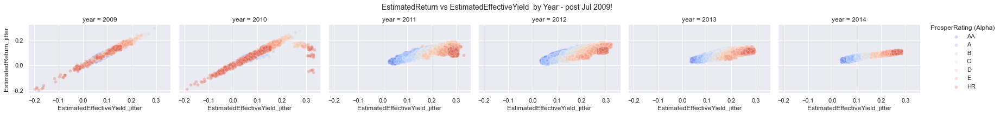

In [261]:
# Intorducing a bit of jitter on the previous plot, makes the high ProsperRating (Alpha) ponts clear in 2009 and 2010

plt.figure(figsize = [20, 10])

sns.set(font_scale=1) # change plots individual title size.
grid = sns.FacetGrid(data=dfc_new, col='year', hue = 'ProsperRating (Alpha)', col_wrap=6, palette="coolwarm",  margin_titles=True, height=3, aspect= 1.33)# control facitgrid graph widths: margin_titles=True, height=3, aspect= 1.33
grid.map(sns.scatterplot, 'EstimatedEffectiveYield_jitter', 'EstimatedReturn_jitter' , alpha=0.3); # remove binwidth if you want auto generated different bin widths for each plot.
grid.fig.subplots_adjust(top=0.8)
grid.fig.suptitle('EstimatedReturn vs EstimatedEffectiveYield  by Year - post Jul 2009!', fontsize=14);
grid.add_legend();

<Figure size 1440x720 with 0 Axes>

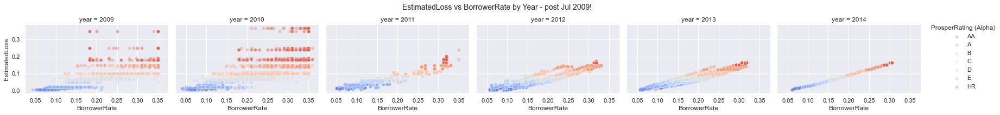

In [66]:
# Faceting the EstimatedLoss vs BorrowerRate relationship by year

# This shows the Estimated Loss different calcualtions changes from fixed bands with very high variance in 2009, and 2010 towards a more linear (small variance) relationship
# in 2011, 2012, 2013 and then finally a nearly perfect linear relationship in 2014. 

plt.figure(figsize = [20, 10])

sns.set(font_scale=1) # change plots individual title size.
grid = sns.FacetGrid(data=dfc_new, col='year', hue = 'ProsperRating (Alpha)', col_wrap=6, palette="coolwarm",  margin_titles=True, height=3, aspect= 1.33)# control facitgrid graph widths: margin_titles=True, height=3, aspect= 1.33
grid.map(sns.scatterplot, 'BorrowerRate' , 'EstimatedLoss',  alpha=0.3); # remove binwidth if you want auto generated different bin widths for each plot.
grid.fig.subplots_adjust(top=0.8)
grid.fig.suptitle('EstimatedLoss vs BorrowerRate by Year - post Jul 2009!', fontsize=14);
grid.add_legend();

<Figure size 1440x720 with 0 Axes>

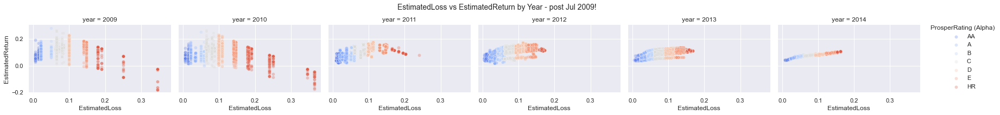

In [224]:
# Faceting the EstimatedLoss vs BorrowerRate relationship by year

# This shows the Estimated Loss different calcualtions changes from fixed bands with very high variance in 2009, and 2010 towards a more linear (small variance) relationship
# in 2011, 2012, 2013 and then finally a nearly perfect linear relationship in 2014. 

plt.figure(figsize = [20, 10])

sns.set(font_scale=1) # change plots individual title size.
grid = sns.FacetGrid(data=dfc_new, col='year', hue = 'ProsperRating (Alpha)', col_wrap=6, palette="coolwarm",  margin_titles=True, height=3, aspect= 1.33)# control facitgrid graph widths: margin_titles=True, height=3, aspect= 1.33
grid.map(sns.scatterplot, 'EstimatedLoss', 'EstimatedReturn' , alpha=0.3); # remove binwidth if you want auto generated different bin widths for each plot.
grid.fig.subplots_adjust(top=0.8)
grid.fig.suptitle('EstimatedLoss vs EstimatedReturn by Year - post Jul 2009!', fontsize=14);
grid.add_legend();

<Figure size 1440x720 with 0 Axes>

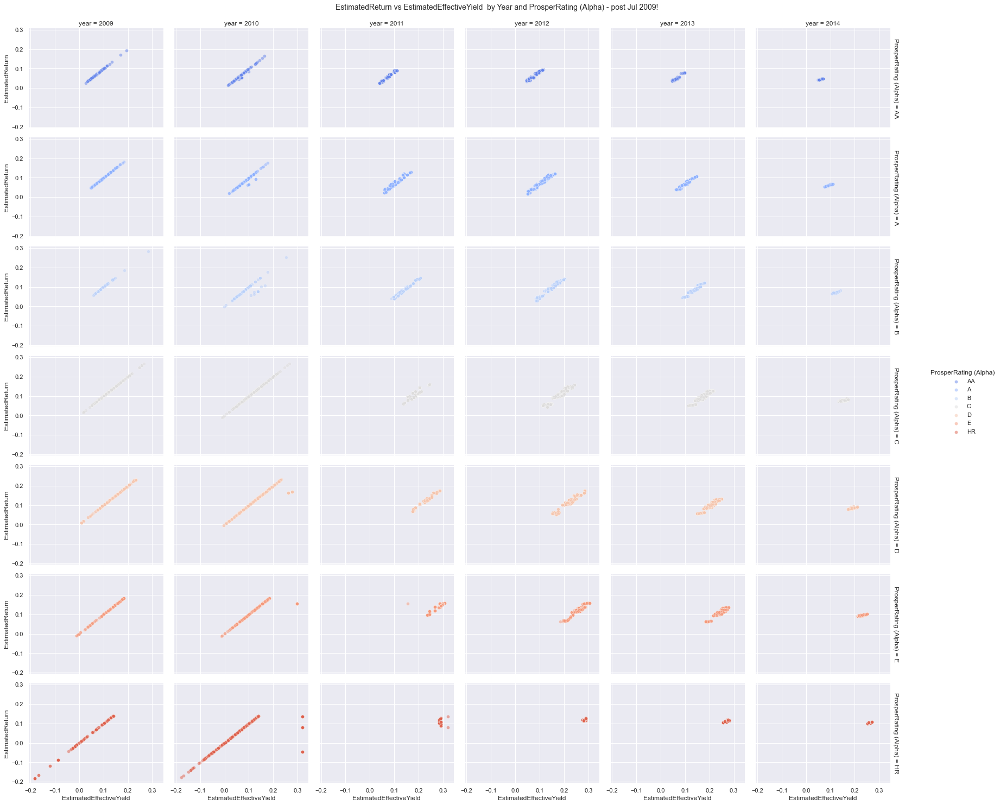

In [239]:
# let's facet EstimatedEffectiveYield vs EstimatedReturn by year and ProsperRating (Alpha) to see the trends of each ProspectRating (Alpha) change by year.

# This plot supports the observations made in previous plots. In ear

plt.figure(figsize = [20, 10])

sns.set(font_scale=1) # change plots individual title size.
grid = sns.FacetGrid(data=dfc_new, col='year', row="ProsperRating (Alpha)", hue = 'ProsperRating (Alpha)', palette="coolwarm",  margin_titles=True, height=3, aspect= 1.33)# control facitgrid graph widths: margin_titles=True, height=3, aspect= 1.33
grid.map(sns.scatterplot, 'EstimatedEffectiveYield', 'EstimatedReturn' , alpha=0.5); # remove binwidth if you want auto generated different bin widths for each plot.
grid.fig.subplots_adjust(top=0.95)
grid.fig.suptitle('EstimatedReturn vs EstimatedEffectiveYield  by Year and ProsperRating (Alpha) - post Jul 2009!', fontsize=14);
grid.add_legend();

<Figure size 1440x720 with 0 Axes>

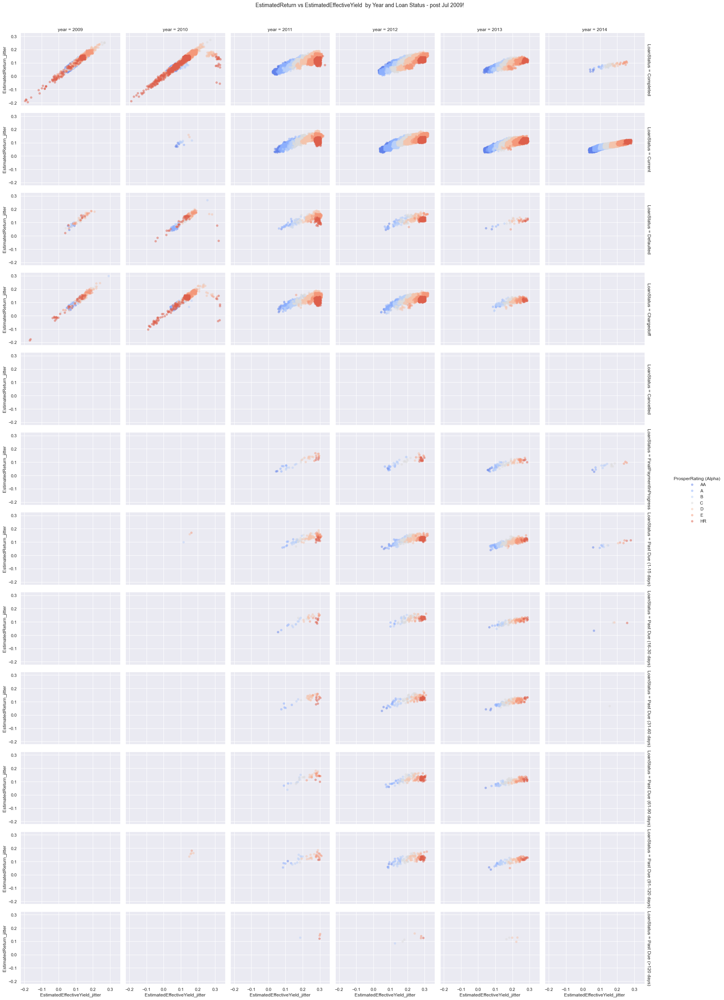

In [251]:
# let's facet EstimatedEffectiveYield vs EstimatedReturn by year and LoanStatus and segment plot by ProsperRating (Alpha)

# This plot supports the observations made in previous explorations, where all levels from ProsperRating (Alpha) are present in all LoanStatuses
# Defaulted, Chargedoff, and Past Due Date have loans classifed with high ProsperRating (Alpha) all the way to low ProsperRating (Alpha), which is not what was expected.
# It was expected that Chagedoff and Defaulted would be dominated by very low PropserRating (Alpha) level e.g. HR and E.

from distinctipy import distinctipy
N=len(dfc_new['ProsperRating (Alpha)'].dropna().unique())
#colors = distinctipy.get_colors(N) #in seaborn palette=colors

colors = sns.color_palette("coolwarm", N)

plt.figure(figsize = [20, 10])

sns.set(font_scale=1) # change plots individual title size.
grid = sns.FacetGrid(data=dfc_new, col='year', row="LoanStatus", hue = 'ProsperRating (Alpha)', palette="coolwarm", margin_titles=True, height=3, aspect= 1.33)# control facitgrid graph widths: margin_titles=True, height=3, aspect= 1.33
grid.map(sns.scatterplot, 'EstimatedEffectiveYield_jitter', 'EstimatedReturn_jitter' , edgecolor='none' , alpha=0.5); #edgecolor='w'
grid.fig.subplots_adjust(top=0.95)
grid.fig.suptitle('EstimatedReturn vs EstimatedEffectiveYield  by Year and Loan Status - post Jul 2009!', fontsize=14);
grid.add_legend();

<Figure size 1440x720 with 0 Axes>

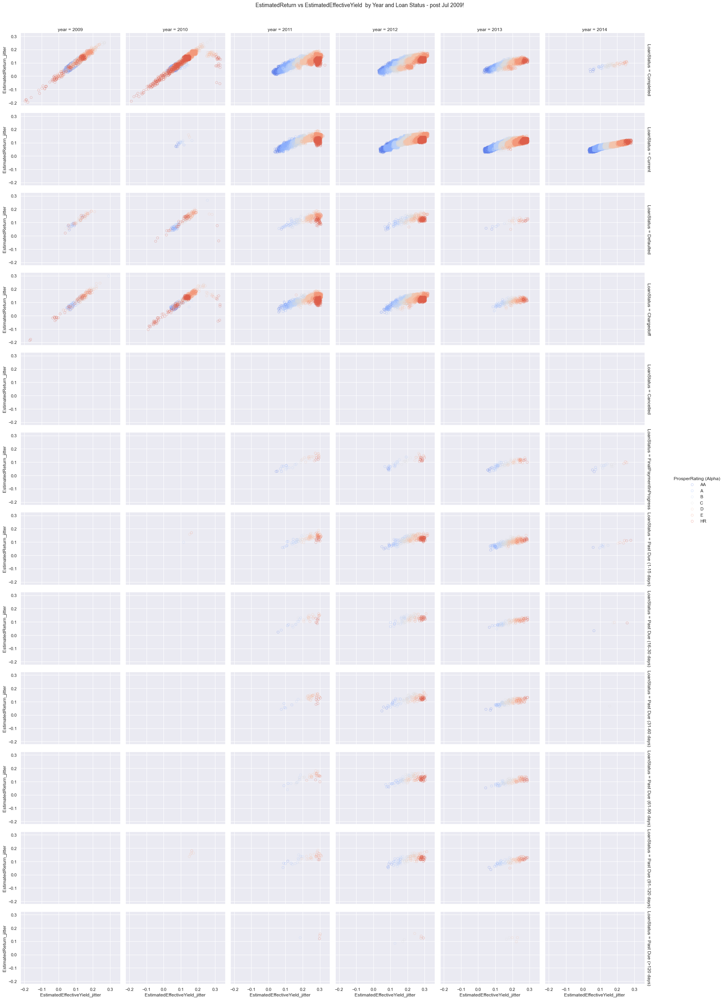

In [252]:
# Let's change the shape from solid dots to circles to try to and improve visibility of covered /plotted over points. 

# It is a bit better and clearer to see blue and orange dots for 2009 and 201o years. We can see that the above observations are confirmed again here.

from distinctipy import distinctipy
N=len(dfc_new['ProsperRating (Alpha)'].dropna().unique())
#colors = distinctipy.get_colors(N) #in seaborn palette=colors

colors = sns.color_palette("coolwarm", N)

plt.figure(figsize = [20, 10])

sns.set(font_scale=1) # change plots individual title size.
grid = sns.FacetGrid(data=dfc_new, col='year', row="LoanStatus", hue = 'ProsperRating (Alpha)', palette="coolwarm", hue_kws={"edgecolor": colors}, margin_titles=True, height=3, aspect= 1.33)# control facitgrid graph widths: margin_titles=True, height=3, aspect= 1.33
grid.map(sns.scatterplot, 'EstimatedEffectiveYield_jitter', 'EstimatedReturn_jitter' , facecolor="none", lw=2 , alpha=0.7); #edgecolor='w'
grid.fig.subplots_adjust(top=0.95)
grid.fig.suptitle('EstimatedReturn vs EstimatedEffectiveYield  by Year and Loan Status - post Jul 2009!', fontsize=14);
grid.add_legend();

In [245]:
colors

[(0.08277859107341545, 0.9994755631798604, 0.08264807473525793),
 (1.0, 0.0, 1.0),
 (0.0, 0.5, 1.0),
 (1.0, 0.5, 0.0),
 (0.5, 0.25, 0.5),
 (0.34412648081084585, 0.9874837234699495, 0.7550496959840735),
 (0.7652288175521215, 0.9997089296531982, 0.10669117965904995)]

In [383]:
[dfc['LoanKey'].nunique(), dfc['ListingKey'].nunique(),
dfc['LoanKey'].count(), dfc['ListingKey'].count(),
dfc['LoanKey'].size, dfc['ListingKey'].size]

[113066, 113066, 113937, 113937, 113937, 113937]

# Did the changes make a positive impact?
- Did the change in metric Calculations result into declining more bad loans? this may be a difficult question to answer as we don't seem to have the declined loans data to make comaprisons.
- Did the change in metric calculations result into reduction in charge off / Default / Past Due Date? We may be able to see some evidence to support answering this questions, however we may need extra years to see the impact trickling in in the years to follow!
- Are we seeing better EstimatedReturn in latter years vs earlier years or not?


In [339]:
# let's group the data and calculate the percent of LoanStatus for each year to that year total

grouped = dfc_new.groupby(['year','LoanStatus'])['ListingKey'].count().reset_index().rename(columns={'ListingKey':'count'})
grouped['subTotal']=grouped.groupby(['year'])['count'].transform('sum')
grouped['percent'] = grouped['count']/grouped['subTotal']

pd.reset_option('display.max_rows')
grouped.head(30)


,year,LoanStatus,count,subTotal,percent
0,2009,Completed,1708,2014,0.848064
1,2009,Current,0,2014,0.000000
2,2009,Defaulted,77,2014,0.038232
3,2009,Chargedoff,229,2014,0.113704
4,2009,Cancelled,0,2014,0.000000
5,2009,FinalPaymentInProgress,0,2014,0.000000
6,2009,Past Due (1-15 days),0,2014,0.000000
7,2009,Past Due (16-30 days),0,2014,0.000000
8,2009,Past Due (31-60 days),0,2014,0.000000
9,2009,Past Due (61-90 days),0,2014,0.000000


<Figure size 1440x720 with 0 Axes>

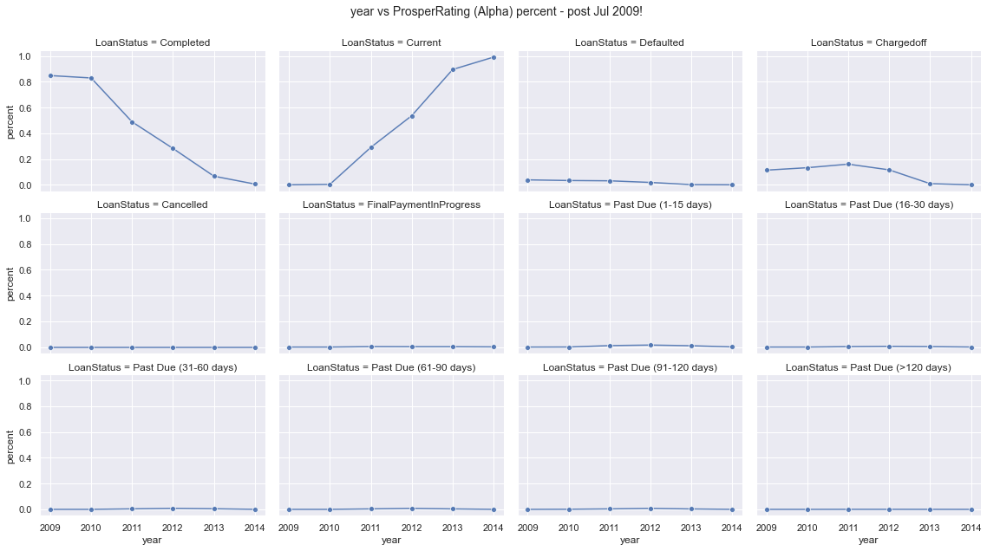

In [349]:
# lets plot the above table for visual inspection

# The decline in Completed and increasse Current LoanStatuses makes sense as years increase.

# What is interesting is Defualted and Chargedoff are both showing a decline from 2012 onwards. However, we can't attribute this positive change to the new calculations 
# intorudced. It can take a few years for the effect of those change to show up specially that majority of loans are 36 months or longer.
# One would have to execute statistical experiments to contorl for variables of interest and gain statistical confidence for effect of changes in algorithms. 

plt.figure(figsize = [20, 10])

sns.set(font_scale=1) # change plots individual title size.
grid = sns.FacetGrid(data=grouped, col='LoanStatus', col_wrap=4, palette="coolwarm",  margin_titles=True, height=3, aspect= 1.33)# control facitgrid graph widths: margin_titles=True, height=3, aspect= 1.33
grid.map(sns.lineplot, 'year', 'percent' ,  marker='o', alpha=0.9); 
grid.fig.subplots_adjust(top=0.9)
grid.fig.suptitle('year vs ProsperRating (Alpha) percent - post Jul 2009!', fontsize=14);
grid.add_legend();

#sns.lineplot(data=grouped.query("LoanStatus='Chargedoff'"), x="year", y="percent")

In [352]:
# let's segement the data further by ProsperRating (Alpha) to explore changes at ProsperRating (Alpha) lower ratings

grouped = dfc_new.groupby(['year','LoanStatus','ProsperRating (Alpha)'])['ListingKey'].count().reset_index().rename(columns={'ListingKey':'count'})
grouped['subTotal']=grouped.groupby(['year','LoanStatus'])['count'].transform('sum')
grouped['percent'] = grouped['count']/grouped['subTotal']

pd.reset_option('display.max_rows')
grouped.head(30)


,year,LoanStatus,ProsperRating (Alpha),count,subTotal,percent
0,2009,Completed,AA,276,1659,0.166365
1,2009,Completed,A,414,1659,0.249548
2,2009,Completed,B,81,1659,0.048825
3,2009,Completed,C,325,1659,0.195901
4,2009,Completed,D,257,1659,0.154913
5,2009,Completed,E,149,1659,0.089813
6,2009,Completed,HR,157,1659,0.094635
7,2009,Current,AA,0,0,NaN
8,2009,Current,A,0,0,NaN
9,2009,Current,B,0,0,NaN


<Figure size 1440x720 with 0 Axes>

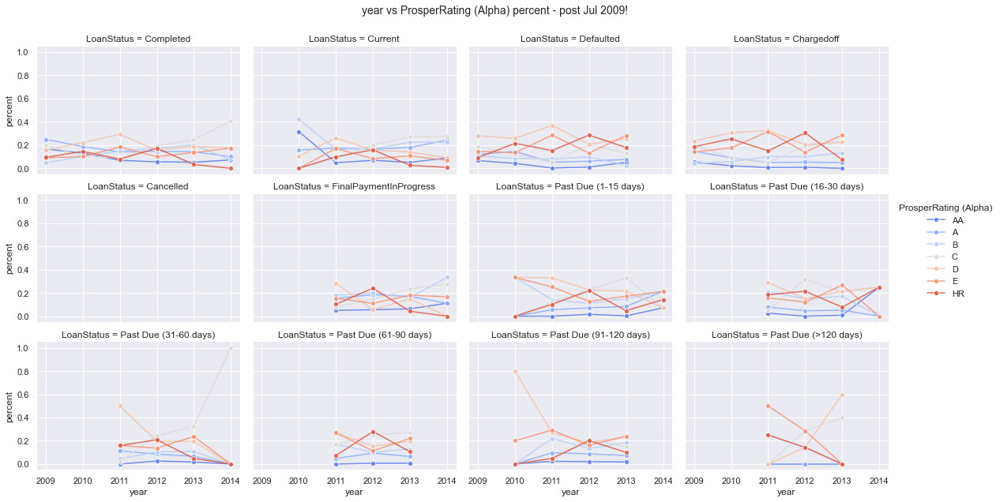

In [353]:
# let's plot the data table above for visual inspection

# Clearly the Defaulted, Chargedoff, and Past Due Date overall show that lower ProsperRating (Alpha) levels have higher chances of defualting, chargeoff, and missing payments.
# This is observed by the red/orange lines having coming above the blue lines in the Defaulted, Chargedoff, and Past Due Date plots.
# Current loans, shows 2010 having higher levels of ProsperRating (Alpha) present, but 2011 and 2012 shoing higher percent of lower ProsperRating (Alpha) levels present, 
# then 2013 and 2014 moving towards higher presence of higher ProsperRating (Alpha) levels in the data.
# There seems to be a slight trend where percent of higher ProsperRating (Alpha) levels dropping down in the Defaulted and Chargedoff statuses plot for latter years. Which
# indicates some improvements have been achieved in correctly predicting loans statuses and future losses.
# The trends are not very strong, and while we can see some improvements were achieved in the latter years in correctly predicting loan statuses and future losses, 
# there still remains a level of variance in the plots, which makes it hard to be certain, and it remains to be verified by getting extracts for 3-4 
# more years after 2014 to observe the trend better.
# The observations also needs to be verified by running statistical AB testing programme against the changes vs a control group to see if new changes have made 
# positive impact at what level of certainty.


plt.figure(figsize = [20, 10])

sns.set(font_scale=1) # change plots individual title size.
grid = sns.FacetGrid(data=grouped, col='LoanStatus', col_wrap=4, hue = 'ProsperRating (Alpha)', palette="coolwarm",  margin_titles=True, height=3, aspect= 1.33)# control facitgrid graph widths: margin_titles=True, height=3, aspect= 1.33
grid.map(sns.lineplot, 'year', 'percent' ,  marker='o', alpha=0.9); 
grid.fig.subplots_adjust(top=0.9)
grid.fig.suptitle('year vs ProsperRating (Alpha) percent - post Jul 2009!', fontsize=14);
grid.add_legend();


In [61]:
# What is the average EstimatedReturn per year? and does it show any change over time?

# lets make sum calcs first:

grouped = dfc_new.groupby(['year']).agg({'EstimatedReturn':[np.mean, np.median]}).reset_index()
grouped.columns = ['_'.join(tup).rstrip('_') for tup in grouped.columns.values]
grouped

,year,EstimatedReturn_mean,EstimatedReturn_median
0,2006,NaN,NaN
1,2007,NaN,NaN
2,2008,NaN,NaN
3,2009,0.103576,0.0986
4,2010,0.103485,0.1011
5,2011,0.115449,0.1232
6,2012,0.109900,0.1150
7,2013,0.088483,0.0876
8,2014,0.072777,0.0740


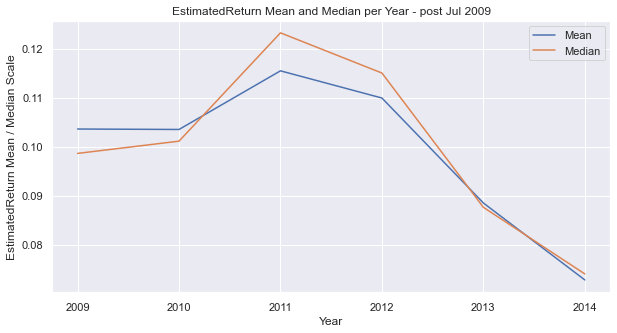

In [59]:
# What is the average EstimatedReturn per year? and does it show any change over time?

# lets plot the above table for visual inspection

# The average EstimatedReturn increased to a peak value of 0.115 in year 2011, but it declined since then to reach 0.072 in 2014.

plt.figure(figsize = [10, 5])

sns.set(font_scale=1) # change plots individual title size.
gmean = sns.lineplot(data=grouped, x="year", y="EstimatedReturn_mean", label = 'Mean')
gmedian = sns.lineplot(data=grouped, x="year", y="EstimatedReturn_median", label = 'Median')
plt.xlabel("Year")
plt.ylabel("EstimatedReturn Mean / Median Scale")
plt.title("EstimatedReturn Mean and Median per Year - post Jul 2009")
plt.legend() # neeeds , label = 'Mean' added to plot code to work!
plt.show();



### Talk about some of the relationships you observed in this part of the investigation. Were there features that strengthened each other in terms of looking at your feature(s) of interest?

- LenderYield was borken down by category and period (pre vs post Jul 2009). It was interesting to see higher LenderYield for post 2009 vs pre Jul 2009 loans.
- When plotting the Histogram Distribution of EstimatedReturn and LenderYield faceted by ListingCategories and ignoring Other and No Available categories, Debit Consolidation was the overall dominant ListingCategory (62.8% post Jul 2009 and 17% pre Jul 2009). Home Improvement and Business came next (8% and 6% post Jul 2009).
- When plotting the Histogram Distribution of LenderYield faceted by Listingcategories and segmented by Term, It can be seen that 36 months loans were the domenant loans for all ListingCategories. which confirms previous univariate analysis of Term, but also shows that this trend is present is all ListingCategories and not confined to one category. Also, we can spot 36 months Terms having an unusal high peak at 0.3 x-axis bin value.
- When plotting the Histogram Distribution of LenderYield by ProsperScore and Term, the high peak at 0.3 LenderYield appeared for ProsperScore 3,4, and 5.
- When plotting the Histogram Distribution of LenderYield by ProsperRating (Alpha), it became clear the 0.3 peak of LenderYield is associated with the High Risk (HR) type Loans.
- When plotting the Histogram Distribution of LenderYield by CreditGrade for pre Jul 2009 data, one can't see the unusal peak at 0.3, but instead can see 2 peaks one at about 0.28 and another at about 0.34, which are present for lower CreditGrade loans D, E, and HR. There are other peaks that appears for example; at 0.09 for CreditGrade C, and  0.23 and 0.24 for CreditGrade D!
- Plotting Loan Date Distribution by Term revealed that pre Jul 2009 data had 26 months Term loans, whilest 12 months and 60 months Term loans were introduced in Nov 2010.
- Plotting the Histogram Distribution of LenderYield by CreditGrade and CreditScoreRangeLower for pre Jul 2009 data, it was possible to see that that CreditGrade and CreditScoreRangeLower had similar pattern where lower values and higher from both metrics matched. It was also possible to see that as the values of CreditGrade and CreditScoreRangeLower moved down the scale, the LenderYield increased, which is likely to compensate for the higher risk and losses expected.
- When plotting Histogram Distribution of LenderYield by Listingcategories and CreditScoreRangeLower, the previously observed trend LenderYield increasing as CreditScoreRangeLower deceased on the scale is applicable to all categories.
- Again when plotting Histogram Distribution of LenderYield by Listingcategories and CreditGrade, the very same trend is noticable and also shows much greater correlation between LenderYield increasing as CreditGrade decreased in the scale than CreditScoreRangeLower.

- When plotting BorrowerAPR vs EstimatedLoss by Term it revealed two groups of data. One shows a horizontal bands of data that seems to be predomenatly 36 months Term Loans, and one that is a diagonal swarm of data that seem to be a mix of 12, 36, and 60 months Term loans. This relationship manifested itself in the BorrowerAPR vs EstimatedEffectiveYield, and EstimatedReturn plots too albiet in a slightly different arrangmenet but still clearly showing two groups of data relationships one solely related to 36 months loans, and one related a mix of 12, 36, and 60 months loans.

- When plotting BorrowerAPR vs EstimatedLoss, EstimatedEffectiveYield, and EstimatedReturn  by ProsperRating (Alpha), it showed a very clear set of horizontal bands each related to a ProsperRating (Alpha) grade, which showed that Estimated Return is higher for higher ProsperRating (Alpha) values. Also the plots showed that higher ProsperRating (Alpha) has lower EstimatedLoss, higher EstimatedEffectiveYield, and higher EstimatedReturn. Also, As the ProsperRating (Alpha) decreased to lower ratings, the BorrowerRate and EstimatedLoss moved to higher rates, whilest EstimatedEeffectiveYield and EstimatedReturn moved to lower lower rates.

- When segmenting the data by Current loans and None Current loans and repeating the above plot, it showed that current loans are characterised solely by the diagonal swarm of data, whereas the None Current loans seemed to be characterised by the horizontal bands of data. Which suggests that different algorithms were depolyed for measuring current loans vs historical loans.

- Segmenting the above plot by Term, revealed that 60 months Terms had Lower EstimatedLoss and highest Estimated Return, whereas 12 months Terms showed highest EstimatedLoss and Lowest Estimated Return. The 36 months Terms had EstimatedLoss and EstimatedReturn on average sat between the 12 months and 60 months Term loans.

- ProsperScore also showed similar influnce on the BorrowerAPR vs EstimatedLoss, EstimatedEffectiveYield, and EstimatedReturn set of plots, which was more noticable when using a divergent palette that moved from darker blue hues on the left handside towards darker red hue on the right hand side.

- Wheng categorising the BorrowerAPR vs EstimatedLoss, EstimatedEffectiveYield, and EstimatedReturn plots by CreditScoreRangeLower a similar picture to ProsperRating (Alpha)  and ProsperScore emerged, where lower higher values showed lower EstimatedLoss, higher EstimatedEffectiveYield, and Higher EstimatedReturn for the same BorrowerRate. As Lower CreditScoreRangeLower are dominated by higher BorrowerRate and higher Estimated Loss, Lower EstimatedEffectiveYield, and Lower EstimatedReturn.

- When segmenting the BorrowerAPR vs EstimatedLoss, EstimatedEffectiveYield, and EstimatedReturn plots by LoanStatus Chargedoff and Default, All levels of ProsperRating (Alpha) were present and not just the lower grade rated borrower's loans.

- When segmenting the BorrowerAPR vs EstimatedLoss, EstimatedEffectiveYield, and EstimatedReturn plots by Year of loan, it showed that 2009 and 2010 loans had different spread than the 2011 to 2014 years. 

- Plotting EstimatedReturn vs EstimatedEeffectiveYield and segmenting it by different variables, showed that same previous observation where years 2009 and 2010 loans had different spread than the years 2011 to 2014. This trend was reflected on the Terms, where 12 and 60 months Term Loans which was introduced mainly from 2011 onwards showed different spread than the 36 months Term Loans. Inspecting the categorised ProsperRating (Alpha) plot shows higher rated borrowers' loans occupying the middle of the charts, and the lower rated borrowers' loans some making negative Returns and some making positive high Returns for yearss 2009 and 2010, but always making highest Returns for years 2011-2014.

- Plotting the EstimatedReturn vs EstimatedEffectiveYield plot and and grouping by colour of Year, showed the change of spread overtime, where 2009 and 2010 moved in a linear fashion from negative to positive Returns level. 2011 onwards showed the trends move from low positive Returns levels dominated by higher rated loans to high Returns levels domainted by lower rated loans. Whereas 2011-2013 years trends moved in a swarm of moderate variance, the 2014 year moved in a very linear (diagonal line) fashion.

- The EstimatedLoss vs BorrowerRate plot and EstimatedLoss vs EstimatedReturn plot confirmed the same relationship between the key features described in the previous point.

- When looking at the rate of LoanStatuses per year it was difficult to determine if the yearly differences made any difference on reducing chargedoff or deafulted loans. This is mainly due to the length of loan Terms 12, 36, and 60 months, which require a larger window into the future to be able to analyse such impact. However, we can see that the average EstimatedReturn increased to a peak value of 0.115 in year 2011, it declined since then to reach 0.082 in 2014. 

### Were there any interesting or surprising interactions between features?

- When plotting the Histogram Distribution of LenderYield faceted by ProsperRating (Alpha) and coloured by Term, revealed the large peak of LenderYield at 0.3 is related to 36 months Term Loans that are labelled High Risk (HR) and level E.

- The interaction between BorrowerAPR vs EstimatedLoss, EstimatedEffectiveYield, and EstimatedReturn in the plots when segmeneted by ProsperRating (Alpha) revealed very interesting bandings that correlated perfectly with the ProsperRating (Alpha) levels.

- Plotting the EstimatedReturn vs EstimatedEffectiveYield plot and and grouping by colour of Year revealed major differences in features relationships between different years. E.g. 2009 and 2010 years have negative Returns loans, whereas 2011-2014 had positive Return loans only. Also 2009 and 2010 years has perfctly linear Returns relationship with lots of overlap between ProsperRating (Alpha) bands, whereas 2011-2013 has a swarm of direct positive Return relationship with some overlap between ProsperRating (Alpha) bands, but 2014 moving to a perfectly linear Returns relationship with no overlap between the diffferent ProsperRating (Alpha) bands.

- The average EstimatedReturn increased to a peak value of 0.115 in year 2011, it declined since then to reach lowest value every of 0.073 in 2014. It is unclear how the EstiamtedReturn is correlated to the actual Return for loans, and if those changes are algorithmic changes to better estimate actual Returns. Further Analysis of payments made on loans is required to answer some of those questions.

## Conclusions

- 36 months Term Loans are the domenant type of Loans in the dataset. 12 months and 60 months Term Loans seem to be introduced in Nov 2010. 12 months Loans seem to be stopped in May 2013.

- Ignoring Other and No Available categories, Debit Consolidation was the overall dominant ListingCategory (62.8% post Jul 2009 and 17% pre Jul 2009). Home Improvement and Business came next (8% and 6% post Jul 2009).

- Lender Yield increased in post Jul 2009 data vs pre Jul 2009 data for categories which are present in both datasets, except for Debt Consolidation, which decrease slightly in post Jul 2009 vs pre Jul 2009.

- LenderYield increases as CreditScoreRangeLower and CreditGrade worsened in pre Jul 2009 dataset, and as ProsperRating (Alpha), ProsperScore, and CreditScoreRangeLower worsened in post Jul 2009 data for all ListingCategories.

- ProsperRating (Alpha) High Risk (HR) and E rated loans are associated with a large peak of number of loans at 0.3 lenderYield.

- EstimatedLoss, and EstimatedEffectiveYield are characterised by very distinct bands of data which are highly correlated to the ProsperRating (Alpha) levels.

- On average EstimatedReturn is highest for 60 months Term loans, then 36 months Term loans taking middle levels, finally 12 months Term loans has the lowest Estimatedreturn when considering post Nov 2010, where the three loan Terms are present.

- Different EstimatedReturns vs EstimatedEffectiveYield relationships were noticed for different years:
    - Years 2009 and 2010 has perfectly linear direct relationship between EstimatedReturn and EstimatedEffectiveYield and featured loans with negative Returns estimates. 
    - Years 2011-2013 shows a swarm points of postive direct relatioship between EstimatedReturn and EstimatedEffectiveYield with only positive Returns estimates. 
    - Year 2014 shows a perfectly linear direct relationship between EstimatedReturn and EstimatedEffectiveYield with only positive Returns estimates.


- The changes from year to year did not seem to show any immediate stark change in Chargedoff and Defaulted loans statuses percent of total loans. An extract of dates with longer date range (3-5 extra years) into the future (i.e. to year 2019) is need to observe the performance of those loans and be able to deduct if the observed yearly differences impacted Chargedof and Defaulted. Interestingly, the average EstimatedReturn increased to a peak value of 0.115 in year 2011, but declined since then to reach lowest value of 0.082 in year 2014 and we don't really know how this correlates with actual Returns back from loans.

- LenderYield, EstimatedEffectiveYield, and EstimatedReturn were picked as our features of interest and we wanted to understand how those vary according ListingCateogry, CreditGrade, CreditScoreRangeLower, and ProsperRating (Alpha), Having a houser, and IncomeRange.

- The analysis started by carrying univariate analysis of those variables to understand their distribution, their statistical summaries, and the characterstics of loans in the dataset. For example it was interesting to see Debt Consolidation being the domenant ListingCategory by large and that all Categories seems to have similar distributions of the LenderYield.

- Then I moved on to carrying out Bivariate analysis of the two variables against each other to try and uncover dual relationship between a number of variables segmented by others features in the data set. Some interesting observations were uncovered such as LenderYield gone up in post Jul 2009 data for all ListingCategories present in the two periods vs pre Jul 2009 data except for Debt Consolidation, which went down slightly. Also, we observed ProsperRating (Alpha) HR level was awarded 36 months Term only. Also we were able to see that 12 and 60 months Terms loans were introduced in late Nov 2010, and 12 months loans were stopped in Apr 2013. carrying out a pair plot helped us spot some interesting relationships between features/variables in the dataset such as BorrowerAPR vs EstimatedLoss, EstimatedEffectiveYield, and EstimatedReturn, which formed the basis for the multivariate analysis.

- Then I moved on to carry out Multivariate Analysis on the dataset, further segmenting the plots by a third and sometime a fourth variable to try and glean insights into how the relationships are formed. For example facet grids, and adding hue or shape dimensions to the plot allowed for interesting inisghts to be revealed. For example, were able to spot that the a large peak of EstimatedReturn at 0.3 was solely related to 36 months Term loans that are labelled High Risk (HR). Alos, it was possilbe to see that the different bands observed in the BorrowerAPR vs EstimatedLoss, BorrowerAPR vs EstimatedEffectiveYield, and BorrowerAPR vs EstimatedReturn was mainly due to ProsperRating (Alpha) levels. Using divergent palettes, it was also possible to see that CreditScoreRangeLower and CreditGrade correlated with and had similar impact to ProsperRating (Alpha) on those relationships. Also, it was observed that over the years the calculation for Loan Returns seems to have gone changes, where in years 2009 and 2010 have a straight direct relationship with BorrowerRate starting that starts from negative EstimatedReturn for HR loans, Years 2011, 2012, ans 2013 moved to a swarm of diagonal data that have direct relationship with more variance per BorrowerRate values and that has positive EstimatedReturns only, and year 2014 moved to a direct linear relationship between BorrowerRate and EstimatedReturn that has only positive EstimatedReturns.

- At the end I measured the rate of each LoanStatus for each year to try and see if those yearly changes correlated with improvements such as reducing percentage of chargedoff or defaulted loans. When looking at the Blue (high ProsperRating (Alpha)) and Red lines (low ProsperRating (Alpha)) in the plots, it was possible to see some level of improvement where blue lines declined in the ChargedOff and Defaulted plots with slight worsening observed in the slight increase of Blue lines for 2014 in the ChargedOff, Defaulted, and past due date plots. In the absence of strong signals it is defualt to take a verdict and to Truely measure improvement or worsening in performance, one need statistical analysis done on the data for example by using AB Testing. 
